In [1]:
#################################################################
# Subject: Credit Card Fraud Detection using Neural Network Model
# Course Code: CZ4032
# Course Title: Data Analytics and Mining
# Version: 1.0
#################################################################
# To-Do
# [1] Replan the flow to final wrap up
# [2] Adam vs RMSProp
# [3] Make remarks on the results 
# [4] RandomizeSearch for Fine Tune Optimal Hyperparam
# [5] Decay value require trail and error
#################################################################
# Content Overview:
## Import Libraries
## Retrieve Dataset
## Key Declaration 
## - Seed
## - Neurons
## - Layers
## - Dropout
## - BatchSize
## - LearnRate
## - Epochs
## - DecayWeights
## - Early Stopper
## --------------- [Initialize] ---------------
## <Dataset Analysis>
## <Futher Preprocess>
## - Function for K-Fold
## - Function for Up Sampling
## - Function for Down Sampling
## - Function for SMOTE
## - Implement Further Preprocess
## <Dataset Analysis with Further Preprocess>
## - Implement Dataset Information
## <Model> 
## - Function for data records
## - Function for checkpoints
## - Function for model build
## - Function for model train
## - Function for HyperbandSearch (Optimal Hyperparameter)
## <Visual>
## - Function for plotting accuracy and loss dynamically
##  --------------- [Implementation] ---------------
## - Primary Findings
## - Selecting Approximate Optimal Hyperparameter with K-Fold
## - Re-Apply Findings with Optimal Hyperparameter from K-Fold
## - Selecting Precise Optimal Hyperparameter with Hyperband
## - Re-Apply Findings with Optimal Hyperparameter from Hyperband
#################################################################
# References
## Credit Card Dataset 
## https://www.kaggle.com/mlg-ulb/creditcardfraud
## About Choosing Regularization Factor 
## https://towardsdatascience.com/weight-decay-l2-regularization-90a9e17713cd
## About Sampling Implementation
## https://elitedatascience.com/imbalanced-classes
## Decoupled Weight Decay Regularization
## https://arxiv.org/pdf/1711.05101.pdf (Adam benefit from Scheduled Learning Rate Multiplier)
#################################################################

## **Extension Installation**

In [2]:
!pip install -q -U keras-tuner # Keras Tuner, provide optimal parameter services

     |████████████████████████████████| 61kB 3.2MB/s 


In [3]:
!python3 --version

Python 3.6.9


In [4]:
# Load the TensorBoard extension
%load_ext tensorboard
%reload_ext tensorboard

##**Import Libraries**

In [5]:
# Import Various Libraries for further preprocessing and neural network model
## Models Libraries
import tensorflow as tf                                 # Tensorflow operation
import kerastuner as kt                                 # Utilize keras tuner for optimal hyperparameter search
from tensorflow import keras                            # Use for training models
from tensorflow import random as tfrand                 # Reproduceable result
from keras import Sequential                            # Sequential Neural Network Architecture operation
from keras.layers import Dense                          # Neural Network Layer operation
#from keras.optimizers import SGD                       # SGD Optimizer operation
from keras.layers import Dropout                        # Use Dropout mechanism
from keras.callbacks import Callback                    # Implement time taken per epoch
from keras.callbacks import EarlyStopping               # Stop training if no improvement in validation loss
from keras.callbacks import LearningRateScheduler       # Implement Learning Decay for Adam Optimizer
from keras.callbacks import ModelCheckpoint             # Checkpoint Mechanism
from keras.callbacks import TensorBoard                 # TensorBoard for visual graph
from keras.optimizers import Adam                       # Use Adam for Optimizer
from keras.optimizers import RMSprop                    # Use RMSProp for Optimizer
#from keras.wrappers.scikit_learn import KerasClassifier # Using scikit learn for optimal hyperparameter
#from sklearn.model_selection import RandomizedSearchCV  # Search for optimal hyperparameter
from imblearn.over_sampling import SMOTE                # Use SMOTE for resampling
from imblearn.pipeline import Pipeline                  # Use SMOTE for resampling
from sklearn.metrics import precision_recall_curve      # To plot recall curve

## Data Manipulation
import pandas as pd                                     # Read the respective data
from numpy import argmax
import numpy as np                                      # Manipulate data
import matplotlib.pyplot as plt                         # Plot various visual figures
from sklearn.model_selection import train_test_split    # Use for splitting dataset
from sklearn.utils import resample                      # Resample data for fair test

## Result
from sklearn.metrics import classification_report       # To determine precision , recall , f1-score and support
from sklearn.metrics import confusion_matrix            # To determine the outputs
import seaborn as sns

## Misc
import math                                             # Use math function to do complex calculation
#import plotly.express as px
import time                                             # Elapsed Time
import datetime                                         # Get current data and time
import os                                               # Use Local OS for tensorboard
from google.colab import drive                          # Read one drive files
import IPython                                          # A kernel for Jupyter for interactive data visualization
from sklearn.metrics import auc                         # Visualize  AUC

/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


## **Retrieve Dataset**

In [6]:
# Mount Google drive
drive.mount("/content/drive", force_remount=True) # Note: required authorization code to use

Mounted at /content/drive


In [7]:
# Find path and filename from google drive
!ls 'drive/My Drive/CZ4032_Assignment/dataset/'

creditcard.csv	testing_exOut.csv  training_exOut.csv
testing.csv	training.csv


In [8]:
# Set variable path for filename and dataset directory
path                            = 'drive/My Drive/CZ4032_Assignment/dataset/'
path_checkpoint                 = 'drive/My Drive/CZ4032_Assignment/checkpoints/'
path_figures                    = 'drive/My Drive/CZ4032_Assignment/figures/'
path_optimal                    = 'drive/My Drive/CZ4032_Assignment/optimal/'
path_tensorboard                = "C:/Users/Sam/Desktop/Tensorflow_Logs/"
filename_origin                 = 'creditcard.csv'
filename_preprocess_testSet     = 'testing.csv'
filename_preprocess_trainSet    = 'training.csv'

In [9]:
# Read Various Datasets
df_origin   = pd.read_csv(path + filename_origin)
df_testSet  = pd.read_csv(path + filename_preprocess_testSet)
df_trainSet = pd.read_csv(path + filename_preprocess_trainSet)

##**Declaration**

In [10]:
# Fixed Randomise for consistency with other models
SEED = 0
np.random.seed(SEED)
tfrand.set_seed(SEED)
# Model's Hyperparameter Settings
BATCHSIZE_DEFAULT = 32                 # Initial Setting before optimal
NEURONS_DEFAULT = 20 
LAYERS_DEFAULT = 1
DROPOUTS_DEFAULT = 0 
WEIGHTDECAY_DEFAULT = 0
LEARNRATE_DEFAULT = 0.001
RATIO = 5

NEURONS = [5,10,15,20,25]
LAYERS = [1,2,3,4,5]
DROPOUTS = [0.0,0.1,0.2,0.3,0.4]
BATCHSIZE = [16,32,64,128,256]
WEIGHTDECAY = [0,1e-3,1e-6,1e-9,1e-12] # Learning Schedule not flexible enough to implement directly
LEARNRATE = [1e-2,1e-3,1e-4,1e-5,1e-6] # Adam use adaptive learning so this use as a initial (boost of momentum)
EPOCHSLIMIT = 20                       # Prevent infinite training process
# Model's Classification Settings
CLASSES = 2
# Model's Converge Settings
EARLYSTOPPER = 15
# Model's Checkpoints
CHECKPOINTS = 'drive/My Drive/CZ4032_Assignment/checkpoints/'
CHECKPOINTS_pre     = CHECKPOINTS + 'preprocess/'
CHECKPOINTS_preOPTK     = CHECKPOINTS + 'preprocessOPTK/'
CHECKPOINTS_preOPTHB     = CHECKPOINTS + 'preprocessOPTHB/'
CHECKPOINTS_preDown = CHECKPOINTS + 'preprocessDown/'
CHECKPOINTS_preUp   = CHECKPOINTS + 'preprocessUp/'   
CHECKPOINTS_preSMT  = CHECKPOINTS + 'preprocessSMT/' 
CHECKPOINTS_preSMTOPTK  = CHECKPOINTS + 'preprocessSMTOPTK/' 
CHECKPOINTS_preSMTOPTHB  = CHECKPOINTS + 'preprocessSMTOPTHB/' 
CHECKPOINTS_Dummy  = CHECKPOINTS + 'dummy/'

# Preprocessing 
TESTRATIO = 0.2
FOLDS = len(NEURONS)                    # Follow hyperparam experiment
IDS = ['Pre','PreU','PreD','PreSMT','PreOK','PreSMTOK','PreOH','PreSMTOH'] # All model identities
METRICS = ['accuracy','val_accuracy','loss','val_loss']
DISPLAY_MODE = ['','A'] #Invidual plot or all plot in one graph

# Implementation Settings
VERBOSE = 0
MODELS_Build = []             
MODELS_Train = []       # All Trained Model
MODEL_Pre = []          #0
MODEL_PreUp = []        #1
MODEL_PreDown = []      #2
MODEL_PreSMT = []       #3
MODEL_PreOptK = []      #4
MODEL_PreOptHB = []     #5
MODEL_PreSMTOptK = []   #6
MODEL_PreSMTOptHB = []  #7
MODEL_Dummy = []  
RESULT_Pre = []          
RESULT_PreUp = []        
RESULT_PreDown = []      
RESULT_PreSMT = []       
RESULT_PreOptK = []      
RESULT_PreOptHB = []     
RESULT_PreSMTOptK = []   
RESULT_PreSMTOptHB = []  
RESULT_Dummy = []  
DEFAULT_TXT_SIZE = 12
RESULTS = []             # ALL Result
MODELS = []
RESULTS_Dummy = []             # ALL Result
MODELS_Dummy = []

# **Initialisation**

## **Dataset Analysis**

In [11]:
df_origin.head(5)
# Remarks:
# Normalize needed (all input features exist negative values, value more than 1)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,0.624501,0.066084,0.717293,-0.165946,2.345865,-2.890083,1.109969,-0.121359,-2.261857,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,-0.226487,0.178228,0.507757,-0.287924,-0.631418,-1.059647,-0.684093,1.965775,-1.232622,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,-0.822843,0.538196,1.345852,-1.119670,0.175121,-0.451449,-0.237033,-0.038195,0.803487,0.408542,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [12]:
df_origin.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,3.919560e-15,5.688174e-16,-8.769071e-15,2.782312e-15,-1.552563e-15,2.010663e-15,-1.694249e-15,-1.927028e-16,-3.137024e-15,1.768627e-15,9.170318e-16,-1.810658e-15,1.693438e-15,1.479045e-15,3.482336e-15,1.392007e-15,-7.528491e-16,4.328772e-16,9.049732e-16,5.085503e-16,1.537294e-16,7.959909e-16,5.367590e-16,4.458112e-15,1.453003e-15,1.699104e-15,-3.660161e-16,-1.206049e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,1.088850e+00,1.020713e+00,9.992014e-01,9.952742e-01,9.585956e-01,9.153160e-01,8.762529e-01,8.493371e-01,8.381762e-01,8.140405e-01,7.709250e-01,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,-2.458826e+01,-4.797473e+00,-1.868371e+01,-5.791881e+00,-1.921433e+01,-4.498945e+00,-1.412985e+01,-2.516280e+01,-9.498746e+00,-7.213527e+00,-5.449772e+01,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,-5.354257e-01,-7.624942e-01,-4.055715e-01,-6.485393e-01,-4.255740e-01,-5.828843e-01,-4.680368e-01,-4.837483e-01,-4.988498e-01,-4.562989e-01,-2.117214e-01,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,-9.291738e-02,-3.275735e-02,1.400326e-01,-1.356806e-02,5.060132e-02,4.807155e-02,6.641332e-02,-6.567575e-02,-3.636312e-03,3.734823e-03,-6.248109e-02,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,4.539234e-01,7.395934e-01,6.182380e-01,6.625050e-01,4.931498e-01,6.488208e-01,5.232963e-01,3.996750e-01,5.008067e-01,4.589494e-01,1.330408e-01,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,2.374514e+01,1.201891e+01,7.848392e+00,7.126883e+00,1.052677e+01,8.877742e+00,1.731511e+01,9.253526e+00,5.041069e+00,5.591971e+00,3.942090e+01,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


In [13]:
total_entries = len(df_origin)
total_nonfraud = len(df_origin[df_origin['Class']==0])
total_fraud = len(df_origin[df_origin['Class']==1]) # Minority
percent_total_fraud = round((total_fraud / total_entries) * 100,2)

print('Origin Fraud and Non Fraud Classification')
print("# of Entries in the population     : ", total_entries)
print("# of NON FRAUD samples             : ", total_nonfraud)
print("# of FRAUD     samples             : ", total_fraud)
print("Percent of Fraud in the population : ", percent_total_fraud, "%")

Origin Fraud and Non Fraud Classification
# of Entries in the population     :  284807
# of NON FRAUD samples             :  284315
# of FRAUD     samples             :  492
Percent of Fraud in the population :  0.17 %


In [14]:
df_origin.info()
# Remarks:
# Datatype is either float or int

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [15]:
df_trainSet.head(5)
# Remarks:
# Further Normalize Needed

,V1,V2,V3,V4,V5,V6,V7,V9,V10,V11,V12,V14,V16,V17,V18,V19,V24,V27,Amount,Class
0,-1.401328,0.052193,1.289552,-0.815418,1.128455,-0.535665,0.947274,-0.921369,-0.803838,1.001489,0.154934,0.739773,0.343336,-0.616720,-0.503370,-0.653641,-0.361390,-0.104872,94.90,0
1,0.999910,-1.169759,0.433757,-1.249706,-1.155878,0.008001,-0.647247,2.490073,-1.406624,-1.162060,0.097456,-0.100117,-0.971422,0.480445,-0.352792,0.991455,-0.461646,0.038990,133.68,0
2,-0.718824,0.160423,2.402772,-0.390392,-0.416002,0.889289,-0.400506,1.180493,-0.966566,-1.802647,0.158437,-1.150348,0.284492,-0.466250,0.384927,-0.155532,0.641560,0.019700,23.65,0
3,2.028341,-0.123144,-1.153051,0.461837,-0.100156,-1.110369,0.214556,0.593020,0.046270,-0.793498,0.422935,0.269747,-0.315607,-0.125108,-0.970766,0.130880,-0.000163,-0.073007,15.62,0
4,1.114783,-0.214018,0.718692,0.814836,-0.823252,-0.426012,-0.285339,0.791931,-0.225343,-0.433872,-0.279486,0.291137,-0.479752,0.512526,-1.078731,-0.222501,0.374285,-0.022631,29.95,0


In [16]:
df_testSet.head(5)
# Remarks:
# Further Normalize Needed

,V1,V2,V3,V4,V5,V6,V7,V9,V10,V11,V12,V14,V16,V17,V18,V19,V24,V27,Amount,Class
0,-1.531551,1.321438,-0.741287,-1.165106,1.909055,3.288151,-0.329249,-1.023441,-0.691871,-0.518091,-0.065357,0.947140,0.561164,-0.462905,0.365443,0.381816,1.039149,-0.122652,33.67,0
1,-0.368523,-0.249912,1.677966,-1.942059,-1.929260,-0.348055,-0.276443,-1.915552,1.257205,-0.653250,-1.221059,-0.799280,-0.226939,0.343076,0.519629,-0.326690,0.399953,-0.260098,99.00,0
2,-1.062488,0.649612,1.736630,-1.873596,-0.960234,-0.860738,-0.215749,-1.657257,-0.006823,1.213504,-0.375563,0.345118,1.672125,0.037446,-0.932546,0.299057,0.485493,0.138145,2.39,0
3,-1.699298,-0.031715,-0.487571,-0.648471,1.103855,-0.207486,1.020651,-0.189586,-1.538537,0.654879,0.773011,-1.390766,0.402557,0.583971,0.804999,0.483000,0.212884,-0.173282,169.33,0
4,1.255945,0.357641,0.307025,0.693178,-0.367389,-1.072064,0.090583,0.024534,-0.284297,-0.057014,0.262883,-0.297866,0.476044,-0.008188,-0.305633,-0.198893,0.346813,-0.022767,1.98,0


Max Flaud Value =  2125.87


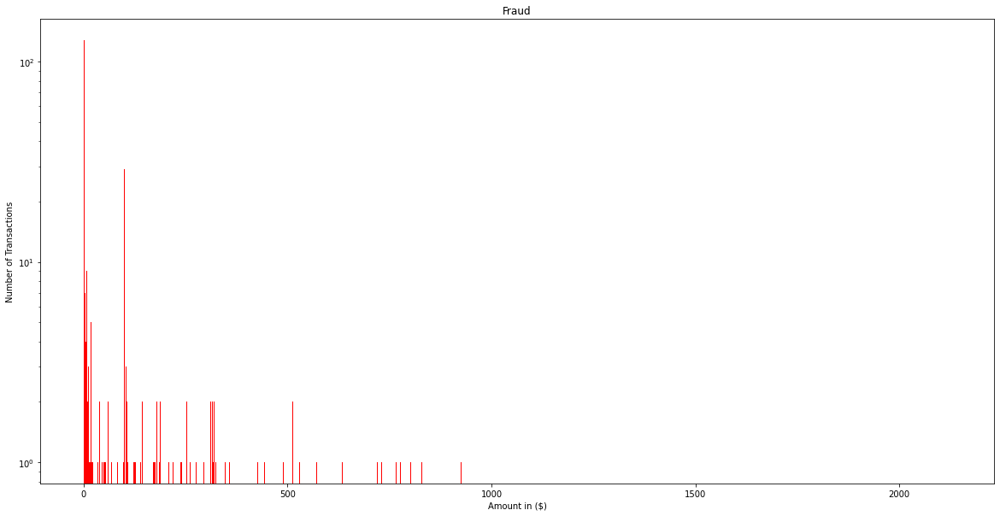

In [17]:
print('Max Flaud Value = ', max(df_origin.Amount[df_origin.Class == 1]))
BINS = int(max(df_origin.Amount)/10) # 10 dollar gap
plt.figure(figsize=(20,10))
plt.hist(df_origin.Amount[df_origin.Class == 1], bins = BINS , color = 'red') # Fraud
plt.title('Fraud')
plt.xlabel('Amount in ($)')
plt.ylabel('Number of Transactions')
#plt.xlim(0,3000) # limit x axis for further analyze
plt.yscale('log')
plt.show()

In [18]:
# Origin Statistic
df_origin.Amount[df_origin.Class == 1].describe()

count     492.000000
mean      122.211321
std       256.683288
min         0.000000
25%         1.000000
50%         9.250000
75%       105.890000
max      2125.870000
Name: Amount, dtype: float64

In [19]:
df_testSet.Amount[df_testSet.Class == 1].describe()

count      94.000000
mean      130.367979
std       264.219515
min         0.000000
25%         1.000000
50%        10.800000
75%       105.920000
max      1354.250000
Name: Amount, dtype: float64

In [20]:
df_trainSet.Amount[df_trainSet.Class == 1].describe()

count     398.000000
mean      120.284874
std       255.172860
min         0.000000
25%         1.000000
50%         9.170000
75%       105.620000
max      2125.870000
Name: Amount, dtype: float64

In [21]:
origin_std = df_origin.Amount[df_origin.Class == 1].std()
origin_mean = df_origin.Amount[df_origin.Class == 1].mean()
origin_threesigma_amount = int(origin_mean + 3*origin_std)
print('Amount Standard Deviation value  = $',origin_std)
print('Amount Mean value                = $',origin_mean)
print('3 Standard Deviation upper value = $',origin_threesigma_amount)

Amount Standard Deviation value  = $ 256.68328829771207
Amount Mean value                = $ 122.21132113821133
3 Standard Deviation upper value = $ 892


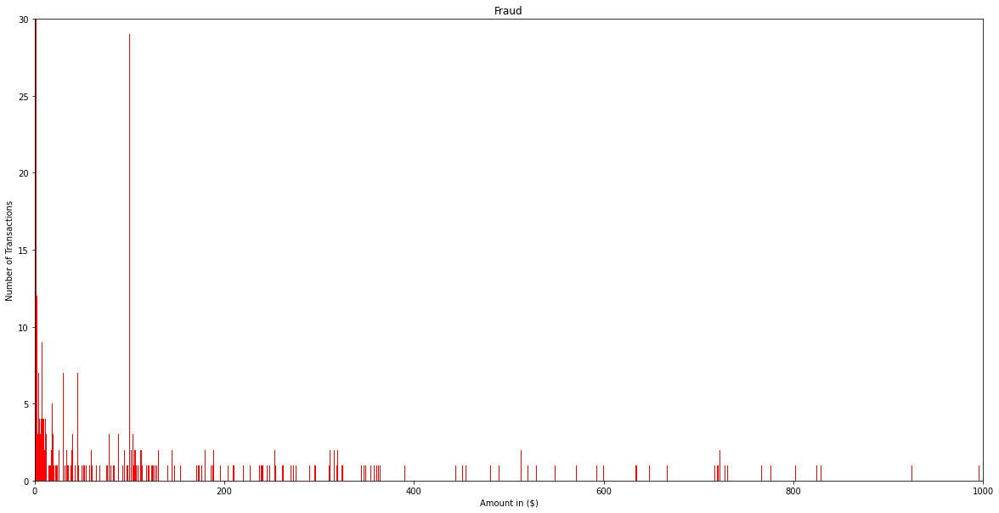

In [22]:
plt.figure(figsize=(20,10))
plt.hist(df_origin.Amount[df_origin.Class == 1], bins = BINS , color = 'red') # Fraud
plt.title('Fraud')
plt.xlabel('Amount in ($)')
plt.ylabel('Number of Transactions')
plt.xlim(0,1000) # limit x axis for further analyze
plt.ylim(0,30) # limit y axis for further analyze
plt.show()

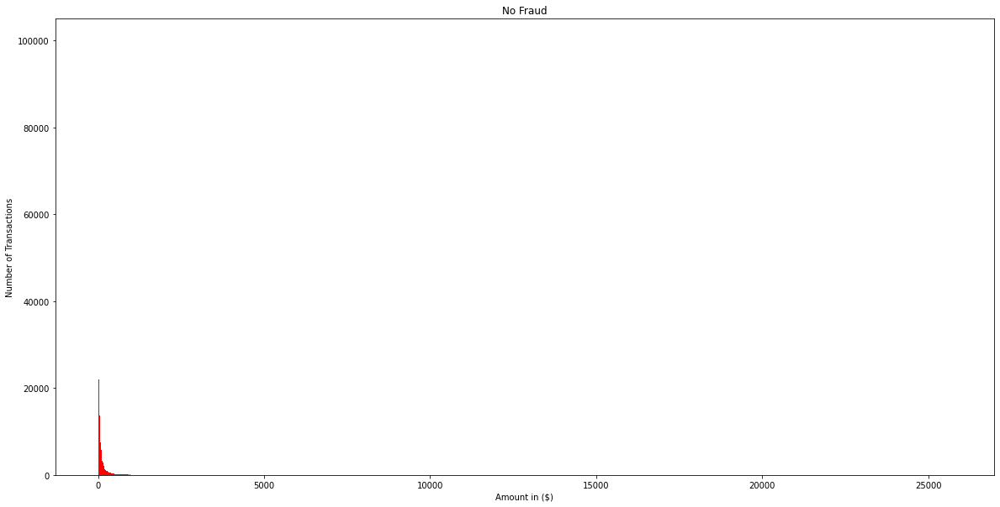

In [23]:
plt.figure(figsize=(20,10))
plt.hist(df_origin.Amount[df_origin.Class == 0], bins = BINS , color = 'red') # No Fraud
plt.title('No Fraud')
plt.xlabel('Amount in ($)')
plt.ylabel('Number of Transactions')
plt.show()

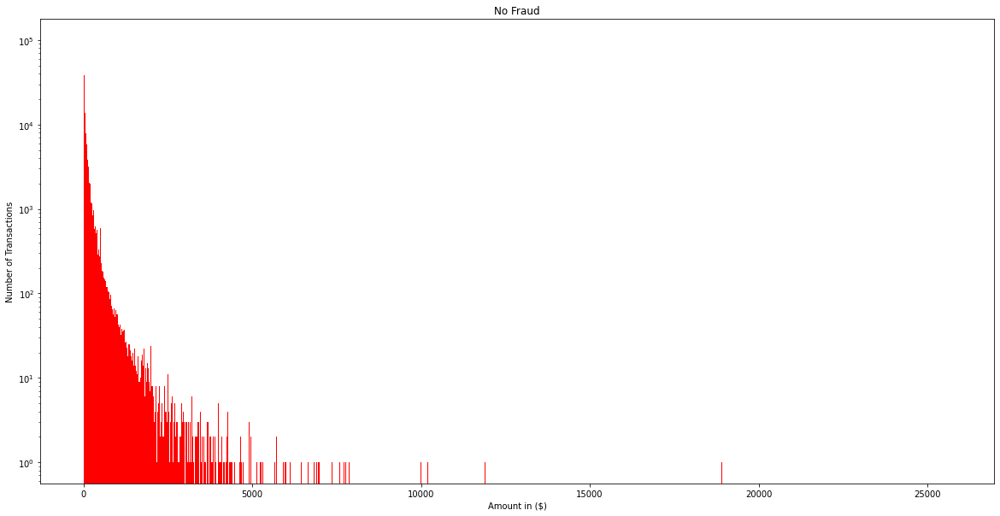

In [24]:
plt.figure(figsize=(20,10))
plt.hist(df_origin.Amount[df_origin.Class == 0], bins = BINS , color = 'red') # No Fraud
plt.title('No Fraud')
plt.xlabel('Amount in ($)')
plt.ylabel('Number of Transactions')
plt.yscale('log')
plt.show()

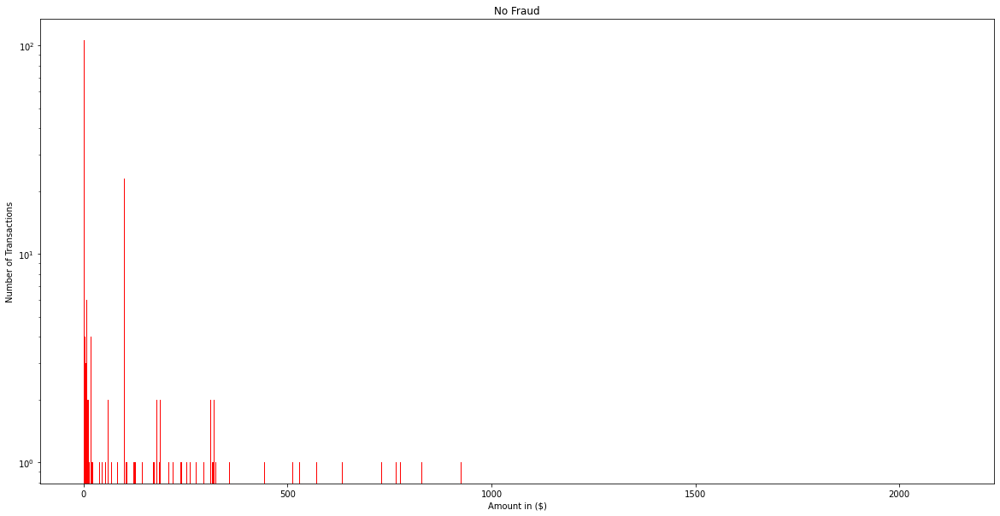

In [25]:
plt.figure(figsize=(20,10))
plt.hist(df_trainSet.Amount[df_trainSet.Class == 1], bins = BINS , color = 'red') # No Fraud
plt.title('No Fraud')
plt.xlabel('Amount in ($)')
plt.ylabel('Number of Transactions')
plt.yscale('log')
plt.show()

## **Further Preprocessing**

In [26]:
# Redefine Variables for Preprocess and Readability
XY_pre_train_unnorm  = df_trainSet
XY_pre_test_unnorm   = df_testSet                    

### Randomise Indexes

In [27]:
# Randomize indexing
'''
def data_randomizeIndexXY(X,Y):
  print('Dataset before randomize')
  print(X)
  print(X.shape)
  indexes = np.arange(X.shape[0])
  np.random.seed(SEED) # Fixed the random shuffle
  np.random.shuffle(indexes)
  X, Y = X[indexes], Y[indexes]
  print('Dataset after randomize')
  print(X)
  print(X.shape)
  return X, Y
'''
def data_randomizeIndex(dataset):
  # Convert to pandas for easier operation
  dataset = pd.DataFrame(data=dataset)
  print('Dataset before randomize')
  print(dataset)
  print(dataset.shape)
  #dataset = dataset.reset_index()# Reset Index
  #print()
  #print('After Reset Index')
  #print(dataset)
  #print(dataset.shape)
  indexes = np.arange(dataset.shape[0])
  #print(indexes)
  # Append 
  dataset = dataset.to_numpy()
  np.random.seed(SEED) # Fixed the random shuffle
  np.random.shuffle(indexes)
  
  dataset = dataset[indexes]
  dataset = pd.DataFrame(data=dataset)
  print('Dataset after randomize')
  print(dataset)
  print(dataset.shape)
  return dataset

###Normlisation

In [28]:
def normalize(X, X_min, X_max):
  return (X - X_min)/(X_max-X_min)

# Normalize Inputs to between 0 to 1
def normalize_train(X):
  print('Inputs before normalize...')
  print(X)
  X = normalize(X, np.min(X, axis=0), np.max(X, axis=0))
  print('Inputs after normalize...')
  print(X)
  return X

### Splitting

In [29]:
# Split into input and output elements respectively
def data_split_XY(dataset):
  datasetCol = dataset.shape[1]
  print('# of Dataset Column: ', datasetCol)
  data = dataset.values
  #print(data[0])
  X, Y = data[:,:datasetCol-1], data[:,datasetCol-1]
  print(X.shape, Y.shape) # Input and Output Size
  return X,Y

In [30]:
print('Splitting Train Dataset with Preprocess')
X_pre_train_unnorm ,Y_pre_train = data_split_XY(XY_pre_train_unnorm)
print('Splitting Test Dataset with Preprocess')
X_pre_test_unnorm ,Y_pre_test = data_split_XY(XY_pre_test_unnorm)

Splitting Train Dataset with Preprocess
# of Dataset Column:  20
(225168, 19) (225168,)
Splitting Test Dataset with Preprocess
# of Dataset Column:  20
(56293, 19) (56293,)


In [31]:
print('Normalise Inputs from Preprocess')
X_pre_train = normalize_train(X_pre_train_unnorm)
X_pre_test = normalize_train(X_pre_test_unnorm)

Normalise Inputs from Preprocess
Inputs before normalize...
[[-1.40132786e+00  5.21932760e-02  1.28955161e+00 ... -3.61390041e-01
  -1.04871671e-01  9.49000000e+01]
 [ 9.99909813e-01 -1.16975858e+00  4.33756800e-01 ... -4.61646467e-01
   3.89902155e-02  1.33680000e+02]
 [-7.18824209e-01  1.60423283e-01  2.40277175e+00 ...  6.41559855e-01
   1.96995482e-02  2.36500000e+01]
 ...
 [-3.72047086e-01  1.09656169e+00  1.83801105e+00 ... -1.48395334e-02
   1.03963342e-01  9.99000000e+00]
 [-3.28076004e+00 -3.16834186e+00  2.14198914e+00 ... -2.95638806e-03
  -1.95349412e-01  7.11000000e+01]
 [-1.05852050e+00  3.85887286e-02  1.03681931e+00 ...  3.89448032e-01
   8.02454752e-02  5.14900000e+01]]
Inputs after normalize...
[[0.88640435 0.43237484 0.91787656 ... 0.36084838 0.63459624 0.03592153]
 [0.95941946 0.40085502 0.89362724 ... 0.34623266 0.64578969 0.05060052]
 [0.90715743 0.4351666  0.94942014 ... 0.5070618  0.64428874 0.00895199]
 ...
 [0.91770198 0.45931396 0.9334174  ... 0.41136968 0.65

In [32]:
# Split origin dataset into train and test set 80:20 ratio 
def data_split_traintest(X,Y):
  x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=TESTRATIO, random_state = SEED) 
  # randomize_state consider randomize the index as well so no randomize index needed
  print('Train X Size: ' + str(x_train.shape))
  print('Train Y Size: ' + str(y_train.shape))
  print('Test X Size: ' + str(x_test.shape))
  print('Test Y Size: ' + str(y_test.shape))
  return x_train, x_test, y_train, y_test

###Merging

In [33]:
def data_merging_XY(dataset_X, dataset_Y): #Y is append on the last column (Assume 1 col)
  print('Before Merged X')
  print(dataset_X)
  print(dataset_X.shape)
  print()
  col_Size = dataset_X.shape[1]
  row_Size = dataset_X.shape[0]
  dataset = np.zeros((row_Size,col_Size+1))
  print(dataset.shape)
  dataset[:,:-1] = dataset_X
  #dataset[:,col_Size-2] = dataset_X[:,col_Size-1]
  dataset[:,col_Size] = dataset_Y
  print('Merged Dataset:')
  print(dataset)
  print(dataset.shape)
  return dataset

### Sampling

In [34]:
# Combine Trainset
print('Merging Preprocess Train Datasets')
XY_pre_train = data_merging_XY(X_pre_train,Y_pre_train)

Merging Preprocess Train Datasets
Before Merged X
[[0.88640435 0.43237484 0.91787656 ... 0.36084838 0.63459624 0.03592153]
 [0.95941946 0.40085502 0.89362724 ... 0.34623266 0.64578969 0.05060052]
 [0.90715743 0.4351666  0.94942014 ... 0.5070618  0.64428874 0.00895199]
 ...
 [0.91770198 0.45931396 0.9334174  ... 0.41136968 0.65084505 0.00378141]
 [0.82925592 0.34930225 0.94203075 ... 0.41310205 0.62755644 0.02691275]
 [0.89682819 0.43202392 0.91071528 ... 0.47030809 0.64899963 0.01948998]]
(225168, 19)

(225168, 20)
Merged Dataset:
[[0.88640435 0.43237484 0.91787656 ... 0.63459624 0.03592153 0.        ]
 [0.95941946 0.40085502 0.89362724 ... 0.64578969 0.05060052 0.        ]
 [0.90715743 0.4351666  0.94942014 ... 0.64428874 0.00895199 0.        ]
 ...
 [0.91770198 0.45931396 0.9334174  ... 0.65084505 0.00378141 0.        ]
 [0.82925592 0.34930225 0.94203075 ... 0.62755644 0.02691275 0.        ]
 [0.89682819 0.43202392 0.91071528 ... 0.64899963 0.01948998 0.        ]]
(225168, 20)


##### Up

In [35]:
def upSample(dataset):
  # Convert to pandas for easier operation
  datasetf = pd.DataFrame(data=dataset)
  
  # Resample to match non fraud class
  dataset_0 = datasetf[datasetf[datasetf.shape[1]-1]==0]
  dataset_1 = datasetf[datasetf[datasetf.shape[1]-1]==1]
  #dataset_1           = data_randomizeIndex(dataset_1_nonrandom):
  # Upsample minority class
  dataset_1_upsampled = resample(dataset_1, 
                                  replace=True,             # sample with replacement
                                  n_samples=math.floor(len(dataset_0)/RATIO), # to match majority class
                                  random_state=SEED)        # reproducible results

  # Combine majority class with upsampled minority class
  datasetUp = pd.concat([dataset_0, dataset_1_upsampled])

  # Display new class counts
  fraud    = datasetUp[datasetUp[datasetUp.shape[1]-1]==0]
  nonfraud = datasetUp[datasetUp[datasetUp.shape[1]-1]==1]
  print('After Up Sample Number of Non Fraud = ', len(nonfraud))
  print(nonfraud)
  print()
  print('After Up Sample Number of Fraud     = ', len(fraud))
  print(fraud)
  return datasetUp

In [36]:
print('Upscale Sample with fraud')
print('Preprocess Dataset')
XY_pre_trainUp_nonrand = upSample(XY_pre_train)
print()
print('Randomize Index')
XY_pre_trainUp = data_randomizeIndex(XY_pre_trainUp_nonrand)
print()
print('Splitting for Model')
print('Preprocess Dataset')
X_pre_trainUp, Y_pre_trainUp = data_split_XY(XY_pre_trainUp)

Upscale Sample with fraud
Preprocess Dataset
After Up Sample Number of Non Fraud =  44954
              0         1         2   ...        17        18   19
88921   0.943299  0.399106  0.831258  ...  0.633586  0.273749  1.0
23035   0.854844  0.497874  0.800860  ...  0.621853  0.047429  1.0
59337   0.906687  0.442263  0.866294  ...  0.638223  0.011337  1.0
98994   0.886560  0.498574  0.710282  ...  0.647631  0.000379  1.0
180933  0.907261  0.446727  0.914078  ...  0.637904  0.048829  1.0
...          ...       ...       ...  ...       ...       ...  ...
214317  0.914744  0.459698  0.939169  ...  0.634910  0.001488  1.0
39374   0.915842  0.493668  0.768095  ...  0.727918  0.000379  1.0
9071    0.951952  0.492415  0.735770  ...  0.666464  0.000757  1.0
153145  0.822617  0.437698  0.754123  ...  0.797274  0.685000  1.0
43259   0.935169  0.461370  0.891151  ...  0.620987  0.002873  1.0

[44954 rows x 20 columns]

After Up Sample Number of Fraud     =  224770
              0         1       

It is already in Numpy Format
Non-Fraud Count has  99.82 %
Fraud Count has  0.18 %


/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


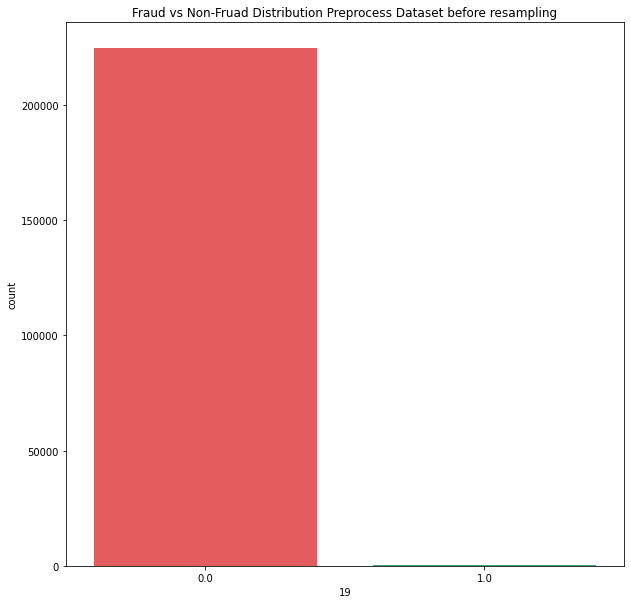

Non-Fraud Count has  83.33 %
Fraud Count has  16.67 %


/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


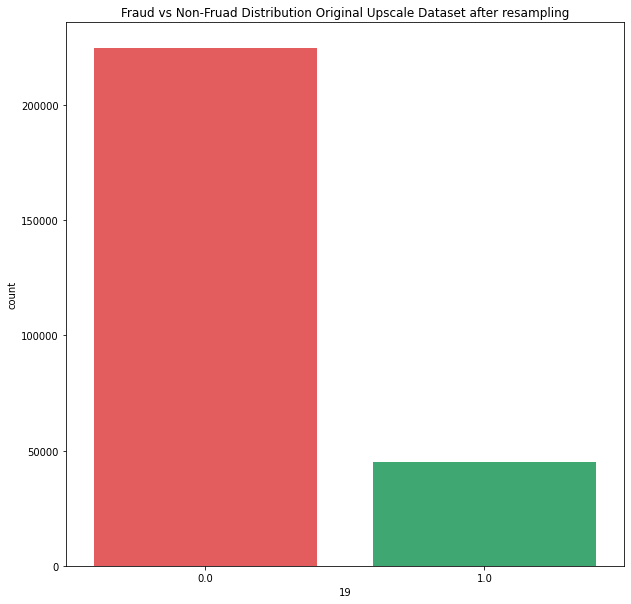

In [37]:
# Upsampling Visualization
try:
  XY_pre_train = XY_pre_train.to_numpy()
except:
  print('It is already in Numpy Format')
Count_0 = XY_pre_train[XY_pre_train[:,XY_pre_train.shape[1]-1] == 0].shape[0]
Count_1 = XY_pre_train[XY_pre_train[:,XY_pre_train.shape[1]-1] == 1].shape[0]
Count_Total = XY_pre_train.shape[0]
print('Non-Fraud Count has ', round((Count_0/Count_Total)*100,2),'%')
print('Fraud Count has ', round((Count_1/Count_Total)*100,2),'%')
plt.figure(figsize=(10,10))
plt.title('Fraud vs Non-Fruad Distribution Preprocess Dataset before resampling')
colors = ['#FA4649','#2EB872']
XY_pre_train = pd.DataFrame(data=XY_pre_train)
sns.countplot(XY_pre_train.shape[1]-1,data = XY_pre_train,palette = colors)
plt.show()

try:
  XY_pre_trainUp = XY_pre_trainUp.to_numpy()
except:
  print('It is already in Numpy Format')
Count_0 = XY_pre_trainUp[XY_pre_trainUp[:,XY_pre_trainUp.shape[1]-1] == 0].shape[0]
Count_1 = XY_pre_trainUp[XY_pre_trainUp[:,XY_pre_trainUp.shape[1]-1] == 1].shape[0]
Count_Total = XY_pre_trainUp.shape[0]
print('Non-Fraud Count has ', round((Count_0/Count_Total)*100,2),'%')
print('Fraud Count has ', round((Count_1/Count_Total)*100,2),'%')
plt.figure(figsize=(10,10))
plt.title('Fraud vs Non-Fruad Distribution Original Upscale Dataset after resampling')
colors = ['#FA4649','#2EB872']
XY_pre_trainUp = pd.DataFrame(data=XY_pre_trainUp)
sns.countplot(XY_pre_trainUp.shape[1]-1,data = XY_pre_trainUp,palette = colors)
plt.show()

##### Down

In [38]:
def downSample(dataset):
  # Convert to pandas for easier operation
  datasetf = pd.DataFrame(data=dataset)
  
  # Resample to match non fraud class
  dataset_0 = datasetf[datasetf[datasetf.shape[1]-1]==0]
  dataset_1 = datasetf[datasetf[datasetf.shape[1]-1]==1]
  print('Non-Fraud =', len(dataset_0))
  print('Fraud     =', len(dataset_1))
  #dataset_1           = data_randomizeIndex(dataset_1_nonrandom):
  # Downsample majority class
  dataset_0_downsampled = resample(dataset_0, 
                                  replace=True,             # sample with replacement
                                  n_samples=math.floor(len(dataset_1)/RATIO), # to match minority class
                                  random_state=SEED)        # reproducible results

  # Combine minority class with downsampled majority class
  datasetDown = pd.concat([dataset_1, dataset_0_downsampled])

  # Display new class counts
  fraud    = datasetDown[datasetDown[datasetDown.shape[1]-1]==0]
  nonfraud = datasetDown[datasetDown[datasetDown.shape[1]-1]==1]
  print('After Down Sample Number of Non Fraud = ', len(nonfraud))
  print(nonfraud)
  print()
  print('After Down Sample Number of Fraud     = ', len(fraud))
  print(fraud)
  return datasetDown

In [39]:
print('Downscale Sample with non-fraud')
print('Preprocess Dataset')
XY_pre_trainDown_nonrand = downSample(XY_pre_train)
print()
print('Randomize Index')
XY_pre_trainDown = data_randomizeIndex(XY_pre_trainDown_nonrand)
print()
print('Splitting for Model')
print('Preprocess Dataset')
X_pre_trainDown, Y_pre_trainDown = data_split_XY(XY_pre_trainDown)

Downscale Sample with non-fraud
Preprocess Dataset
Non-Fraud = 224770
Fraud     = 398
After Down Sample Number of Non Fraud =  398
              0         1         2   ...        17        18   19
5       0.938928  0.464217  0.824462  ...  0.687923  0.002373  1.0
146     0.821003  0.571002  0.775594  ...  0.644547  0.012714  1.0
213     0.697101  0.251074  0.822458  ...  0.706665  0.007184  1.0
338     0.870406  0.478171  0.682436  ...  0.742170  0.193897  1.0
348     0.222413  0.778931  0.167602  ...  0.758006  0.037848  1.0
...          ...       ...       ...  ...       ...       ...  ...
220362  0.242975  0.771748  0.183043  ...  0.759811  0.037848  1.0
220649  0.742497  0.506903  0.722829  ...  0.511715  0.111625  1.0
222942  0.902840  0.511812  0.738158  ...  0.749608  0.007199  1.0
223367  0.916249  0.401210  0.822044  ...  0.641094  0.170815  1.0
223525  0.961840  0.453547  0.872727  ...  0.644229  0.000000  1.0

[398 rows x 20 columns]

After Down Sample Number of Fraud     =

Non-Fraud Count has  99.82 %
Fraud Count has  0.18 %


/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


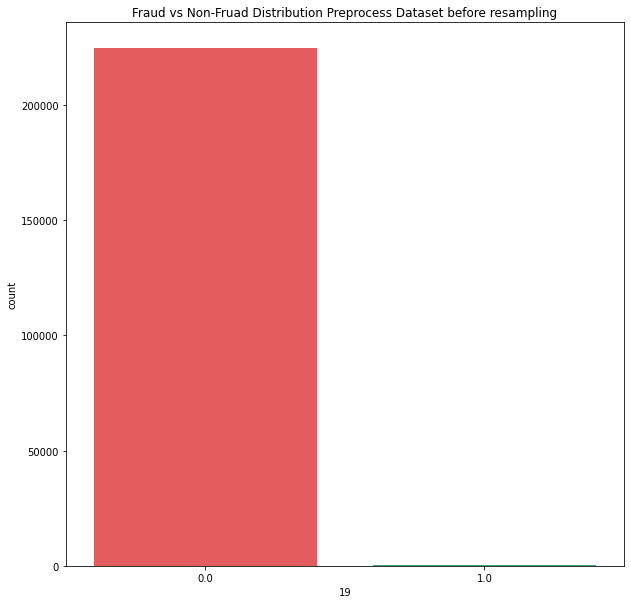

Non-Fraud Count has  16.56 %
Fraud Count has  83.44 %


/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


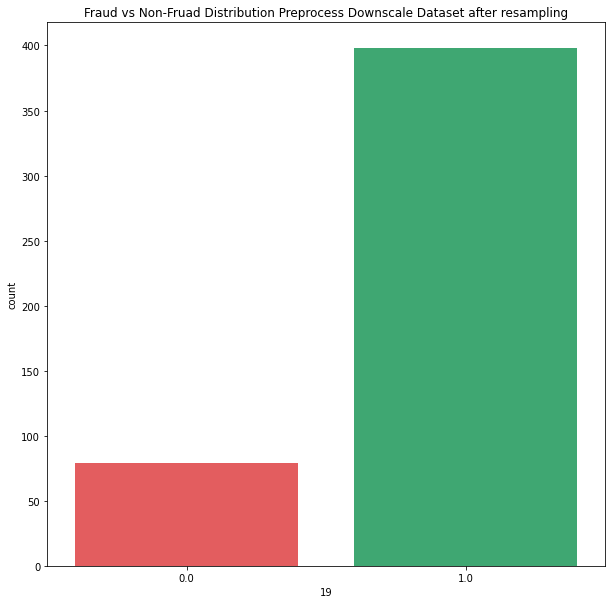

In [40]:
# Downsampling Visualization
try:
  XY_pre_train = XY_pre_train.to_numpy()
except:
  print('It is already in Numpy Format')
Count_0 = XY_pre_train[XY_pre_train[:,XY_pre_train.shape[1]-1] == 0].shape[0]
Count_1 = XY_pre_train[XY_pre_train[:,XY_pre_train.shape[1]-1] == 1].shape[0]
Count_Total = XY_pre_train.shape[0]
print('Non-Fraud Count has ', round((Count_0/Count_Total)*100,2),'%')
print('Fraud Count has ', round((Count_1/Count_Total)*100,2),'%')
plt.figure(figsize=(10,10))
plt.title('Fraud vs Non-Fruad Distribution Preprocess Dataset before resampling')
colors = ['#FA4649','#2EB872']
XY_pre_train = pd.DataFrame(data=XY_pre_train)
sns.countplot(XY_pre_train.shape[1]-1,data = XY_pre_train,palette = colors)
plt.show()

try:
  XY_pre_trainDown = XY_pre_trainDown.to_numpy()
except:
  print('It is already in Numpy Format')
Count_0 = XY_pre_trainDown[XY_pre_trainDown[:,XY_pre_trainDown.shape[1]-1] == 0].shape[0]
Count_1 = XY_pre_trainDown[XY_pre_trainDown[:,XY_pre_trainDown.shape[1]-1] == 1].shape[0]
Count_Total = XY_pre_trainDown.shape[0]
print('Non-Fraud Count has ', round((Count_0/Count_Total)*100,2),'%')
print('Fraud Count has ', round((Count_1/Count_Total)*100,2),'%')
plt.figure(figsize=(10,10))
plt.title('Fraud vs Non-Fruad Distribution Preprocess Downscale Dataset after resampling')
colors = ['#FA4649','#2EB872']
XY_pre_trainDown = pd.DataFrame(data=XY_pre_trainDown)
sns.countplot(XY_pre_trainDown.shape[1]-1,data = XY_pre_trainDown,palette = colors)
plt.show()

##### SMOTE

In [41]:
over = SMOTE(sampling_strategy=1/RATIO, random_state=0)
steps = [('o',over)]
pipeline = Pipeline(steps=steps)
XY_pre_train = pd.DataFrame(data=XY_pre_train)
X_pre_train, Y_pre_train = data_split_XY(XY_pre_train)
X_pre_trainSMT_nonrand, Y_pre_trainSMT_nonrand = pipeline.fit_resample(X_pre_train, Y_pre_train)
XY_pre_trainSMT_nonrand = data_merging_XY(X_pre_trainSMT_nonrand,Y_pre_trainSMT_nonrand) #Y is append on the last column (Assume 1 col)
XY_pre_trainSMT = data_randomizeIndex(XY_pre_trainSMT_nonrand)
X_pre_trainSMT, Y_pre_trainSMT = data_split_XY(XY_pre_trainSMT)

print('X')
print(X_pre_trainSMT)
print('Y')
print(Y_pre_trainSMT)

# of Dataset Column:  20
(225168, 19) (225168,)


/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


Before Merged X
[[0.88640435 0.43237484 0.91787656 ... 0.36084838 0.63459624 0.03592153]
 [0.95941946 0.40085502 0.89362724 ... 0.34623266 0.64578969 0.05060052]
 [0.90715743 0.4351666  0.94942014 ... 0.5070618  0.64428874 0.00895199]
 ...
 [0.88745174 0.49621288 0.71840808 ... 0.36477913 0.68478805 0.01227693]
 [0.81895899 0.47503158 0.68407074 ... 0.34281698 0.79609599 0.22872723]
 [0.71524234 0.5192976  0.61143946 ... 0.36170428 0.74853572 0.        ]]
(269724, 19)

(269724, 20)
Merged Dataset:
[[0.88640435 0.43237484 0.91787656 ... 0.63459624 0.03592153 0.        ]
 [0.95941946 0.40085502 0.89362724 ... 0.64578969 0.05060052 0.        ]
 [0.90715743 0.4351666  0.94942014 ... 0.64428874 0.00895199 0.        ]
 ...
 [0.88745174 0.49621288 0.71840808 ... 0.68478805 0.01227693 1.        ]
 [0.81895899 0.47503158 0.68407074 ... 0.79609599 0.22872723 1.        ]
 [0.71524234 0.5192976  0.61143946 ... 0.74853572 0.         1.        ]]
(269724, 20)
Dataset before randomize
              0

Non-Fraud Count has  99.82 %
Fraud Count has  0.18 %


/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


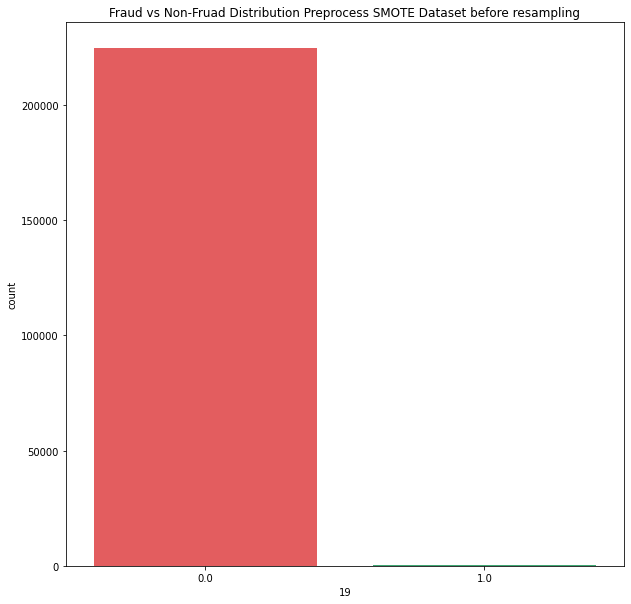

Non-Fraud Count has  83.33 %
Fraud Count has  16.67 %


/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


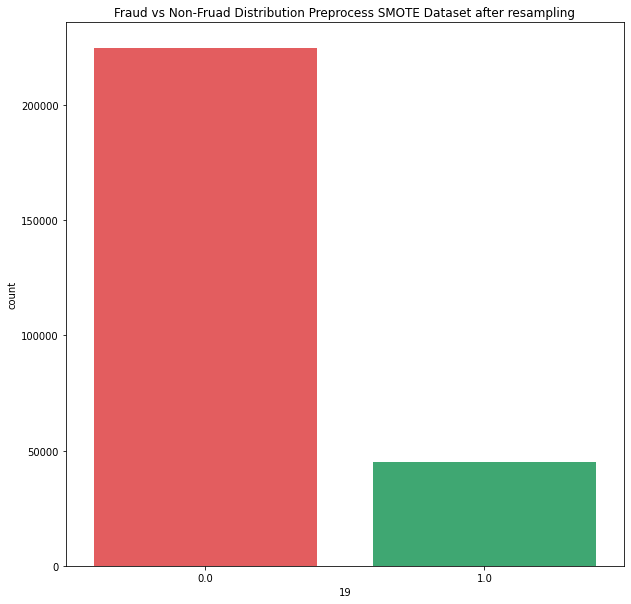

In [42]:
# SMOTE Visualization
try:
  XY_pre_train = XY_pre_train.to_numpy()
except:
  print('It is already in Numpy Format')
Count_0 = XY_pre_train[XY_pre_train[:,XY_pre_train.shape[1]-1] == 0].shape[0]
Count_1 = XY_pre_train[XY_pre_train[:,XY_pre_train.shape[1]-1] == 1].shape[0]
Count_Total = XY_pre_train.shape[0]
print('Non-Fraud Count has ', round((Count_0/Count_Total)*100,2),'%')
print('Fraud Count has ', round((Count_1/Count_Total)*100,2),'%')
plt.figure(figsize=(10,10))
plt.title('Fraud vs Non-Fruad Distribution Preprocess SMOTE Dataset before resampling')
colors = ['#FA4649','#2EB872']
XY_pre_train = pd.DataFrame(data=XY_pre_train)
sns.countplot(XY_pre_train.shape[1]-1,data = XY_pre_train,palette = colors)
plt.show()

try:
  XY_pre_trainSMT = XY_pre_trainSMT.to_numpy()
except:
  print('It is already in Numpy Format')
Count_0 = XY_pre_trainSMT[XY_pre_trainSMT[:,XY_pre_trainSMT.shape[1]-1] == 0].shape[0]
Count_1 = XY_pre_trainSMT[XY_pre_trainSMT[:,XY_pre_trainSMT.shape[1]-1] == 1].shape[0]
Count_Total = XY_pre_trainSMT.shape[0]
print('Non-Fraud Count has ', round((Count_0/Count_Total)*100,2),'%')
print('Fraud Count has ', round((Count_1/Count_Total)*100,2),'%')
plt.figure(figsize=(10,10))
plt.title('Fraud vs Non-Fruad Distribution Preprocess SMOTE Dataset after resampling')
colors = ['#FA4649','#2EB872']
XY_pre_trainSMT = pd.DataFrame(data=XY_pre_trainSMT)
sns.countplot(XY_pre_trainSMT.shape[1]-1,data = XY_pre_trainSMT,palette = colors)
plt.show()

###K-Fold

In [43]:
# Find number of dataset per fold
def data_fold(x_train):
  data_num = len(x_train)
  data_num_per_fold = data_num//FOLDS 
  print('Number of train dataset per fold: ' + str(data_num_per_fold) + '\n')
  return data_num_per_fold

In [44]:
# Randomize indexing for k-fold operation
def data_randomizeIndex(X,Y):
  print('Dataset before randomize')
  print(X)
  print(X.shape)
  indexes = np.arange(X.shape[0])
  np.random.seed(SEED) # Fixed the random shuffle
  np.random.shuffle(indexes)
  X, Y = X[indexes], Y[indexes]
  print('Dataset after randomize')
  print(X)
  print(X.shape)
  return X, Y

In [45]:
# Apply cross validation on train dataset
def get_data_folds(x_train,y_train,data_num_per_fold):
  data_folds = []
  count = 1
  for fold in range(FOLDS):
    start, end = fold*data_num_per_fold, (fold+1)*data_num_per_fold
    print('Start at Index:' + str(start) + ' || End at Index: ' + str(end))
    xf_test, yf_test = x_train[start:end], y_train[start:end]
    xf_train  = np.append(x_train[:start], x_train[end:], axis=0)
    yf_train = np.append(y_train[:start], y_train[end:], axis=0) 
    
    print('Test Dataset per fold num ' + str(count))
    print(xf_test.shape)
    print(yf_test.shape)
    print(xf_train.shape)
    print(yf_train.shape)
    print()
    count += 1
    data_folds.append([xf_train,yf_train,xf_test,yf_test])
  return data_folds

In [46]:
print('Apply K-Fold')
print('Preprocess Dataset')
data_num_per_fold_pre = data_fold(X_pre_train)
splitdataset_pre = get_data_folds(X_pre_train,Y_pre_train,data_num_per_fold_pre)
print('-------------------------------------------------------------')
print('Preprocess SMOTE Dataset')
data_num_per_fold_smt = data_fold(X_pre_trainSMT)
splitdataset_pre_smt = get_data_folds(X_pre_trainSMT,Y_pre_trainSMT,data_num_per_fold_smt)


Apply K-Fold
Preprocess Dataset
Number of train dataset per fold: 45033

Start at Index:0 || End at Index: 45033
Test Dataset per fold num 1
(45033, 19)
(45033,)
(180135, 19)
(180135,)

Start at Index:45033 || End at Index: 90066
Test Dataset per fold num 2
(45033, 19)
(45033,)
(180135, 19)
(180135,)

Start at Index:90066 || End at Index: 135099
Test Dataset per fold num 3
(45033, 19)
(45033,)
(180135, 19)
(180135,)

Start at Index:135099 || End at Index: 180132
Test Dataset per fold num 4
(45033, 19)
(45033,)
(180135, 19)
(180135,)

Start at Index:180132 || End at Index: 225165
Test Dataset per fold num 5
(45033, 19)
(45033,)
(180135, 19)
(180135,)

-------------------------------------------------------------
Preprocess SMOTE Dataset
Number of train dataset per fold: 53944

Start at Index:0 || End at Index: 53944
Test Dataset per fold num 1
(53944, 19)
(53944,)
(215780, 19)
(215780,)

Start at Index:53944 || End at Index: 107888
Test Dataset per fold num 2
(53944, 19)
(53944,)
(21578

##**Dataset Analysis with Further Preprocess**

In [47]:
# All Various Train and Test Variables
# Preprocess- X_pre_train, X_pre_test, Y_pre_train, Y_pre_test
# Preprocess UpScale   - X_pre_trainUp, X_pre_test, Y_pre_trainUp, Y_pre_test
# Preprocess DownScale - X_pre_trainDown, X_pre_test, Y_pre_trainDown, Y_pre_test
# Preprocess SMOTE     - X_pre_trainSMT, X_pre_test, Y_pre_trainSMT, Y_pre_test

# Check for classification distribution in each train and set to ensure splitting uniformly
print('Preprocess Train and Test Set Classification Distribution')
print('<Trainset>')
print('Non-Fraud: ',len(Y_pre_train[Y_pre_train == 0]))
print('Fraud    : ',len(Y_pre_train[Y_pre_train == 1]))
print()
print('<Testset>')
print('Non-Fraud: ',len(Y_pre_test[Y_pre_test == 0]))
print('Fraud    : ',len(Y_pre_test[Y_pre_test == 1]))
print('\n')

print('Preprocess SMOTE Train and Test Set Classification Distribution')
index = 0
for dataset in splitdataset_pre_smt:
  X_train,Y_train,X_test,Y_test  = dataset
  print('[ Fold', index+1,']')
  print('<Trainset>')
  print('Non-Fraud: ',len(Y_train[Y_train == 0]))
  print('Fraud    : ',len(Y_train[Y_train == 1]))
  print()
  print('<Testset>')
  print('Non-Fraud: ',len(Y_test[Y_test == 0]))
  print('Fraud    : ',len(Y_test[Y_test == 1]))
  print('\n')
  index += 1

Preprocess Train and Test Set Classification Distribution
<Trainset>
Non-Fraud:  224770
Fraud    :  398

<Testset>
Non-Fraud:  56199
Fraud    :  94


Preprocess SMOTE Train and Test Set Classification Distribution
[ Fold 1 ]
<Trainset>
Non-Fraud:  179854
Fraud    :  35926

<Testset>
Non-Fraud:  44916
Fraud    :  9028


[ Fold 2 ]
<Trainset>
Non-Fraud:  179665
Fraud    :  36115

<Testset>
Non-Fraud:  45105
Fraud    :  8839


[ Fold 3 ]
<Trainset>
Non-Fraud:  179910
Fraud    :  35870

<Testset>
Non-Fraud:  44860
Fraud    :  9084


[ Fold 4 ]
<Trainset>
Non-Fraud:  179772
Fraud    :  36008

<Testset>
Non-Fraud:  44998
Fraud    :  8946


[ Fold 5 ]
<Trainset>
Non-Fraud:  179883
Fraud    :  35897

<Testset>
Non-Fraud:  44887
Fraud    :  9057




##**Model**

In [48]:
def decay_scheduleDecay1(epoch, lr):
    # decay by 0.1 every 5 epochs; use `% 1` to decay after each epoch
    if (epoch % 5 == 0) and (epoch != 0):
        lr = lr * 1e-3
    return lr

In [49]:
def decay_scheduleDecay2(epoch, lr):
    # decay by 0.1 every 5 epochs; use `% 1` to decay after each epoch
    if (epoch % 5 == 0) and (epoch != 0):
        lr = lr * 1e-6
    return lr

In [50]:
def decay_scheduleDecay3(epoch, lr):
    # decay by 0.1 every 5 epochs; use `% 1` to decay after each epoch
    if (epoch % 5 == 0) and (epoch != 0):
        lr = lr * 1e-9
    return lr

In [51]:
def decay_scheduleDecay4(epoch, lr):
    # decay by 0.1 every 5 epochs; use `% 1` to decay after each epoch
    if (epoch % 5 == 0) and (epoch != 0):
        lr = lr * 1e-12
    return lr

In [52]:
# Clear training outputs
class ClearTrainingOutput(Callback):
  def on_train_end(*args, **kwargs):
    IPython.display.clear_output(wait = True)

In [53]:
# Compute Time for Epochs
class TimeHistory(Callback):
    def on_train_begin(self, logs={}):
        self.times = []

    def on_epoch_begin(self, batch, logs={}):
        self.epoch_time_start = time.time()

    def on_epoch_end(self, batch, logs={}):
        self.times.append(time.time() - self.epoch_time_start)

In [54]:
# Define Model
def model_build(num_neurons,num_layer,dropout):
  if(num_layer <= 0):
    return print('Minimun Layer is 1')
  print('Building Model...')
  # Create the model
  model = Sequential()
  for i in range(num_layer): 
        model.add(Dense(num_neurons, activation='relu', name = 'Relu_Layer' + str(i+1)))
        model.add(Dropout(dropout,seed = SEED))
  model.add(Dense(units = 1, activation='sigmoid', name='Predictions')) # Must use 1 as this is a binary classification
  
  # Compile Model
  model.compile(optimizer='adam',
                loss='binary_crossentropy',
                metrics=['accuracy'])
  return model

In [55]:
# Model for Hyperband Training
def model_buildHB(hp):
  model = Sequential()
  # All hyperparameter consideration
  hp_neurons1 = hp.Choice('units1', values = NEURONS) 
  #hp_neurons2 = hp.Choice('units2', values = NEURONS) 
  #hp_neurons3 = hp.Choice('units3', values = NEURONS) 
  #hp_neurons4 = hp.Choice('units4', values = NEURONS) 
  #hp_neurons5 = hp.Choice('units5', values = NEURONS) 
  hp_learning_rate = hp.Choice('learning_rate', values = LEARNRATE) 
  hp_dropout_rate = hp.Choice('rate', values = DROPOUTS) 

  for i in range(hp.Int('num_layers', min(LAYERS), max(LAYERS)-4)):
    if(i >= 0):
      model.add(Dense(units = hp_neurons1, activation = 'relu'))
    '''
    elif(i >= 1):
      model.add(Dense(units = hp_neurons2, activation = 'relu'))
    elif(i >= 2):
      model.add(Dense(units = hp_neurons3, activation = 'relu'))
    elif(i >= 3):
      model.add(Dense(units = hp_neurons4, activation = 'relu'))
    elif(i >= 4):
      model.add(Dense(units = hp_neurons5, activation = 'relu'))
    '''
    model.add(Dropout(rate = hp_dropout_rate, seed = SEED))
    model.add(Dense(1, activation='sigmoid'))

  model.compile(optimizer = Adam(learning_rate = hp_learning_rate),loss = 'binary_crossentropy', metrics = ['accuracy'])
  return model

In [56]:
# Redefine Model for Optimal Hyperparameter
def model_buildOPT(NUM_NEURONS,num_layer,dropout,learningrate):
  if(num_layer <= 0):
    return print('Minimun Layer is 1')
  print('Building Model...')
  # Create the model
  model = Sequential()
  index = 0
  for i in range(num_layer): 
        try:
          model.add(Dense(NUM_NEURONS, activation='relu'))
        except:
          print('Added', index)
          model.add(Dense(NUM_NEURONS[index], activation='relu'))
          
        model.add(Dropout(dropout,seed = SEED))
        index += 1
  model.add(Dense(units = 1, activation='sigmoid')) # Must use 1 as this is a binary classification
  # Compile Model
  model.compile(optimizer = Adam(learning_rate = learningrate),
                loss='binary_crossentropy',
                metrics=['accuracy'])
  return model

In [57]:
# Train Model
def model_train(model,x_train,y_train,x_test,y_test,decay,batch_size,checkpoints,verbose):
  logdir = os.path.join("logs", path_tensorboard + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  tensorboard = TensorBoard(logdir, histogram_freq=1,batch_size=batch_size)
  model_checkpoint = ModelCheckpoint(filepath=checkpoints,save_weights_only=True,monitor='accuracy',mode='max',save_best_only=True)
  callback = EarlyStopping(monitor='val_accuracy', patience=EARLYSTOPPER)
  # This callback will stop the training when there is no improvement in the validation loss for consecutive epochs.
  time_callback = TimeHistory()
  if(decay == 0):
    result = model.fit(x_train, y_train, epochs=EPOCHSLIMIT, batch_size=batch_size,verbose =verbose ,callbacks = 
                       [tensorboard,time_callback, callback,model_checkpoint],validation_data=(x_test,y_test))
  elif(decay != 0):
    if(decay == 1e-3):
      lr_scheduler = LearningRateScheduler(decay_scheduleDecay1)
    elif(decay == 1e-6):
      lr_scheduler = LearningRateScheduler(decay_scheduleDecay2)
    elif(decay == 1e-9):
      lr_scheduler = LearningRateScheduler(decay_scheduleDecay3)
    elif(decay == 1e-12):
      lr_scheduler = LearningRateScheduler(decay_scheduleDecay4)
    result = model.fit(x_train, y_train, epochs=EPOCHSLIMIT, batch_size=batch_size,verbose = verbose,callbacks = 
                       [time_callback, callback, lr_scheduler,model_checkpoint,tensorboard],validation_data=(x_test,y_test))
  epoch_run = len(result.history['accuracy'])  
  times_epoch = time_callback.times
  time_ave = round((sum(times_epoch)/epoch_run)*pow(10,3))
  time_total = sum(times_epoch)
  print('Total Time Taken: ' + str(round(time_total,2)) + 's')
  print('Average Time Taken per epoch: ' + str(time_ave) + 'ms')
  print('Total epoch: ' + str(epoch_run))
  print('Completed Trained Model')
  
  return result

  # To Load Model 
  #model.load_weights(checkpoint_filepath)

In [58]:
def model_run_default(x_train, y_train, x_test, y_test, all_model, all_result, cur_model, cur_result, checkpoints, id):
  print('----------------------')
  print('<Hyperparameter Used>') 
  print('Number of Neurons = ', NEURONS_DEFAULT) 
  print('Number of Layer   = ', LAYERS_DEFAULT)
  print('Decay Value       = ', WEIGHTDECAY_DEFAULT) 
  print('Batch Size        = ', BATCHSIZE_DEFAULT) 
  print('Dropout           = ', DROPOUTS_DEFAULT) 
  print('----------------------')
  model = model_build(NEURONS_DEFAULT,LAYERS_DEFAULT,DROPOUTS_DEFAULT)
  result = model_train(model,x_train, y_train,x_test, y_test, WEIGHTDECAY_DEFAULT,BATCHSIZE_DEFAULT,checkpoints,VERBOSE)
  cur_model.append([model,id,'Default'])
  cur_result.append([result,id,'Default'])
  all_model.append([model,id,'Default'])
  all_result.append([result,id,'Default'])
  model_summary(model)

In [59]:
def model_run_optHB(x_train, y_train, x_test, y_test, all_model, all_result,cur_model, cur_result,checkpoints, id,optimal):
  optimal_batchsize,optimal_neurons ,optimal_layer,optimal_decay,optimal_dropout, optimal_learnrate = optimal
  batch_size = optimal_batchsize 
  num_neurons = optimal_neurons 
  num_layer = optimal_layer 
  decay = optimal_decay 
  dropout = optimal_dropout 
  learnrate = optimal_learnrate
  print('------------------------------')
  print('<Optimal Hyperparameter Used>') 
  print('Number of Neurons per Layer = ', num_neurons ) 
  print('Number of Layer             = ', num_layer)
  print('Decay Value                 = ', decay) 
  print('Batch Size                  = ', batch_size) 
  print('Dropout                     = ', dropout) 
  print('------------------------------')
  model = model_buildOPT(num_neurons,num_layer,dropout,learnrate)
  result = model_train(model,x_train, y_train, x_test, y_test,decay,batch_size,checkpoints,VERBOSE)
  cur_model.append([model,id,'OptimalHB'])
  cur_result.append([result,id,'OptimalHB'])
  all_model.append([model,id,'OptimalHB'])
  all_result.append([result,id,'OptimalHB'])
  model_summary(model)

In [60]:
def model_run_optK(x_train, y_train, x_test, y_test, all_model, all_result,cur_model, cur_result,checkpoints, id,optimal):
  optimal_batchsize,optimal_neurons ,optimal_decay,optimal_layer,optimal_dropout = optimal
  batch_size = optimal_batchsize 
  num_neurons = optimal_neurons 
  num_layer = optimal_layer 
  decay = optimal_decay 
  dropout = optimal_dropout 
  learnrate = LEARNRATE_DEFAULT
  print('------------------------------')
  print('<Optimal Hyperparameter Used>') 
  print('Number of Neurons per Layer = ', num_neurons ) 
  print('Number of Layer             = ', num_layer)
  print('Decay Value                 = ', decay) 
  print('Batch Size                  = ', batch_size) 
  print('Dropout                     = ', dropout) 
  print('------------------------------')
  model = model_buildOPT(num_neurons,num_layer,dropout,learnrate)
  result = model_train(model,x_train, y_train, x_test, y_test,decay,batch_size,checkpoints,VERBOSE)
  cur_model.append([model,id,'OptimalK'])
  cur_result.append([result,id,'OptimalK'])
  all_model.append([model,id,'OptimalK'])
  all_result.append([result,id,'OptimalK'])
  model_summary(model)

### K Fold

In [61]:
# Run model and find Optimal Hyperparameter
def model_runK(x_train,y_train,x_test,y_test,checkpoints,id,model,splitdataset,num_neurons,num_layer,decay,batch_size,dropout):
  x_train,y_train,x_test,y_test = splitdataset
  print('----------------------')
  print('<Hyperparameter Used>') 
  print('Number of Neurons = ', num_neurons) 
  print('Number of Layer   = ', num_layer)
  print('Decay Value       = ', decay) 
  print('Batch Size        = ', batch_size) 
  print('Dropout           = ', dropout) 
  print('----------------------')
  model = model_build(num_neurons,num_layer,dropout)
  result = model_train(model,x_train,y_train,x_test,y_test,decay,batch_size,checkpoints,VERBOSE)
  model_summary(model)
  return result,num_neurons,num_layer,decay,batch_size,dropout

In [62]:
# Get optimal hyperparameter
def get_optimal(results,HB):
  index = 0
  max_value = 0
  max_valueId = 0
  for results_ in results:
    result,num_neurons,num_layer,decay,batch_size,dropout = results_   #opt_batch_size,opt_neurons,opt_decay,opt_layer,opt_dropout
    print('Batch Size   = ', HB[index])
    print('MAX Accuracy = ',max(result.history['val_accuracy']))
    if(max_value < max(result.history['val_accuracy'])):
      max_value = max(result.history['val_accuracy'])
      max_valueId = HB[index]
    index += 1
  print()
  print('Highest Accuracy       = ', max_value)
  print('Selected Optimal Value = ',max_valueId)
  optimalHB = max_valueId
  return optimalHB

In [63]:
def Kfold_CV(x_train,y_train,x_test,y_test,checkpoint,id,model,splitdataset):
  results = []
  index = 0
  print('------------------------- Batch Size -------------------------')
  for batch_size in BATCHSIZE:
    result = model_runK(x_train,y_train,x_test,y_test,checkpoint,id,model,splitdataset[index],NEURONS_DEFAULT,LAYERS_DEFAULT,WEIGHTDECAY_DEFAULT,batch_size,DROPOUTS_DEFAULT) 
    results.append(result)
    index += 1
  opt_batch_size = get_optimal(results,BATCHSIZE)
  results = []
  index = 0
  print('------------------------- Neurons -------------------------')
  for neuron in NEURONS:
    result = model_runK(x_train,y_train,x_test,y_test,checkpoint,id,model,splitdataset[index],neuron,LAYERS_DEFAULT,WEIGHTDECAY_DEFAULT,opt_batch_size,DROPOUTS_DEFAULT) 
    results.append(result)
    index += 1
  opt_neurons = get_optimal(results,NEURONS)
  results = []
  index = 0
  print('------------------------- Weight Decay -------------------------')
  for decay in WEIGHTDECAY:
    result = model_runK(x_train,y_train,x_test,y_test,checkpoint,id,model,splitdataset[index],opt_neurons,LAYERS_DEFAULT,decay,opt_batch_size,DROPOUTS_DEFAULT) 
    results.append(result)
    index += 1
  opt_decay = get_optimal(results,WEIGHTDECAY)
  results = []
  index = 0
  print('------------------------- Layers -------------------------')
  for layer in LAYERS:
    result = model_runK(x_train,y_train,x_test,y_test,checkpoint,id,model,splitdataset[index],opt_neurons,layer,opt_decay,opt_batch_size,DROPOUTS_DEFAULT) 
    results.append(result)
    index += 1
  opt_layer = get_optimal(results,LAYERS)
  results = []
  index = 0
  print('------------------------- Drop Out -------------------------')
  for dropout in DROPOUTS:
    result = model_runK(x_train,y_train,x_test,y_test,checkpoint,id,model,splitdataset[index],opt_neurons,opt_layer,opt_decay,opt_batch_size,dropout) 
    results.append(result)
    index += 1
  opt_dropout = get_optimal(results,DROPOUTS)
  print('Optimal Hyperparameter with K-fold:')
  print('Batch Size       = ',opt_batch_size)
  print('Number of Neuron = ',opt_neurons)
  print('Weight Decay     = ',opt_decay)
  print('Number of Layers = ',opt_layer)
  print('Dropout Rate     = ',opt_dropout)
  return opt_batch_size,opt_neurons,opt_decay,opt_layer,opt_dropout

### Tuner

In [64]:
def tuner_build(model,id):
  tuner = kt.Hyperband(model,
                      objective = 'val_accuracy', 
                      max_epochs = EPOCHSLIMIT,
                      seed = SEED,
                      directory = path_optimal,
                      project_name = id
                       ) 
  return tuner 

In [65]:
def tuner_train(tuner,x_train,y_train,x_test,y_test):
  callback = EarlyStopping(monitor='val_accuracy', patience=EARLYSTOPPER)
  start = time.time() 
  tuner.search(x_train,y_train, epochs = EPOCHSLIMIT, validation_data = (x_test,y_test), callbacks = [ClearTrainingOutput(), callback])
  end = time.time()
  TT = round((end - start),3)
  print('Time Taken: ', TT,'s')
  #return tuner_trained

### Optimal Hyperparameter

In [66]:
# Get the optimal hyperparameters
def get_optimalHP(bestHP):
  NUM_NEURONS = []
  try:
    print('Optimal Neurons L1    = ', bestHP.get('units1'))
  except:
    print('No layer 1')
  '''
  try:
    print('Optimal Neurons L2    = ', bestHP.get('units2'))
  except:
    print('No layer 2')
  try:
    print('Optimal Neurons L3    = ', bestHP_pre.get('units3'))
  except:
    print('No layer 3 ')
  try:
    print('Optimal Neurons L4    = ', bestHP.get('units4'))
  except:
    print('No layer 4')
  try:
    print('Optimal Neurons L5    = ', bestHP.get('units5'))
  except:
    print('No layer 5')
  '''
  print('Optimal Layers        = ', bestHP.get('num_layers'))
  print('Optimal Learning Rate = ', bestHP.get('learning_rate'))
  print('Optimal DropOut Rate  = ', bestHP.get('rate'))
  index = 0
  for i in range(bestHP.get('num_layers')):
    NUM_NEURONS.append(bestHP.get('units' + str(index+1)))
    index += 1
  optimal_batchsize = BATCHSIZE_DEFAULT
  optimal_neurons  = NUM_NEURONS
  optimal_layer =  bestHP.get('num_layers')
  optimal_decay = WEIGHTDECAY_DEFAULT
  optimal_dropout = bestHP.get('rate') 
  optimal_learnrate = bestHP.get('learning_rate')

  return optimal_batchsize,optimal_neurons ,optimal_layer,optimal_decay,optimal_dropout, optimal_learnrate

In [67]:
# Get the optimal hyperparameters 
def get_optimalHPP(bestHP):
  NUM_NEURONS = []
  LY1 = 256
  LY2 = 128
  LY3 = 64
  #LY4 = 32
  #LY5 = 16
  #LY6 = 8
  LR = 0.001 #bestHP.get('learning_rate')
  DR = bestHP.get('rate')
  try:
    print('Optimal Neurons L1    = ', LY1)
  except:
    print('No layer 1')
  
  try:
    print('Optimal Neurons L2    = ', LY2)
  except:
    print('No layer 2')
  try:
    print('Optimal Neurons L3    = ', LY3)
  except:
    print('No layer 3 ')
  try:
    print('Optimal Neurons L4    = ', LY4)
  except:
    print('No layer 4')
  try:
    print('Optimal Neurons L5    = ', LY5)
  except:
    print('No layer 5')
  try:
    print('Optimal Neurons L6    = ', LY6)
  except:
    print('No layer 6')
  
  print('Optimal Layers        = ', 3)
  print('Optimal Learning Rate = ', LR)
  print('Optimal DropOut Rate  = ', DR)
  index = 0
  for i in range(bestHP.get('num_layers')):
    #NUM_NEURONS.append(bestHP.get('units' + str(index+1)))
    NUM_NEURONS.append(LY1)
    NUM_NEURONS.append(LY2)
    NUM_NEURONS.append(LY3)
    #NUM_NEURONS.append(LY4)
    #NUM_NEURONS.append(LY5)
    #NUM_NEURONS.append(LY6)

    index += 1
  optimal_batchsize = 512#64#BATCHSIZE_DEFAULT
  optimal_neurons  = NUM_NEURONS
  optimal_layer =  3#bestHP.get('num_layers')
  optimal_decay = WEIGHTDECAY_DEFAULT
  optimal_dropout = DR
  optimal_learnrate = LR

  return optimal_batchsize,optimal_neurons ,optimal_layer,optimal_decay,optimal_dropout, optimal_learnrate

##**Visualisation**

In [68]:
# Plot various metrics
def plot_report(models, x_test, y_test):
  for model_ in models:
    model, id, mode = model_
    # Prediction Values
    predictions = model.predict_classes(x_test)
    # Predicted Probabilty
    pred_proba = model.predict_proba(x_test)
    # Recall Curve
    model_precision,model_recall,model_thresholds = precision_recall_curve(y_test,pred_proba)
    # Convert to f score
    fscore = (2 * model_precision * model_recall) / (model_precision + model_recall)
    ix = argmax(fscore)
    prc_auc = auc(model_recall,model_precision)
    test_loss, test_acc = model.evaluate(x_test,  y_test, verbose=0)

    print('Classification Report for '+ str(mode) + ' ' +  str(id) + ' Dataset')  
    print(classification_report(y_test,predictions, digits=4))
    print()
    print('Best Threshold           = ', round(model_thresholds[ix],4))
    print('F-Score                  = ', round(fscore[ix],4))
    print('Best Recall Score        = ', round(model_recall[ix],4))
    print('Best Precision Score     = ', round(model_precision[ix],4))
    print('Area under the PRC Curve = ', round(prc_auc,4))
    print('Accuracy Score           = ', round(test_acc,4))

In [69]:
def plot_matrix(models, x_test, y_test):
  for model_ in models:
      model, id, mode = model_
      # Prediction Values
      predictions = model.predict_classes(x_test)
      #Labels for the plot
      classes = ['0','1']
      predicted_classes = [item for item in classes]
      actual_classes = [item for item in classes]
      #Create a dataframe from confusion_matrix entries for easy plotting
      conf_df = pd.DataFrame(data=confusion_matrix(y_test,predictions),columns=predicted_classes,index=actual_classes)
      #Seaborn heatmap plot
      sns.heatmap(conf_df,annot=True,fmt='g',cbar=True,cmap = 'viridis')
      plt.xlabel('Predicted Label')
      plt.ylabel('Actual Label')
      plt.title('Confusion Matrix Result for '+ str(mode) + ' ' + str(id) + ' dataset')
      plt.show()

In [129]:
def plot_matrixT(models,x_test,y_test):
  for model_ in models:
      model, id, mode = model_
      classes = ['0','1']
      predicted_classes = [item for item in classes]
      actual_classes = [item for item in classes]
      # Prediction Values
      predictions = model.predict_classes(x_test)
      # Predicted Probabilty
      pred_proba = model.predict_proba(x_test)
      # Recall Curve
      model_precision,model_recall,model_thresholds = precision_recall_curve(y_test,pred_proba)
      # Convert to f score
      fscore = (2 * model_precision * model_recall) / (model_precision + model_recall)
      ix = argmax(fscore)
      test_pred = [1 if proba >= model_thresholds[ix] else 0 for proba in pred_proba]
      conf_df = pd.DataFrame(data=confusion_matrix(y_test,test_pred),columns=predicted_classes,index=actual_classes)
      sns.heatmap(conf_df,annot=True,fmt='g',cbar=True,cmap = 'viridis')
      plt.xlabel('Predicted Label')
      plt.ylabel('Actual Label')
      plt.title('Confusion Matrix Result (Threshold) for '+ str(mode) + ' ' + str(id) + ' dataset')
      plt.show()

In [71]:
def plot_AUC(models,x_test,y_test):
  for model_ in models:
      model, id, mode = model_
      # Predicted Probabilty
      pred_proba = model.predict_proba(x_test)
      # Recall Curve
      model_precision,model_recall,model_thresholds = precision_recall_curve(y_test,pred_proba)
      # Convert to f score
      fscore = (2 * model_precision * model_recall) / (model_precision + model_recall)
      ix = argmax(fscore)
      plt.plot(model_recall,model_precision,linestyle='--',label=id)
      plt.scatter(model_recall[ix], model_precision[ix], marker='o', color='red')
      plt.xlabel('Recall')
      plt.ylabel('Precision')
      plt.title('Recall Curve Result for ' + str(mode) + ' ' + str(id) + ' dataset')
      plt.legend(loc = 'best')
  plt.show()

In [72]:
def plot_evaluation(model, x_test, y_test):
  plot_report(model, x_test, y_test)
  plot_matrix(model, x_test, y_test)
  plot_matrixT(model, x_test, y_test)
  plot_AUC(model, x_test, y_test)

In [73]:
# Show summary model and model in graph form
def model_summary(model):
  model.summary()

In [74]:
# Plot single model metric result
def plot_model(results,metric,choice): 
  index = 0
  max_value = 0
  min_value = 1
  minY = [-0.005,0.5,0.8,0.9,0.9985]
  maxY = [1.0005,0.5,0.2,0.1,0.05]  
  max_counter = False 
  if(choice == 'A'):
    # Find Max value for y-axis
    if(metric == 'accuracy' or metric == 'val_accuracy'):
      max_counter = True
      for result__ in results:
        result_, id, mode = result__
        if(metric == 'accuracy'):
          result = result_.history['accuracy']
        else:
          result =  result_.history['val_accuracy']
        if(max(result) > max_value):
          max_value = max(result)
    # Find Min value for y-axis
    else:
      for result__ in results:
        result_, id, mode = result__
        if(metric == 'loss'):
          result = result_.history['loss']
        else:
          result = result_.history['val_loss']
        if(min(result) < min_value):
          min_value = min(result)
    if(max_counter == False):
      minmaxY = maxY
    else:
      minmaxY = minY
    # Figure Settings
    for y_ in minmaxY:
      plt.figure(figsize=(20,10))
      if(metric == 'accuracy' or metric == 'val_accuracy'):
        plt.ylim(y_,max_value) # Initial
      else:
        plt.ylim(min_value,y_) # Initial
      
      for result__ in results:
        result_, id, mode = result__

        # Identities for labels 
        if(metric == 'accuracy'):
          result = result_.history['accuracy']
        elif(metric == 'val_accuracy'):
          result = result_.history['val_accuracy']
        elif(metric == 'loss'):
          result = result_.history['loss']
        else:
          result = result_.history['val_loss']
        
        # Plotting
        plt.xlim(0.95,len(result)+0.05) # limit x axis for further analyze
        plt.plot(range(1, len(result) + 1), result, label= id + ' ' + str(metric))

        # Figure Settings
        
        plt.title('Model Train and Test ' + metric + ' ' + str(id))
        plt.ylabel(metric)
        plt.xlabel('epoch(s)')
        plt.legend(loc="best")
        index += 1
      # Save the figure into respective directories
      plt.savefig(path_figures + "all_" + metric + ".png") # save figure
      # Display Figure
      plt.show()
    
  else:
    one = False
    for result_ in results:
      result, id, mode = result_

      # Identities for labels 
      if(metric == 'accuracy'):
        result_train = result.history['accuracy']
        result_test = result.history['val_accuracy']
      else:
        result_train = result.history['loss']
        result_test = result.history['val_loss']
      for y_ in minY:
      # Figure Settings
        plt.figure(figsize=(20,10))
        plt.ylim(y_,max([max(result_test),max(result_train)])+0.0005)
        plt.xlim(0.95,max([len(result_train),len(result_test)])+0.05) # limit x axis for further analyze

        # Plotting
        plt.plot(range(1, len(result_train) + 1), result_train, label= 'Test ' + str(metric))
        plt.plot(range(1, len(result_test) + 1), result_test, label= 'Train' + str(metric))

        # Figure Settings
        plt.title('Model Train and Test ' + metric + ' ' + str(id))
        plt.ylabel(metric)
        plt.xlabel('epoch(s)')
        plt.legend(loc="best")
        if(one == False):
          # Save the figure into respective directories
          plt.savefig(path_figures + "traintest_" + metric + '_' +str(id) + '_' + mode + ".png") # save figure
          one = True
        # Display Figure
        plt.show()
    
    

In [75]:
# For plotting all models best metrics
def plot_all_acc(results,metric):
  # Plotting Figure for test accuracies
  plt.figure(figsize=(20,10))
  index = 0
  for result_ in results:
    result, ids_ = result_
    metrics_value, time_taken = result
    train_acc, test_acc, train_loss, test_loss, test_acc_ave = metrics_value
    plt.plot(str(ids_)  , test_acc_ave, marker = 'x', linestyle = '-' , color = 'green')
    index += 1
  plt.title('All Models Average Accuracy')
  plt.ylabel('Accuracy Score')
  plt.xlabel('Models') 
  plt.xticks(rotation=20)
  plt.savefig(path_figures + "comparison_model_val_acc_" + filename + "_" + context +".png") # save figure
  plt.show()

# **Implementation**

In [76]:
# <All Dataset Varailes for K-Fold>
# splitdataset_ori 
# splitdataset_pre
# splitdataset_pre_up
# splitdataset_pre_down //xf_train,yf_train,xf_test,yf_test
# splitdataset_pre_smt

# <All Various Train and Test Variables>
# Preprocess           - X_pre_train, X_pre_test, Y_pre_train, Y_pre_test
# Preprocess UpScale   - X_pre_trainUp, X_pre_test, Y_pre_trainUp, Y_pre_test
# Preprocess DownScale - X_pre_trainDown, X_pre_test, Y_pre_trainDown, Y_pre_test
# Preprocess SMOTE     - X_pre_trainSMT, X_pre_test, Y_pre_trainSMT, Y_pre_test

### Primary Findings (Pre,PreUp,PreDown,PreSMT)

####Preprocess Dataset

In [77]:
model_run_default(X_pre_train, Y_pre_train, X_pre_test, Y_pre_test, MODELS, RESULTS,MODEL_Pre, RESULT_Pre, CHECKPOINTS_pre, IDS[0])

----------------------
<Hyperparameter Used>
Number of Neurons =  20
Number of Layer   =  1
Decay Value       =  0
Batch Size        =  32
Dropout           =  0
----------------------
Building Model...
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
Total Time Taken: 148.42s
Average Time Taken per epoch: 7421ms
Total epoch: 20
Completed Trained Model
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Relu_Layer1 (Dense)          (None, 20)                400       
_________________________________________________________________
dropout (Dropout)            (None, 20)                0         
_________________________________________________________________
Predictions (Dense)          (None, 1)                 21        
Total params: 421
Trainable params: 421
Non-trainable params: 0
_________________________________________________________________


In [78]:
%tensorboard --logdir logs

Output hidden; open in https://colab.research.google.com to view.

#####Result

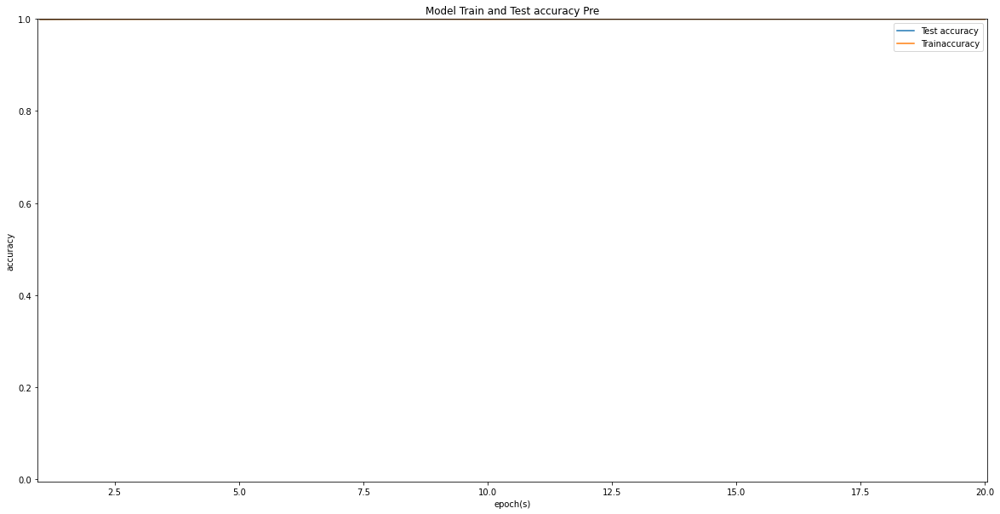

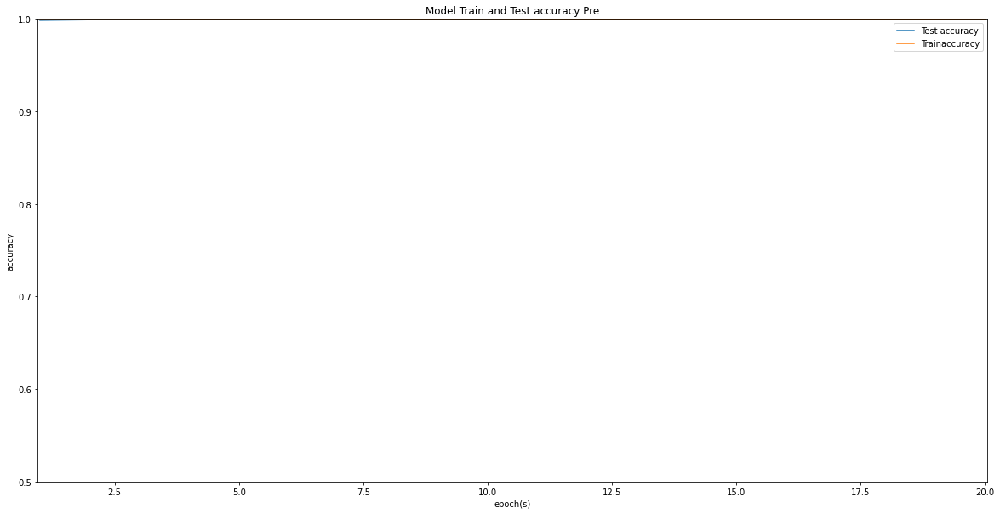

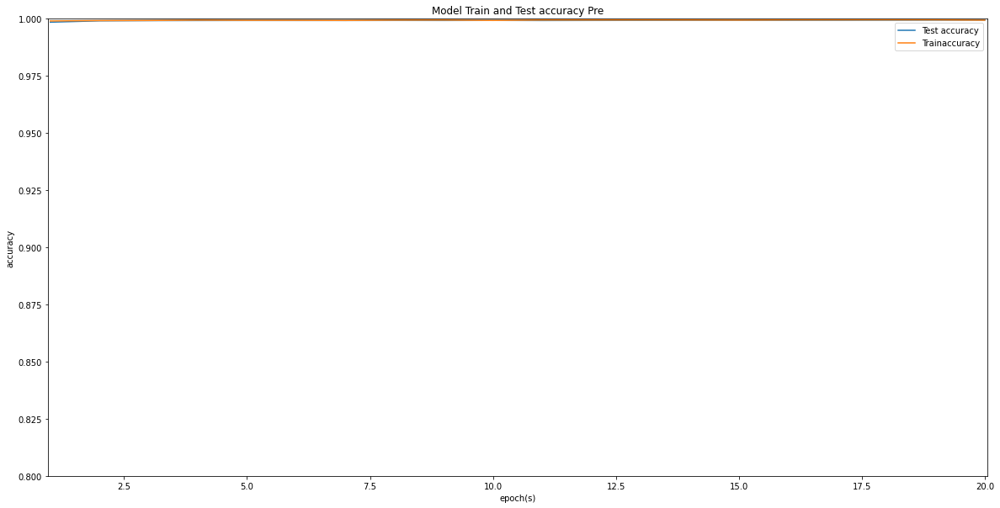

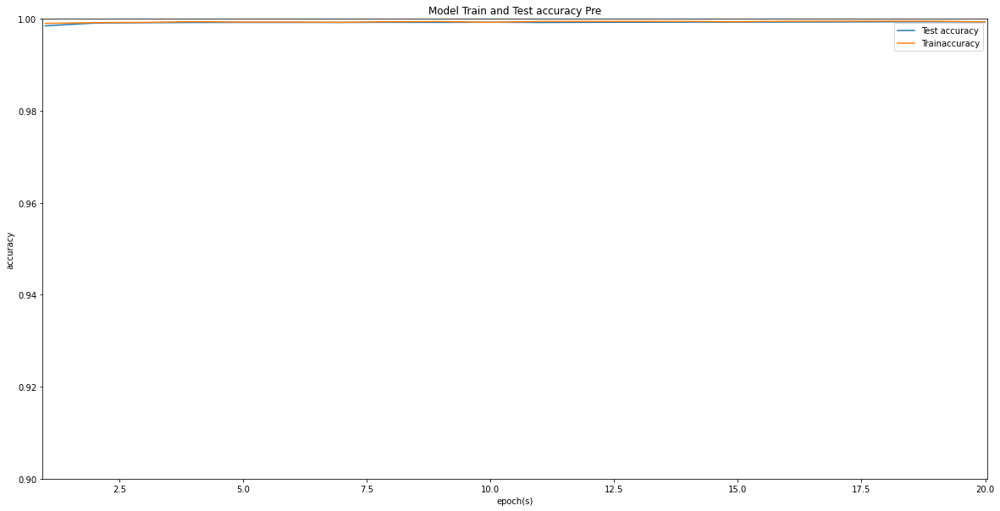

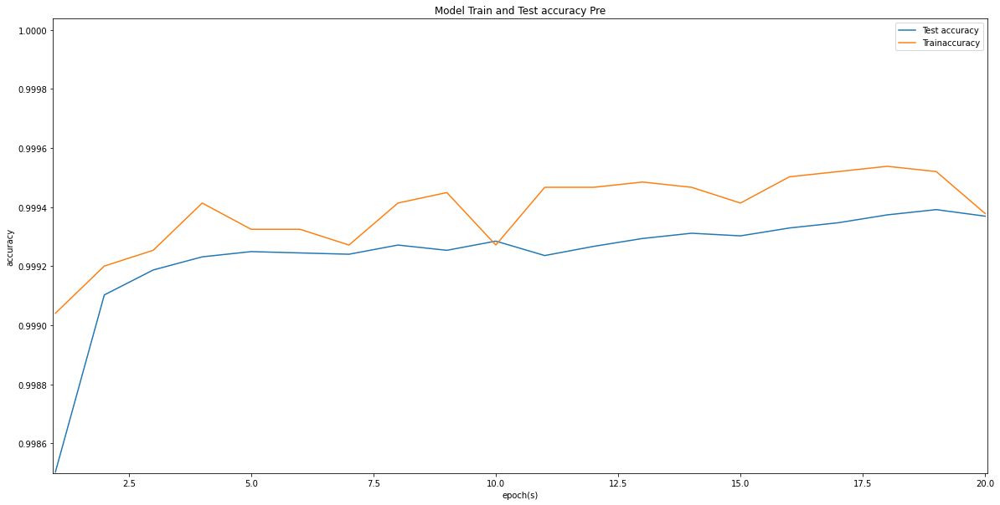

Instructions for updating:
Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
Instructions for updating:
Please use `model.predict()` instead.
Classification Report for Default Pre Dataset
              precision    recall  f1-score   support

         0.0     0.9997    0.9997    0.9997     56199
         1.0     0.8242    0.7979    0.8108        94

    accuracy                         0.9994     56293
   macro avg     0.9119    0.8988    0.9052     56293
weighted avg     0.9994    0.9994    0.9994     56293


Best Threshold           =  0.7472
F-Score                  =  0.8506
Best Recall Score        =  0.7872
Best Precision Score     =  0.925
Area under the PRC Curve =  0.8468
Accuracy Score           =  0.9994


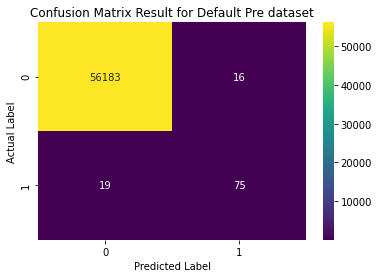

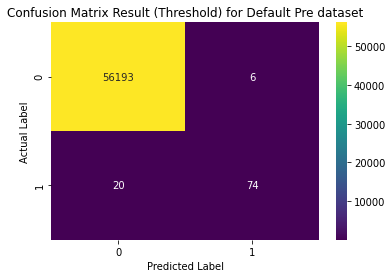

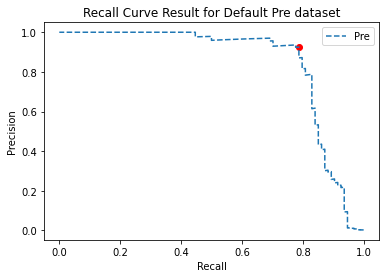

In [79]:
plot_model(RESULT_Pre,METRICS[0],DISPLAY_MODE[0])
plot_evaluation(MODEL_Pre, X_pre_test, Y_pre_test)

####Preprocess (UpScale) Dataset

In [80]:
model_run_default(X_pre_trainUp, Y_pre_trainUp, X_pre_test, Y_pre_test, MODELS, RESULTS,MODEL_PreUp, RESULT_PreUp, CHECKPOINTS_preUp, IDS[1])

----------------------
<Hyperparameter Used>
Number of Neurons =  20
Number of Layer   =  1
Decay Value       =  0
Batch Size        =  32
Dropout           =  0
----------------------
Building Model...
Total Time Taken: 147.79s
Average Time Taken per epoch: 8694ms
Total epoch: 17
Completed Trained Model
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Relu_Layer1 (Dense)          (None, 20)                400       
_________________________________________________________________
dropout_1 (Dropout)          (None, 20)                0         
_________________________________________________________________
Predictions (Dense)          (None, 1)                 21        
Total params: 421
Trainable params: 421
Non-trainable params: 0
_________________________________________________________________


#####Result

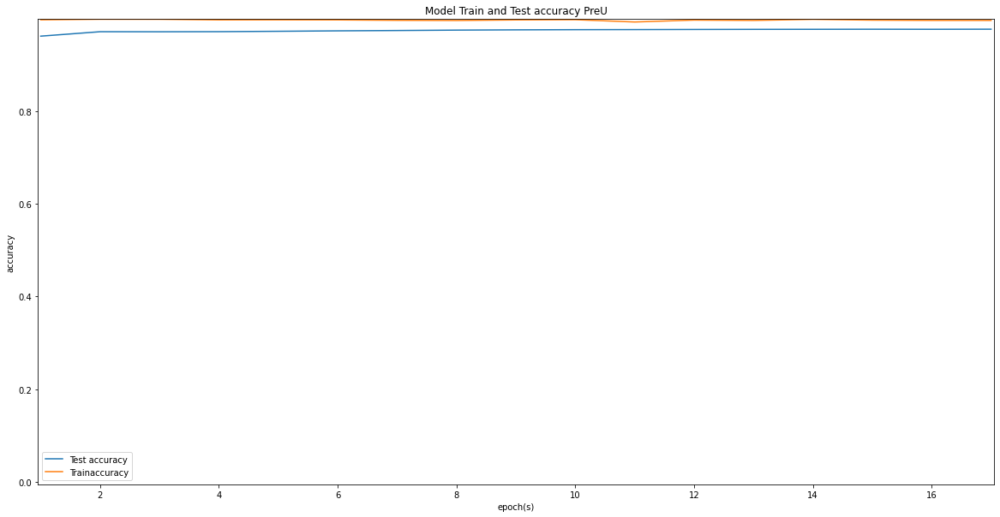

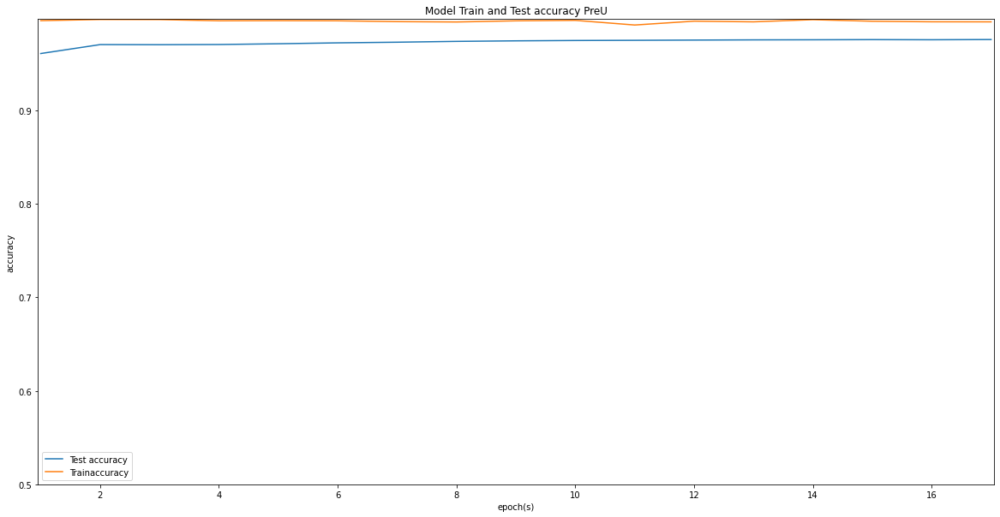

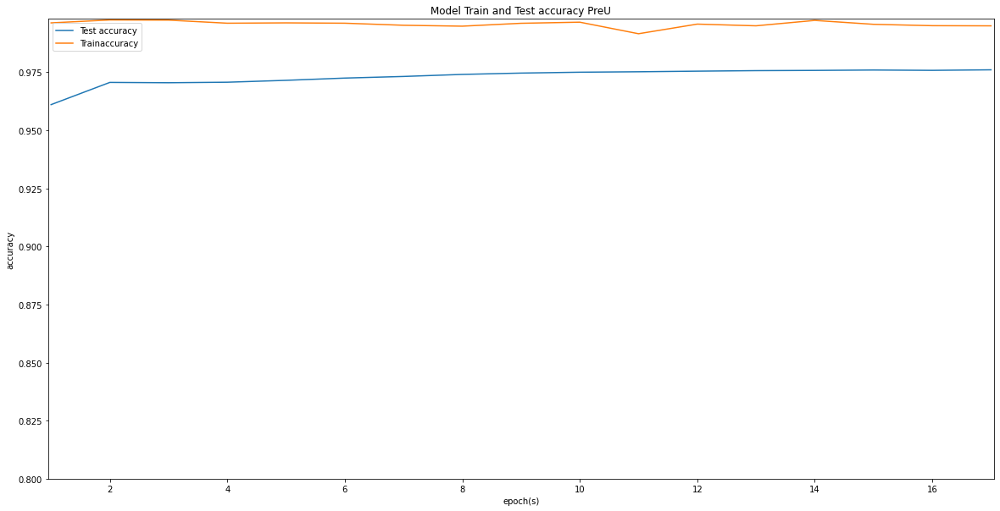

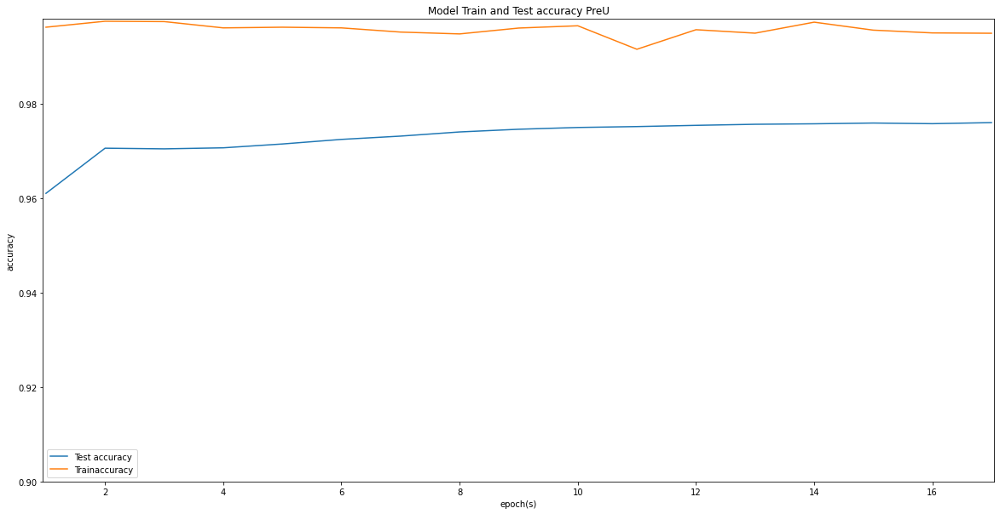

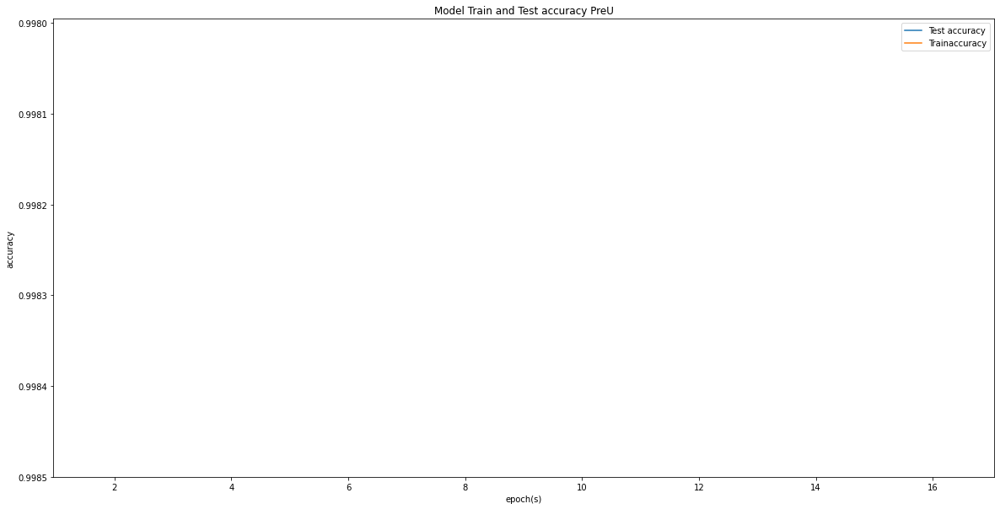

Classification Report for Default PreU Dataset
              precision    recall  f1-score   support

         0.0     0.9999    0.9951    0.9975     56199
         1.0     0.2376    0.9149    0.3772        94

    accuracy                         0.9950     56293
   macro avg     0.6187    0.9550    0.6873     56293
weighted avg     0.9986    0.9950    0.9964     56293


Best Threshold           =  0.9747
F-Score                  =  0.8539
Best Recall Score        =  0.8085
Best Precision Score     =  0.9048
Area under the PRC Curve =  0.8384
Accuracy Score           =  0.995


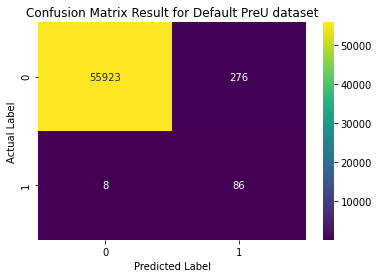

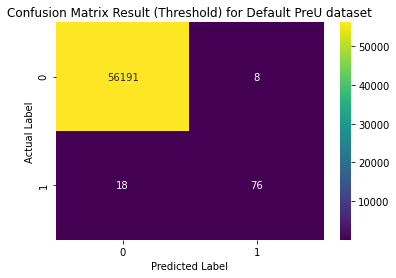

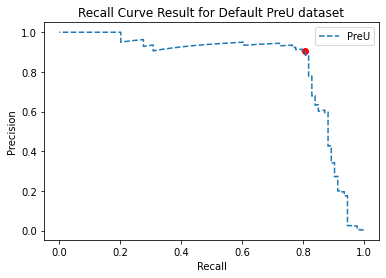

In [81]:
plot_model(RESULT_PreUp,METRICS[0],DISPLAY_MODE[0])
plot_evaluation(MODEL_PreUp, X_pre_test, Y_pre_test)

####Preprocess (DownScale) Dataset

In [82]:
model_run_default(X_pre_trainDown, Y_pre_trainDown, X_pre_test, Y_pre_test, MODELS, RESULTS,MODEL_PreDown, RESULT_PreDown, CHECKPOINTS_preDown, IDS[2])

----------------------
<Hyperparameter Used>
Number of Neurons =  20
Number of Layer   =  1
Decay Value       =  0
Batch Size        =  32
Dropout           =  0
----------------------
Building Model...
Total Time Taken: 17.23s
Average Time Taken per epoch: 1077ms
Total epoch: 16
Completed Trained Model
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Relu_Layer1 (Dense)          (None, 20)                400       
_________________________________________________________________
dropout_2 (Dropout)          (None, 20)                0         
_________________________________________________________________
Predictions (Dense)          (None, 1)                 21        
Total params: 421
Trainable params: 421
Non-trainable params: 0
_________________________________________________________________


#####Result

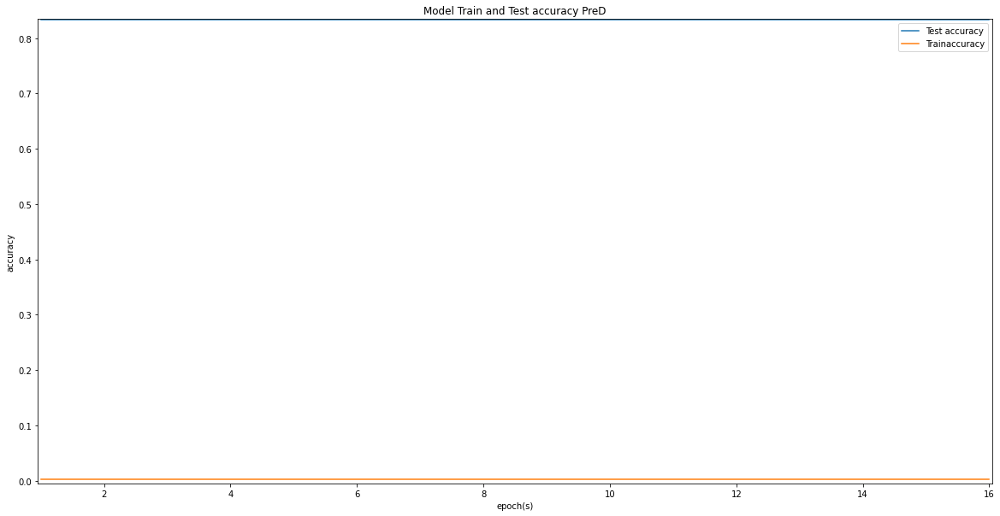

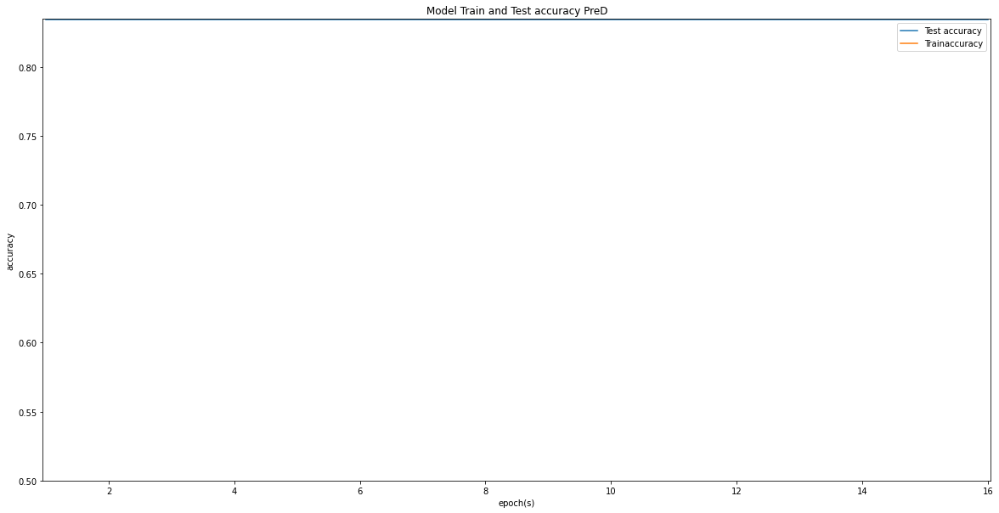

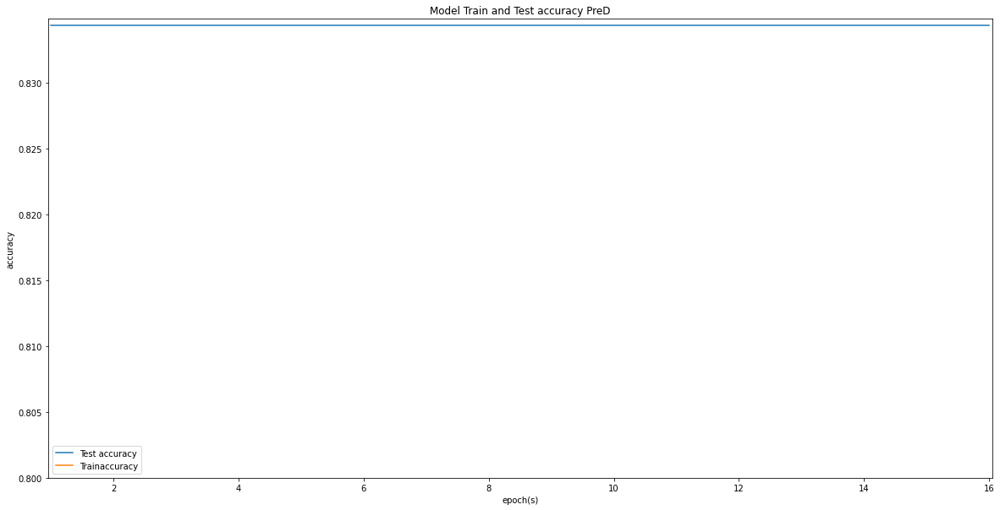

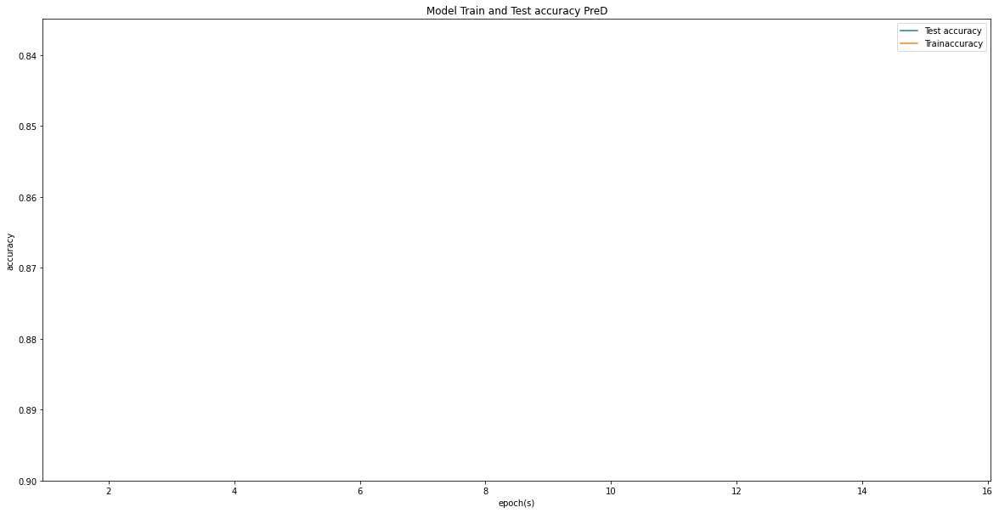

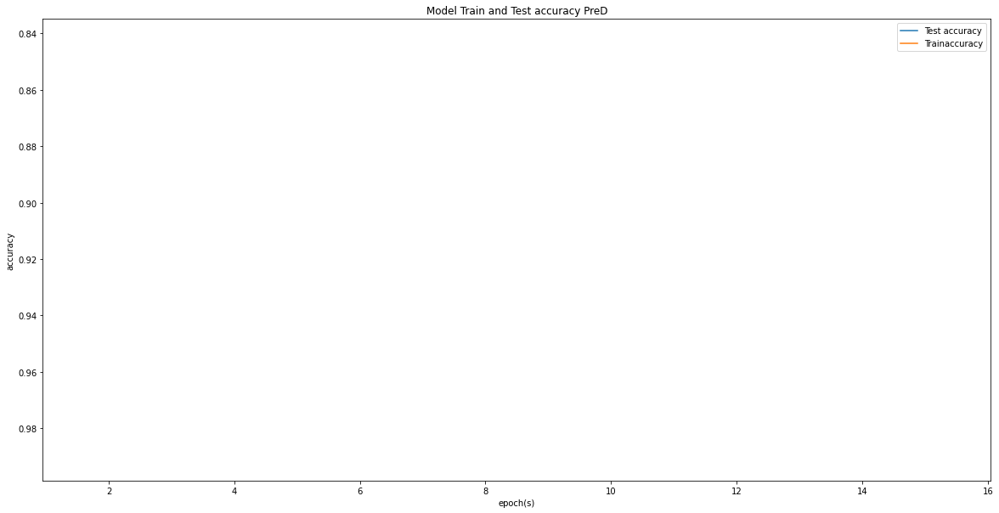

Classification Report for Default PreD Dataset


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

         0.0     0.0000    0.0000    0.0000     56199
         1.0     0.0017    1.0000    0.0033        94

    accuracy                         0.0017     56293
   macro avg     0.0008    0.5000    0.0017     56293
weighted avg     0.0000    0.0017    0.0000     56293


Best Threshold           =  0.8319
F-Score                  =  0.6163
Best Recall Score        =  0.5638
Best Precision Score     =  0.6795
Area under the PRC Curve =  0.6365
Accuracy Score           =  0.0017


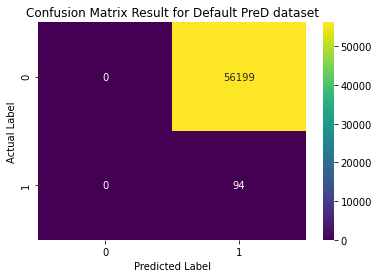

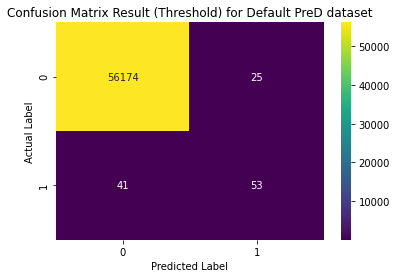

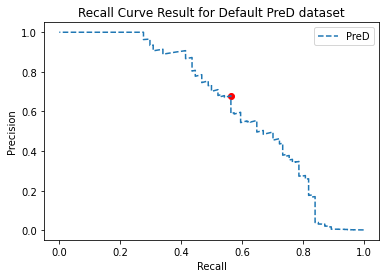

In [83]:
plot_model(RESULT_PreDown,METRICS[0],DISPLAY_MODE[0])
plot_evaluation(MODEL_PreDown, X_pre_test, Y_pre_test)

#### Preprocess (SMOTE) Dataset

In [84]:
model_run_default(X_pre_trainSMT, Y_pre_trainSMT, X_pre_test, Y_pre_test, MODELS, RESULTS,MODEL_PreSMT, RESULT_PreSMT, CHECKPOINTS_preSMT, IDS[3])

----------------------
<Hyperparameter Used>
Number of Neurons =  20
Number of Layer   =  1
Decay Value       =  0
Batch Size        =  32
Dropout           =  0
----------------------
Building Model...
Total Time Taken: 175.75s
Average Time Taken per epoch: 8787ms
Total epoch: 20
Completed Trained Model
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Relu_Layer1 (Dense)          (None, 20)                400       
_________________________________________________________________
dropout_3 (Dropout)          (None, 20)                0         
_________________________________________________________________
Predictions (Dense)          (None, 1)                 21        
Total params: 421
Trainable params: 421
Non-trainable params: 0
_________________________________________________________________


#####Result

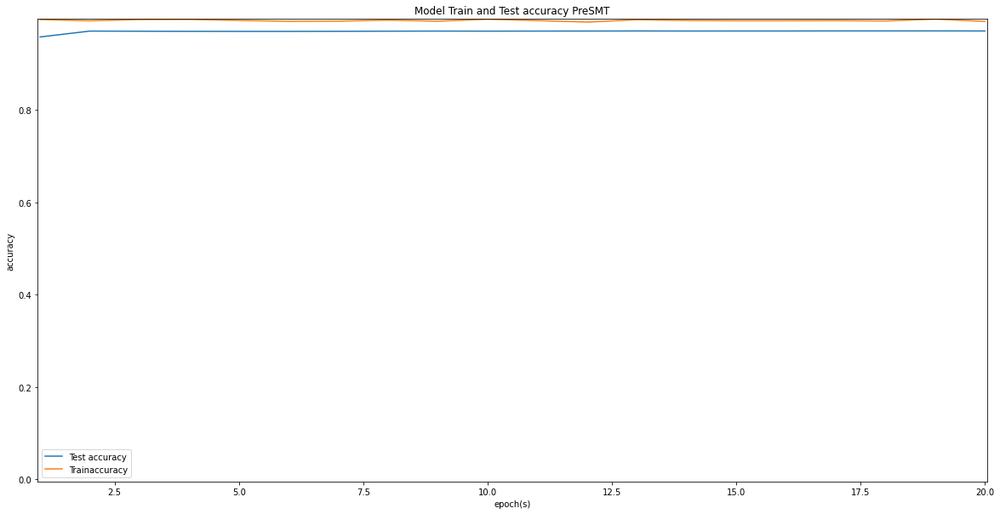

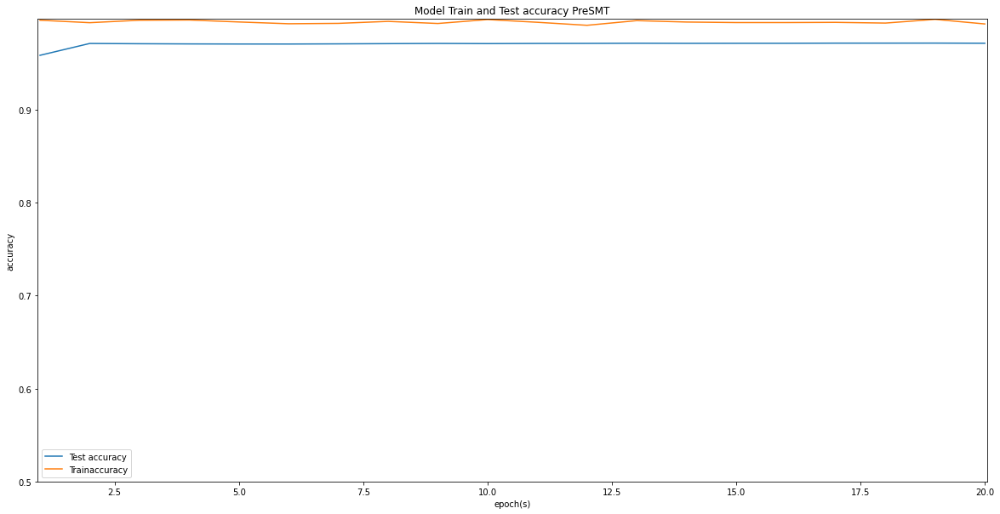

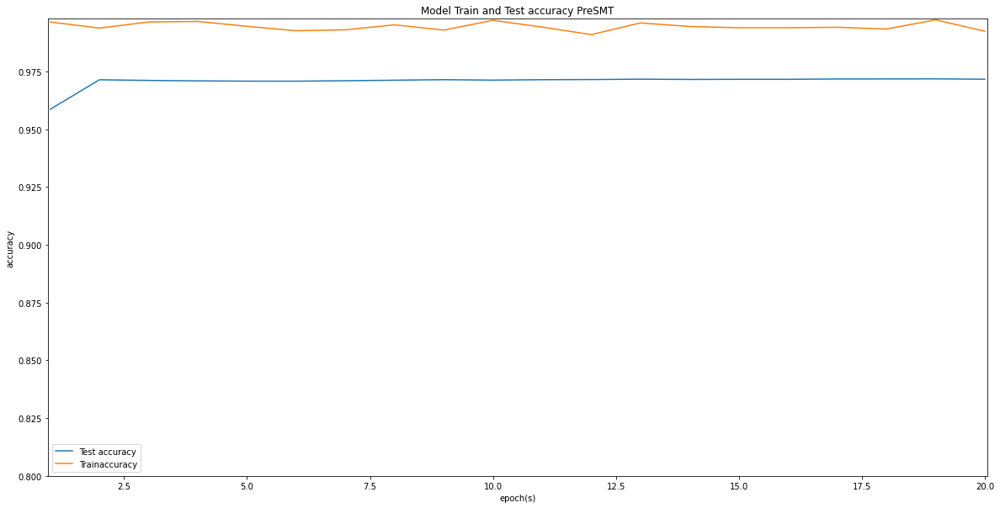

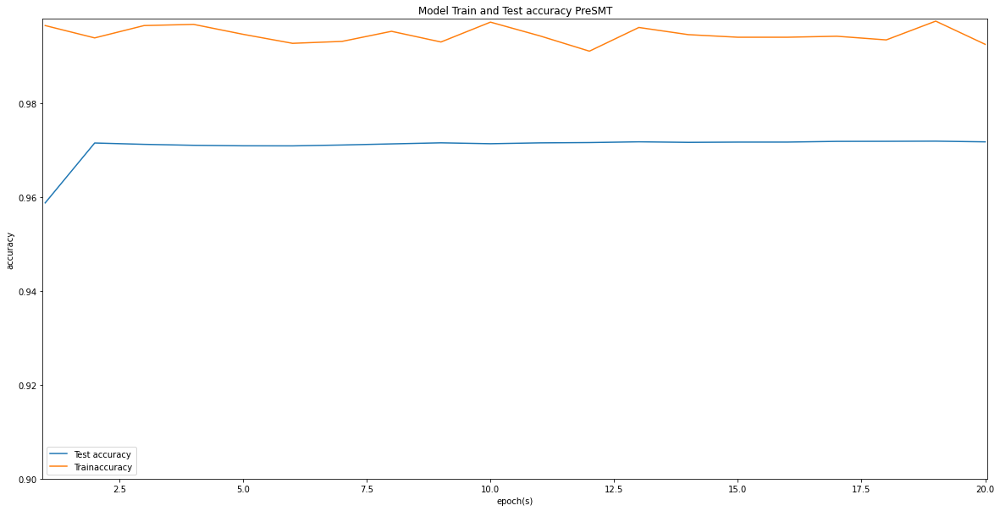

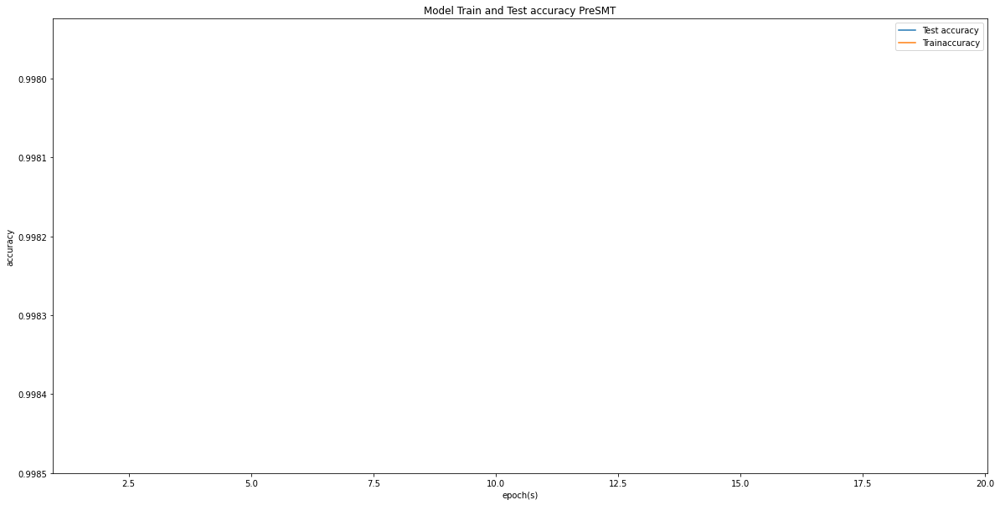

Classification Report for Default PreSMT Dataset
              precision    recall  f1-score   support

         0.0     0.9999    0.9926    0.9962     56199
         1.0     0.1730    0.9255    0.2915        94

    accuracy                         0.9925     56293
   macro avg     0.5864    0.9591    0.6438     56293
weighted avg     0.9985    0.9925    0.9950     56293


Best Threshold           =  0.9942
F-Score                  =  0.8172
Best Recall Score        =  0.8085
Best Precision Score     =  0.8261
Area under the PRC Curve =  0.8195
Accuracy Score           =  0.9925


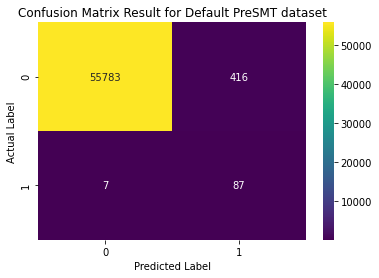

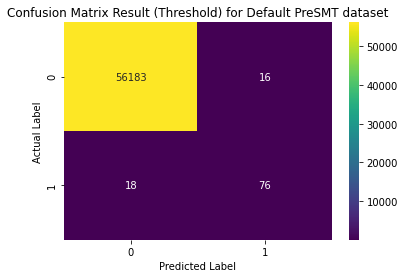

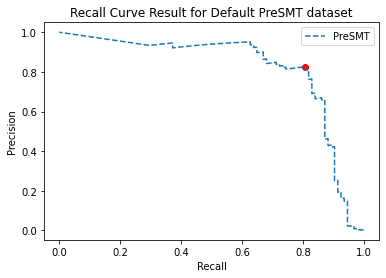

In [85]:
plot_model(RESULT_PreSMT,METRICS[0],DISPLAY_MODE[0])
plot_evaluation(MODEL_PreSMT, X_pre_test, Y_pre_test)

####Comparison of Primary Finding and Evaluation

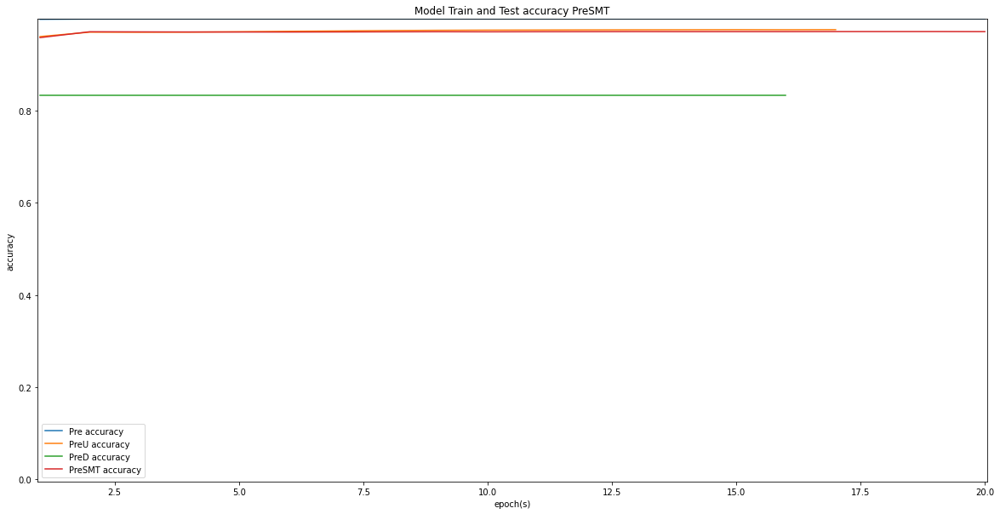

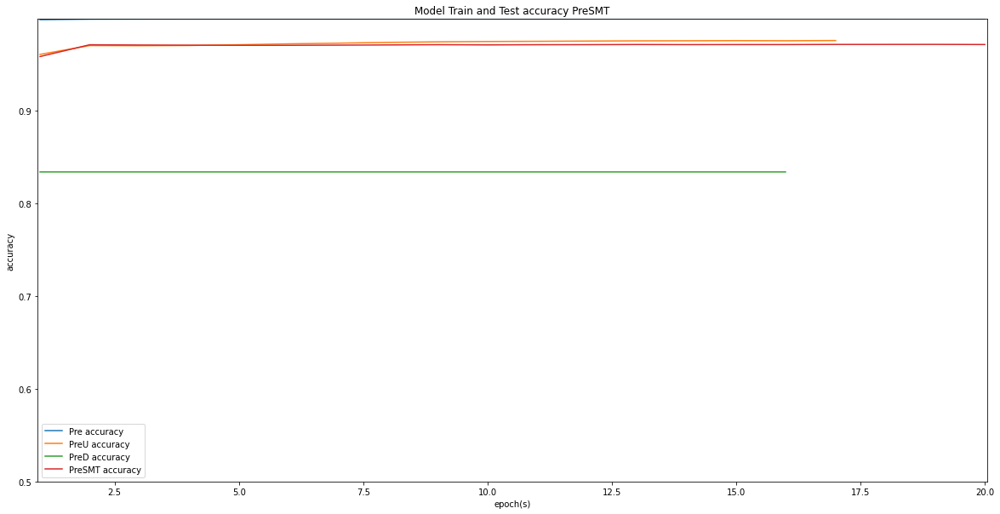

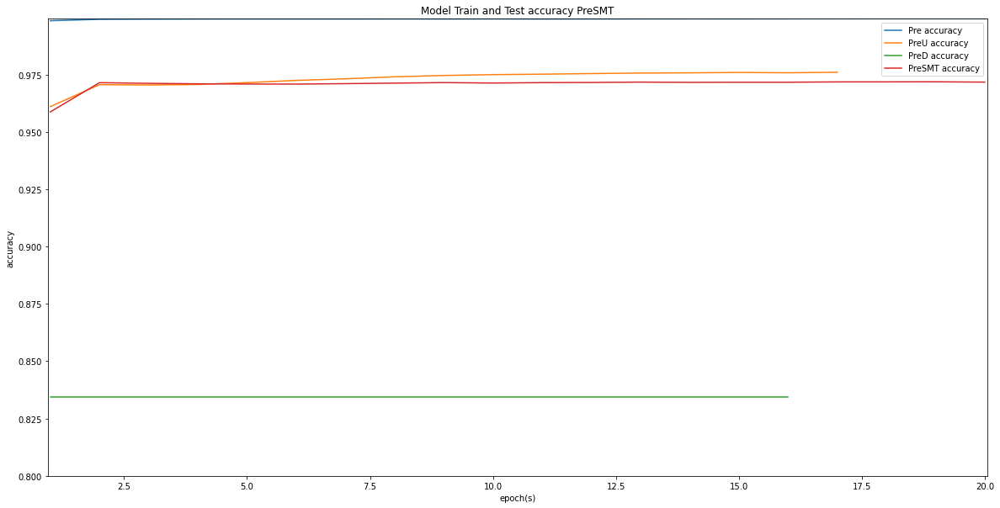

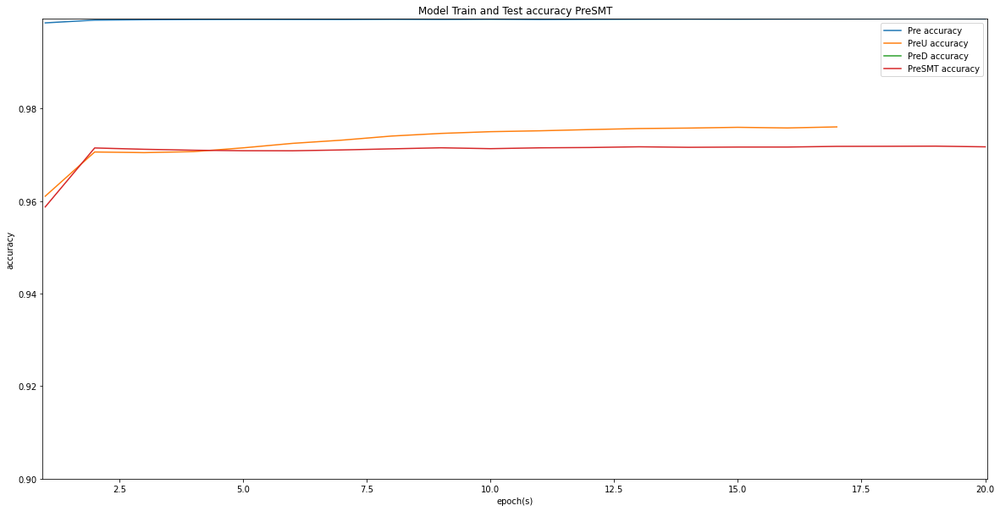

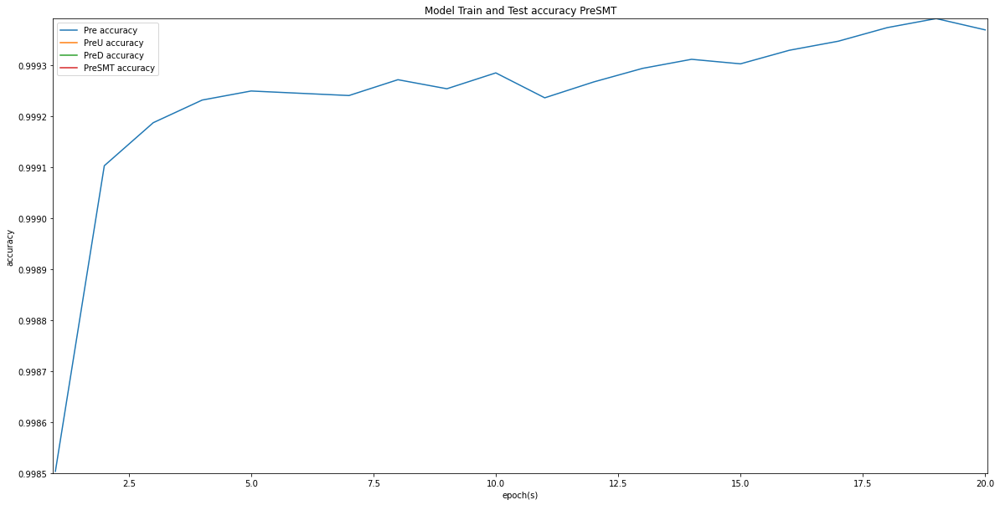

...

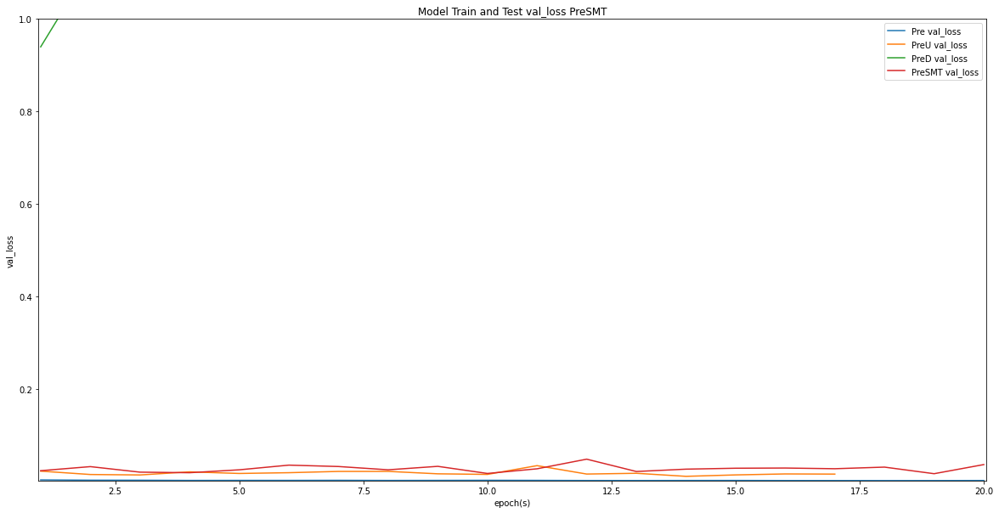

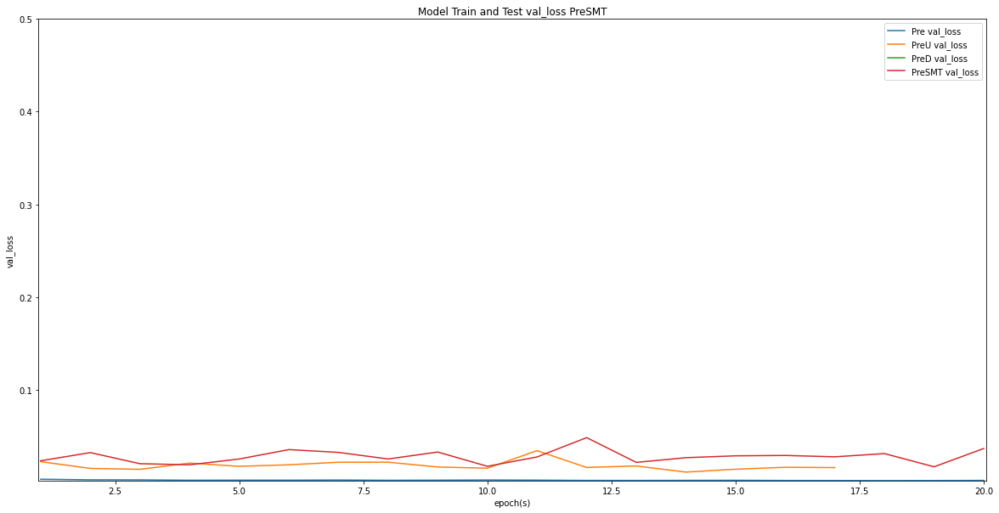

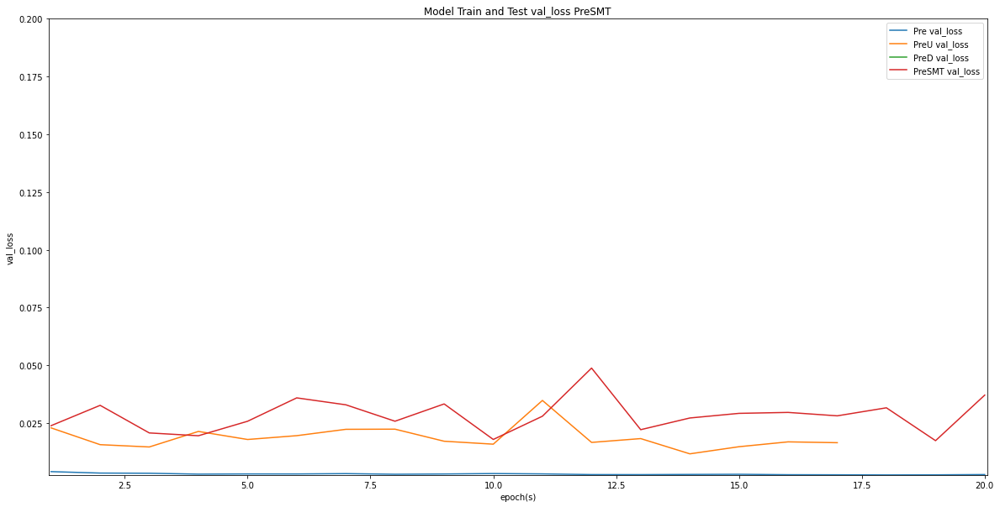

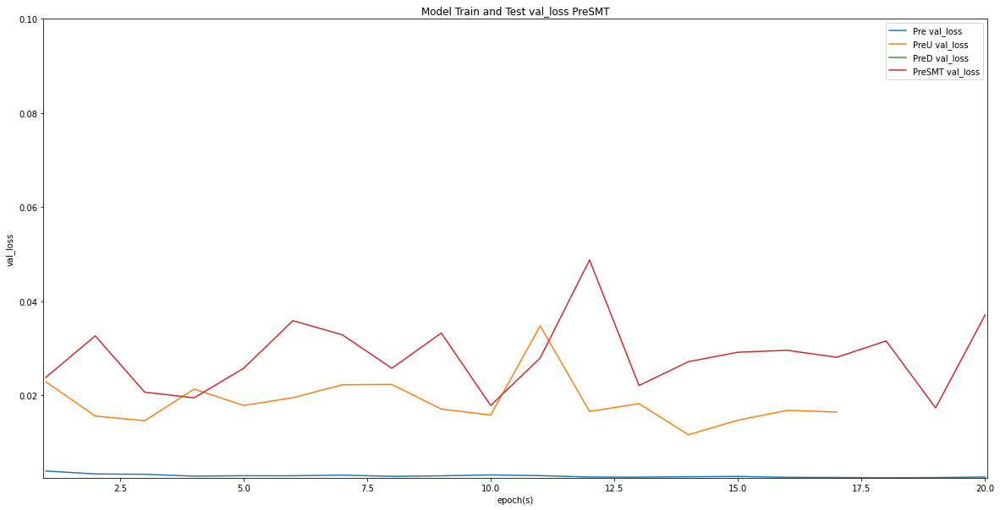

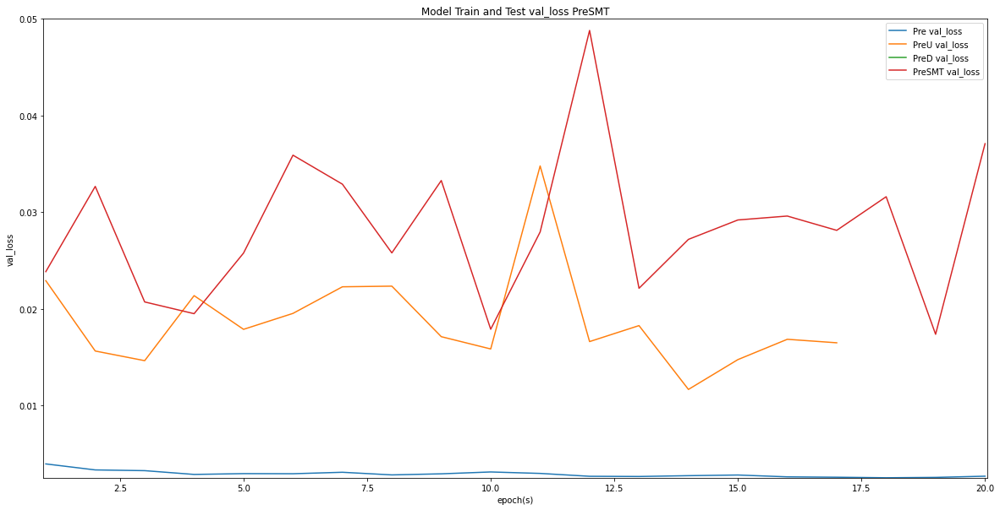

In [86]:
plot_model(RESULTS,METRICS[0],DISPLAY_MODE[1])
plot_model(RESULTS,METRICS[1],DISPLAY_MODE[1])
plot_model(RESULTS,METRICS[2],DISPLAY_MODE[1])
plot_model(RESULTS,METRICS[3],DISPLAY_MODE[1])

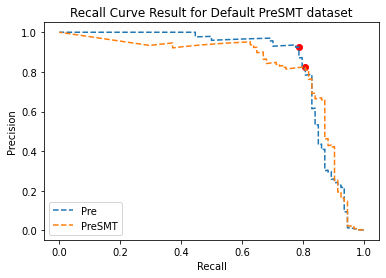

In [87]:
MODELS_PREvsPRESMT = [MODELS[0],MODELS[3]]
plot_AUC(MODELS_PREvsPRESMT,X_pre_test,Y_pre_test)

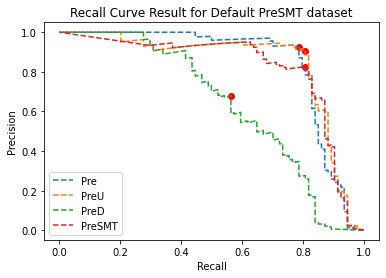

In [113]:
MODELS_PRI = [MODELS[0],MODELS[1],MODELS[2],MODELS[3]]
plot_AUC(MODELS_PRI,X_pre_test,Y_pre_test)

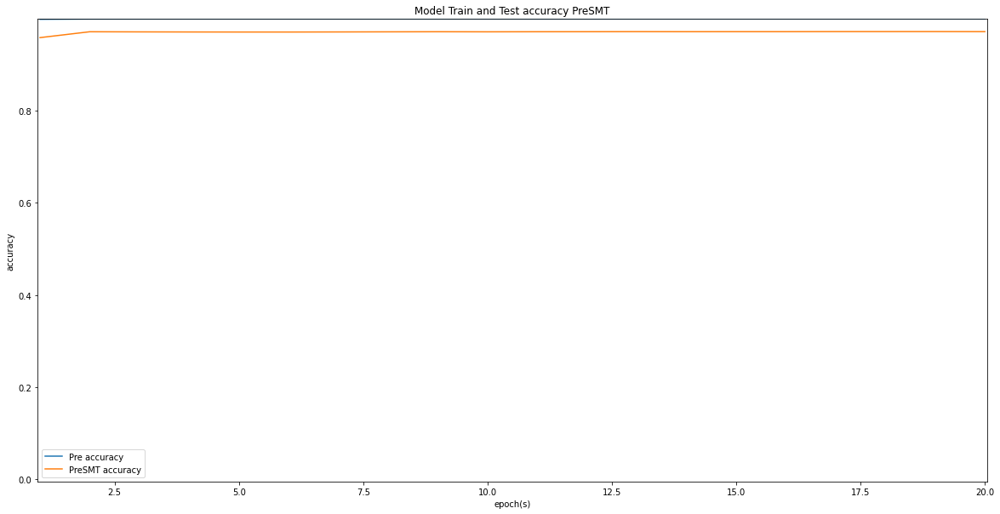

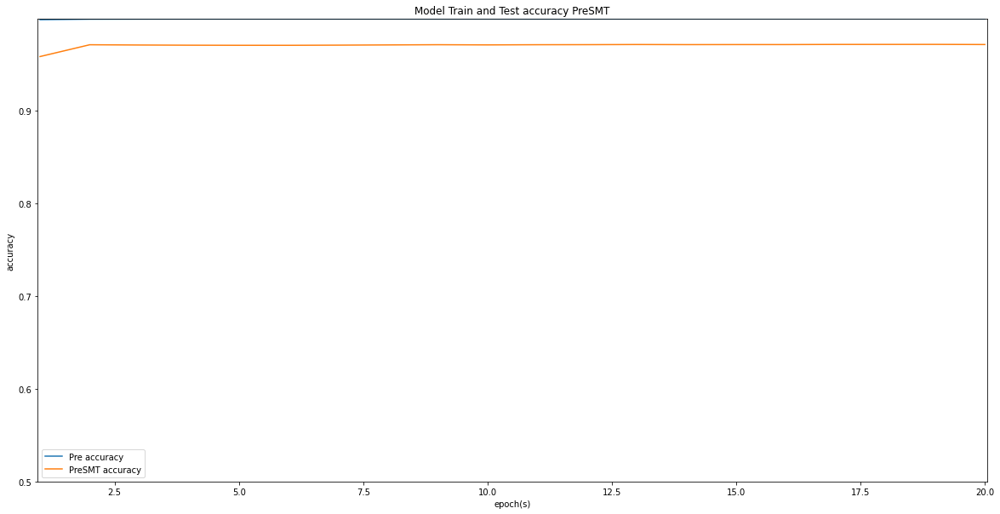

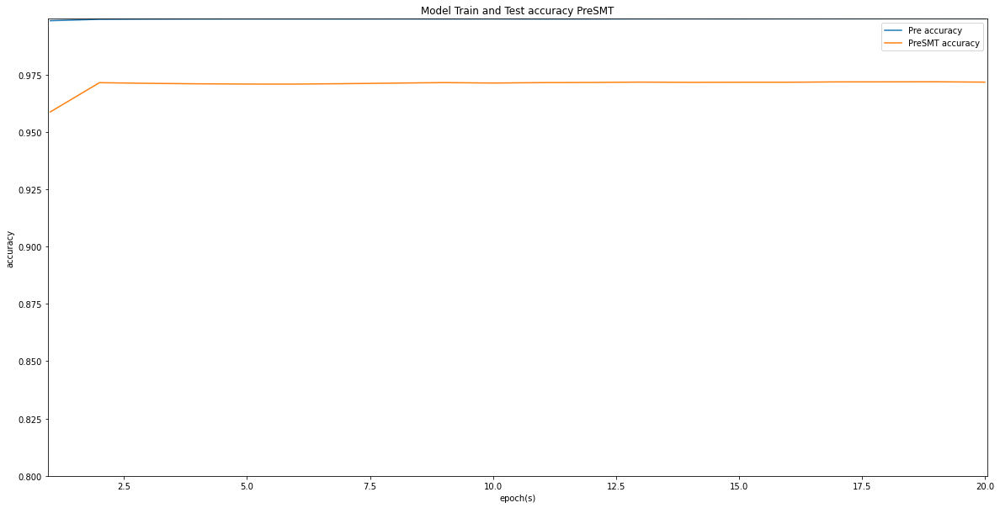

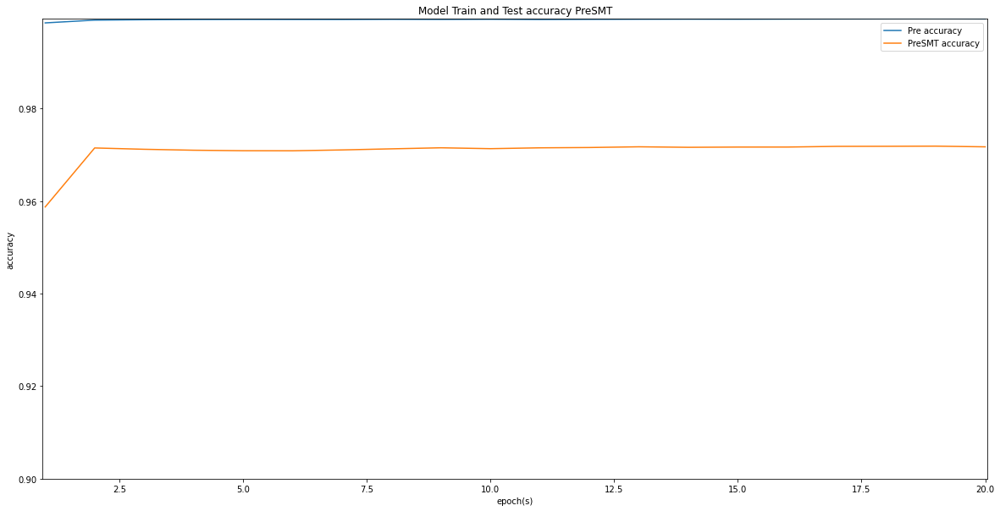

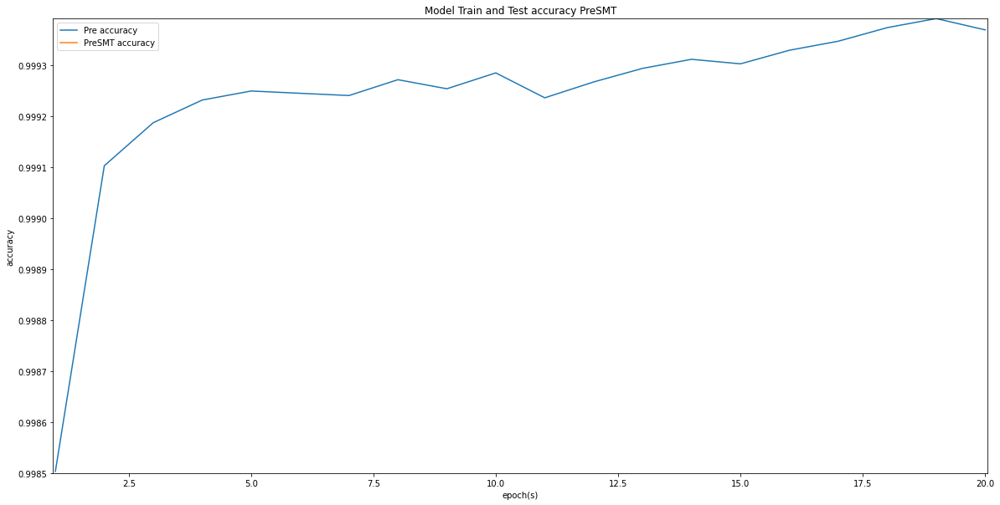

...

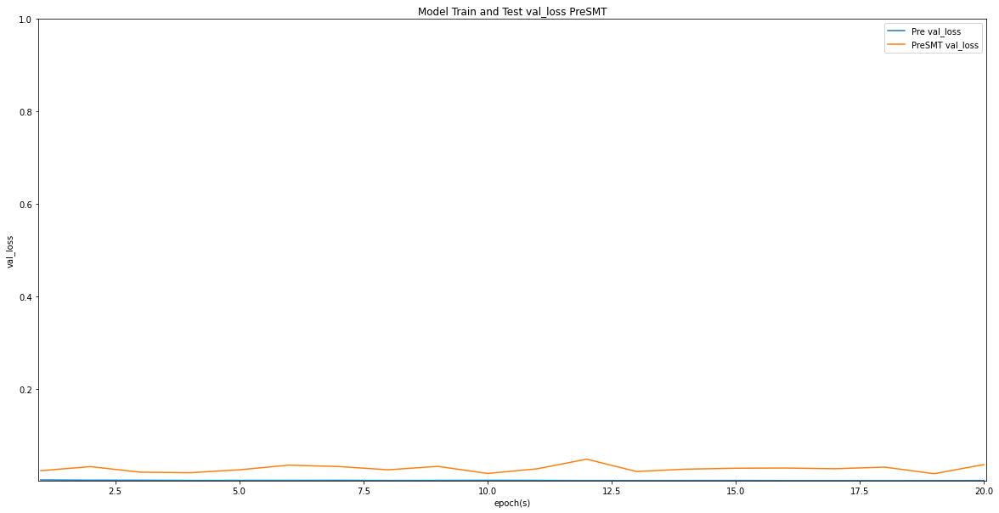

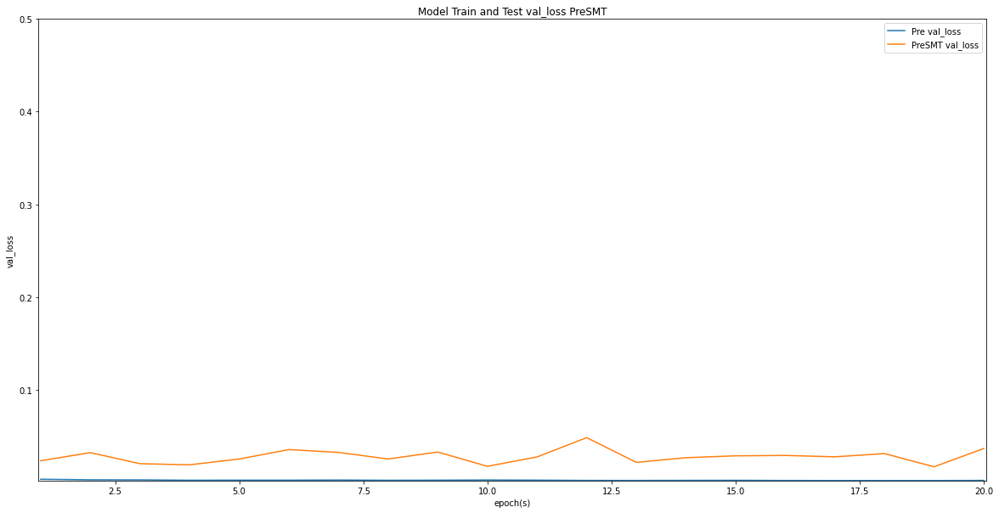

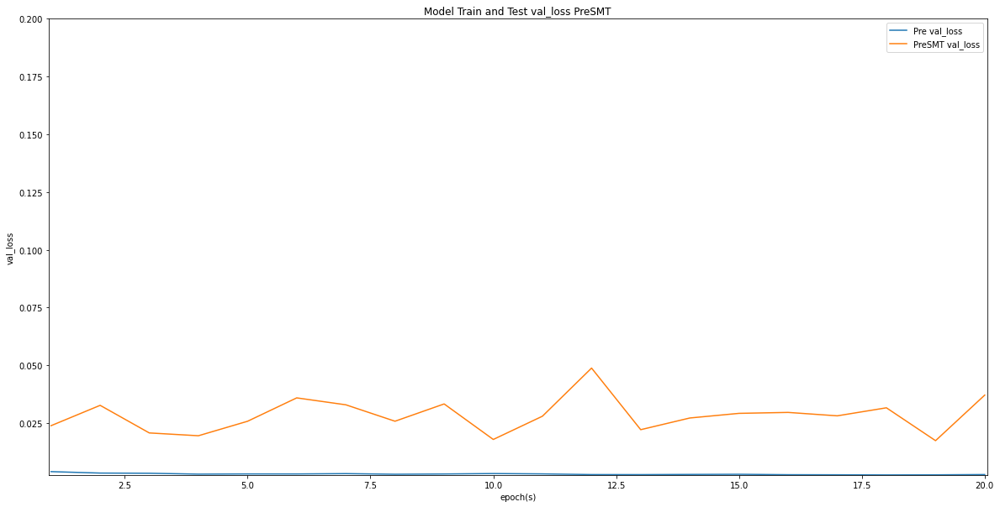

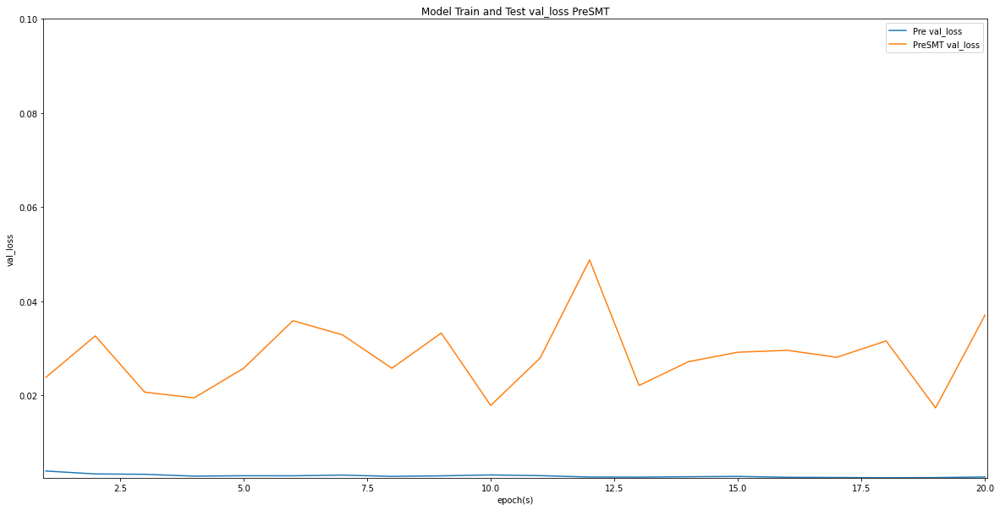

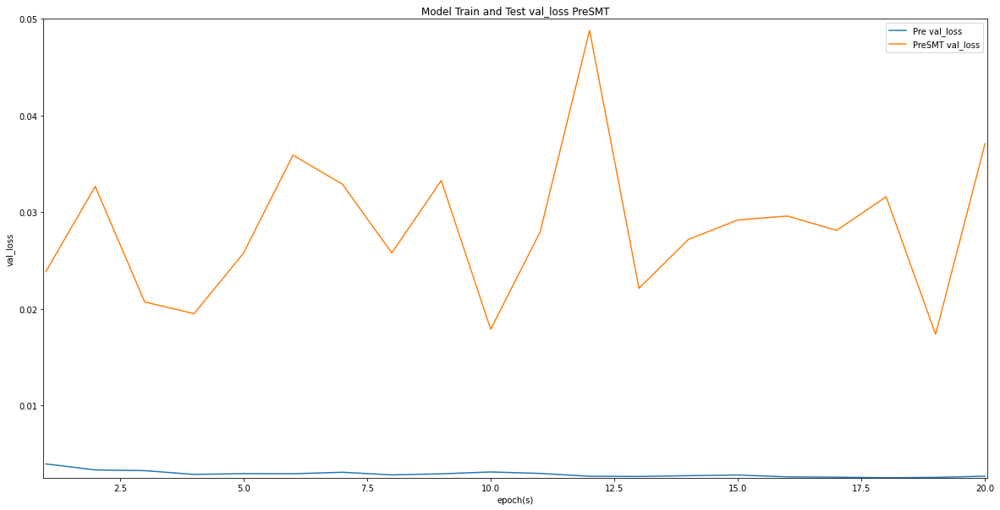

In [128]:
R1 = [RESULTS[0],RESULTS[3]]

plot_model(R1,METRICS[0],DISPLAY_MODE[1])
plot_model(R1,METRICS[1],DISPLAY_MODE[1])
plot_model(R1,METRICS[2],DISPLAY_MODE[1])
plot_model(R1,METRICS[3],DISPLAY_MODE[1])

### Selecting Approximate Optimal Hyperparameter with K-Fold

In [88]:
# Debug
#preHP_K = 256,20 ,0,3,0 
#MODEL_Test = []
#MODELS_Test = []
#RESULT_Test = []
#RESULTS_Test = []
#model_run_optK(X_pre_train,Y_pre_train,X_pre_test,Y_pre_test, MODELS_Test, RESULTS_Test,MODEL_Test,RESULT_Test ,CHECKPOINTS_preOPTK, IDS[4],preHP_K)

#### Preprocess Dataset

In [89]:
preHP_K    = Kfold_CV(X_pre_train,Y_pre_train,X_pre_test,Y_pre_test,CHECKPOINTS_Dummy,IDS[4],MODEL_Dummy,splitdataset_pre)

------------------------- Batch Size -------------------------
----------------------
<Hyperparameter Used>
Number of Neurons =  20
Number of Layer   =  1
Decay Value       =  0
Batch Size        =  16
Dropout           =  0
----------------------
Building Model...
Total Time Taken: 238.67s
Average Time Taken per epoch: 11934ms
Total epoch: 20
Completed Trained Model
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Relu_Layer1 (Dense)          (None, 20)                400       
_________________________________________________________________
dropout_4 (Dropout)          (None, 20)                0         
_________________________________________________________________
Predictions (Dense)          (None, 1)                 21        
Total params: 421
Trainable params: 421
Non-trainable params: 0
_________________________________________________________________
----------------

#####Optimal Hyperparameter and Result

In [90]:
model_run_optK(X_pre_train,Y_pre_train,X_pre_test,Y_pre_test, MODELS, RESULTS,MODEL_PreOptK,RESULT_PreOptK ,CHECKPOINTS_preOPTK, IDS[4],preHP_K)

------------------------------
<Optimal Hyperparameter Used>
Number of Neurons per Layer =  15
Number of Layer             =  3
Decay Value                 =  1e-06
Batch Size                  =  64
Dropout                     =  0.2
------------------------------
Building Model...
Total Time Taken: 93.62s
Average Time Taken per epoch: 4681ms
Total epoch: 20
Completed Trained Model
Model: "sequential_29"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 15)                300       
_________________________________________________________________
dropout_49 (Dropout)         (None, 15)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 15)                240       
_________________________________________________________________
dropout_50 (Dropout)         (None, 15)                0        

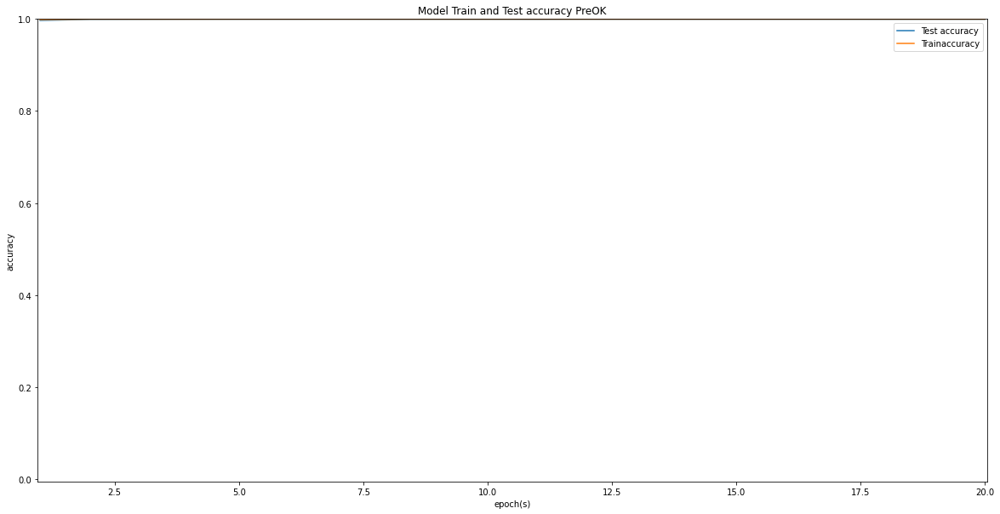

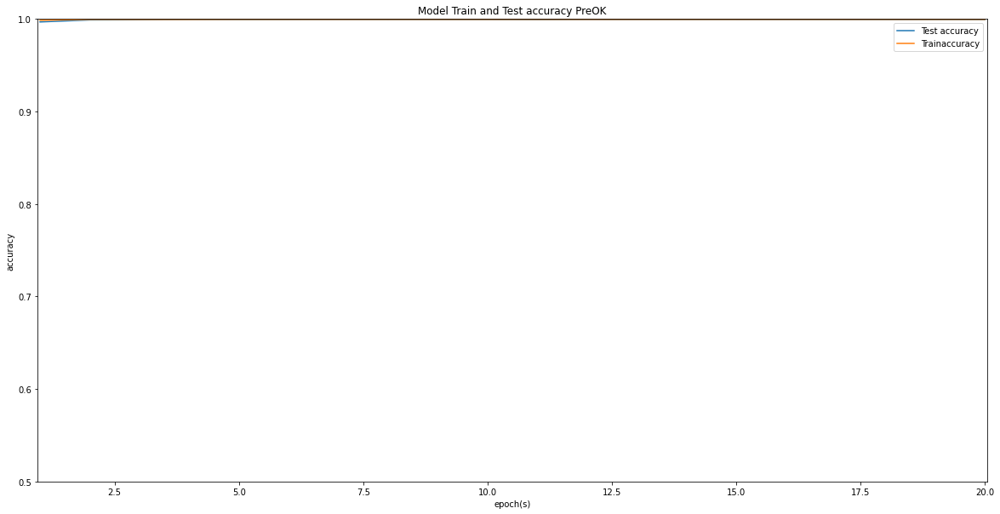

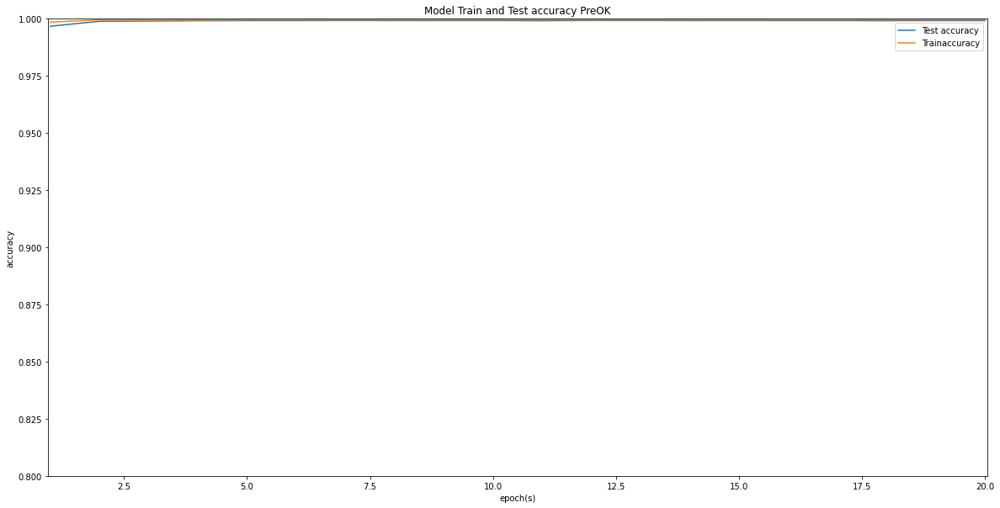

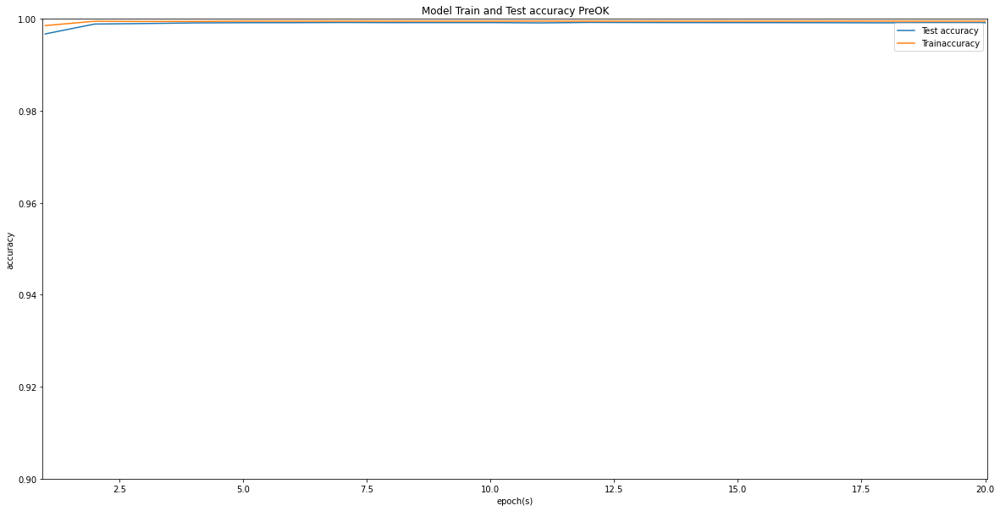

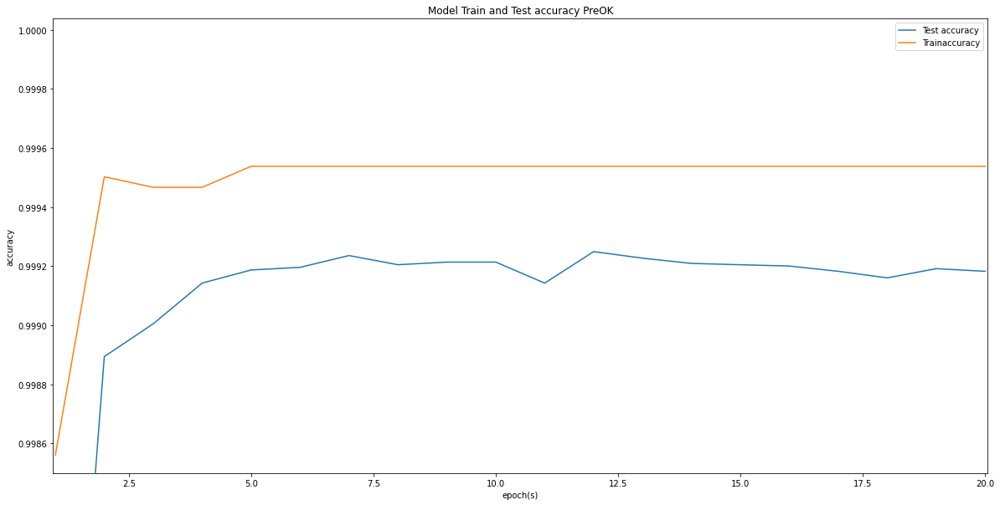

Classification Report for OptimalK PreOK Dataset
              precision    recall  f1-score   support

         0.0     0.9996    0.9999    0.9998     56199
         1.0     0.9359    0.7766    0.8488        94

    accuracy                         0.9995     56293
   macro avg     0.9678    0.8883    0.9243     56293
weighted avg     0.9995    0.9995    0.9995     56293


Best Threshold           =  0.5018
F-Score                  =  0.8488
Best Recall Score        =  0.7766
Best Precision Score     =  0.9359
Area under the PRC Curve =  0.8291
Accuracy Score           =  0.9995


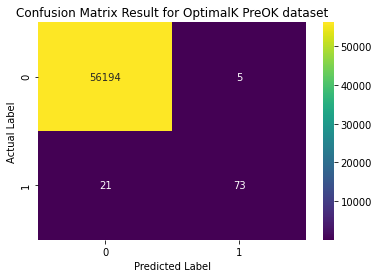

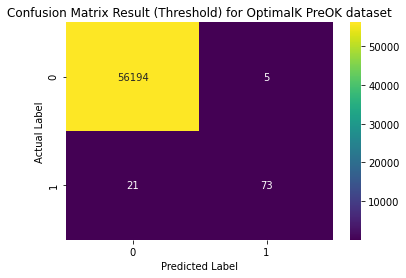

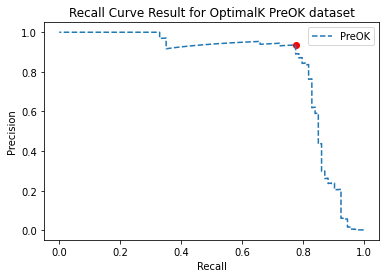

In [91]:
plot_model(RESULT_PreOptK,METRICS[0],DISPLAY_MODE[0])
plot_evaluation(MODEL_PreOptK, X_pre_test, Y_pre_test)

#### Preprocess SMOTE Dataset

In [92]:
preSMTHP_K = Kfold_CV(X_pre_trainSMT,Y_pre_trainSMT,X_pre_test,Y_pre_test,CHECKPOINTS_Dummy,IDS[5],MODEL_Dummy,splitdataset_pre_smt)

------------------------- Batch Size -------------------------
----------------------
<Hyperparameter Used>
Number of Neurons =  20
Number of Layer   =  1
Decay Value       =  0
Batch Size        =  16
Dropout           =  0
----------------------
Building Model...
Total Time Taken: 286.09s
Average Time Taken per epoch: 14304ms
Total epoch: 20
Completed Trained Model
Model: "sequential_30"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Relu_Layer1 (Dense)          (None, 20)                400       
_________________________________________________________________
dropout_52 (Dropout)         (None, 20)                0         
_________________________________________________________________
Predictions (Dense)          (None, 1)                 21        
Total params: 421
Trainable params: 421
Non-trainable params: 0
_________________________________________________________________
---------------

##### Optimal Hyperparameter and Result

In [93]:
model_run_optK(X_pre_trainSMT,Y_pre_trainSMT,X_pre_test,Y_pre_test, MODELS, RESULTS,MODEL_PreSMTOptK,RESULT_PreSMTOptK ,CHECKPOINTS_preSMTOPTK, IDS[5],preSMTHP_K)

------------------------------
<Optimal Hyperparameter Used>
Number of Neurons per Layer =  20
Number of Layer             =  5
Decay Value                 =  0
Batch Size                  =  16
Dropout                     =  0.0
------------------------------
Building Model...
Total Time Taken: 401.94s
Average Time Taken per epoch: 21155ms
Total epoch: 19
Completed Trained Model
Model: "sequential_55"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 20)                400       
_________________________________________________________________
dropout_107 (Dropout)        (None, 20)                0         
_________________________________________________________________
dense_5 (Dense)              (None, 20)                420       
_________________________________________________________________
dropout_108 (Dropout)        (None, 20)                0         


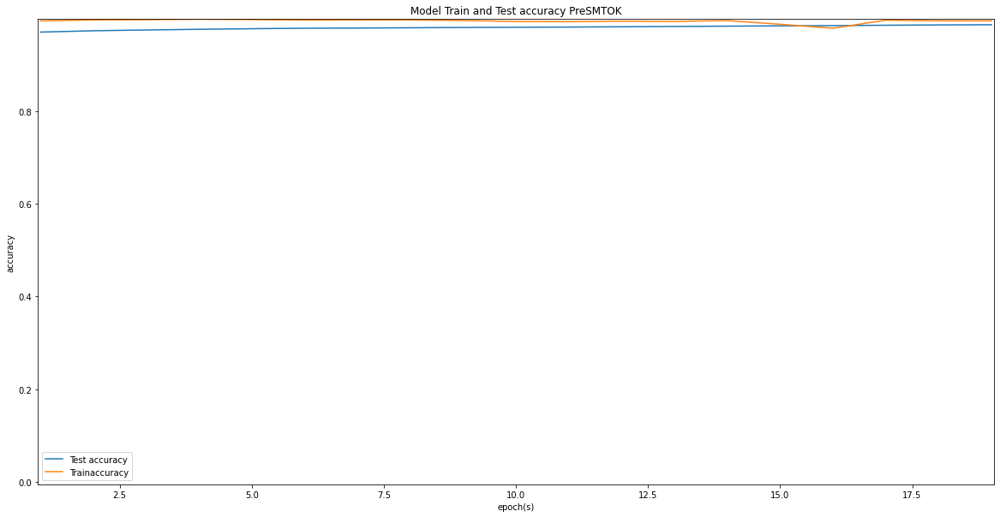

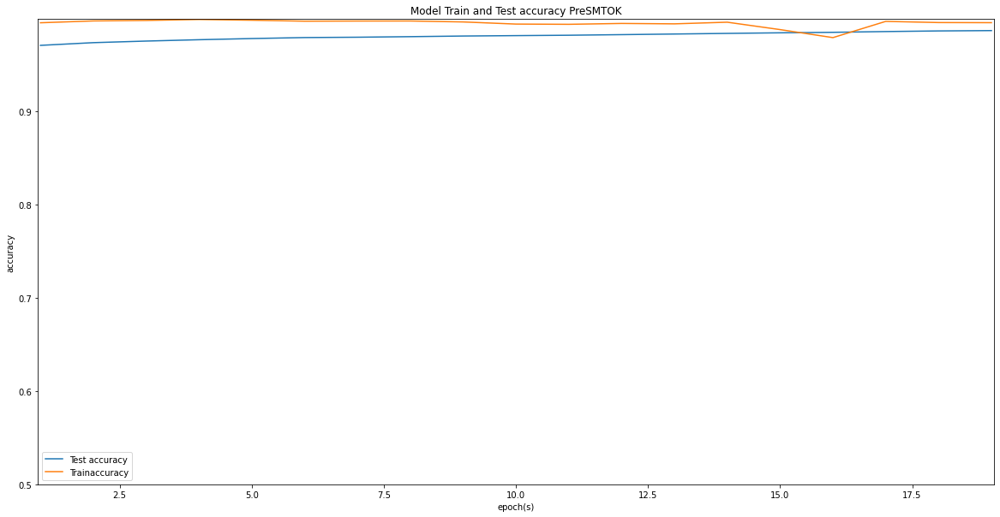

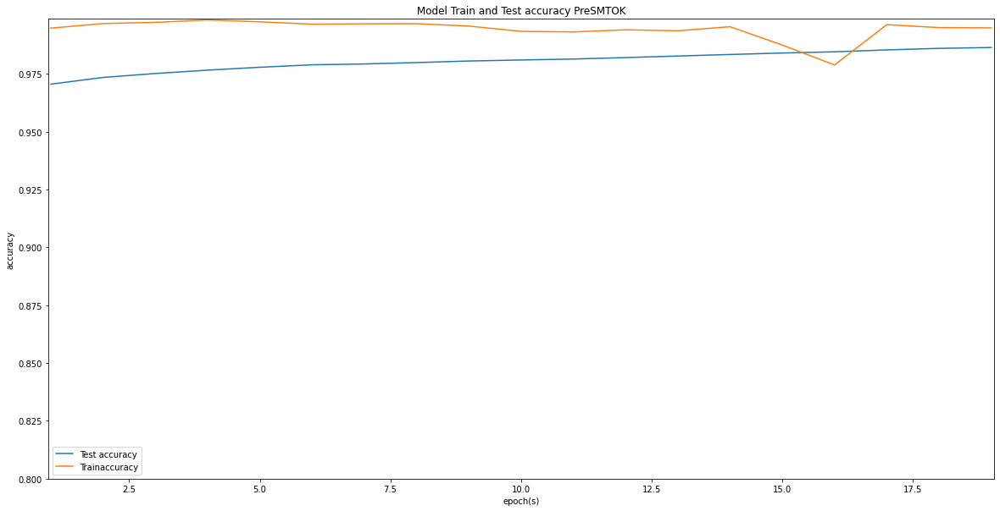

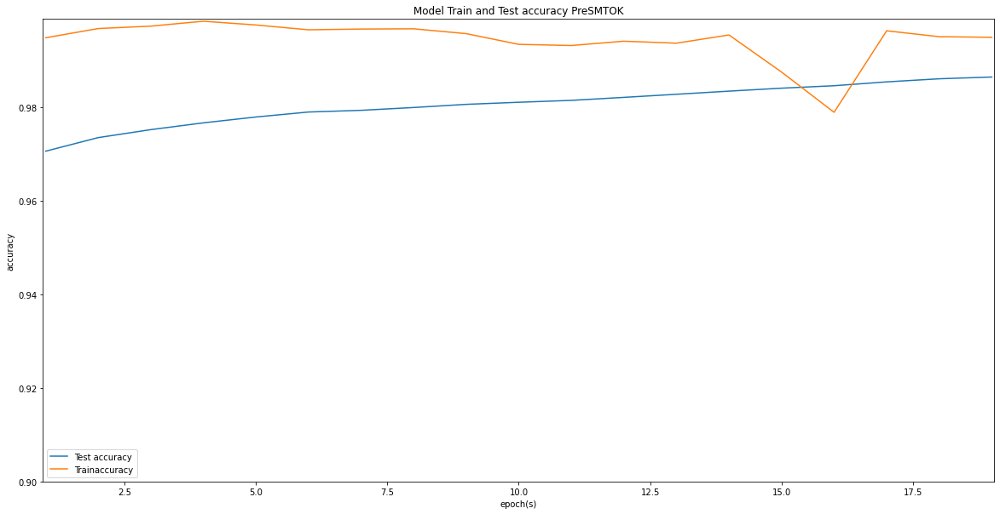

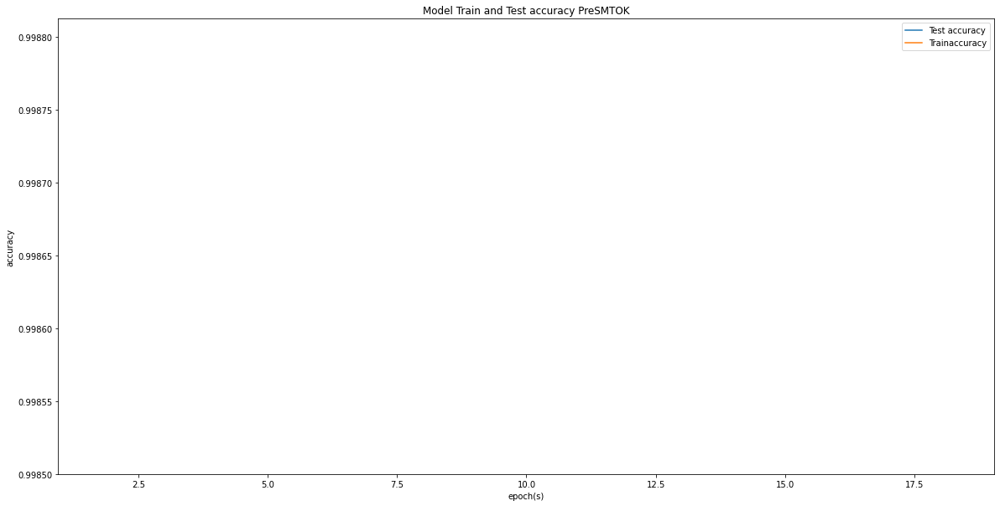

Classification Report for OptimalK PreSMTOK Dataset
              precision    recall  f1-score   support

         0.0     0.9998    0.9950    0.9974     56199
         1.0     0.2335    0.9043    0.3712        94

    accuracy                         0.9949     56293
   macro avg     0.6167    0.9496    0.6843     56293
weighted avg     0.9986    0.9949    0.9964     56293


Best Threshold           =  0.9912
F-Score                  =  0.8667
Best Recall Score        =  0.8298
Best Precision Score     =  0.907
Area under the PRC Curve =  0.8146
Accuracy Score           =  0.9949


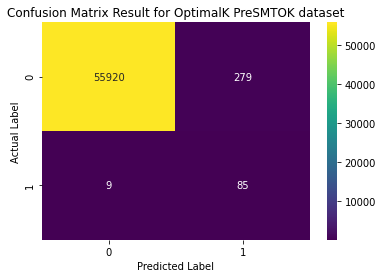

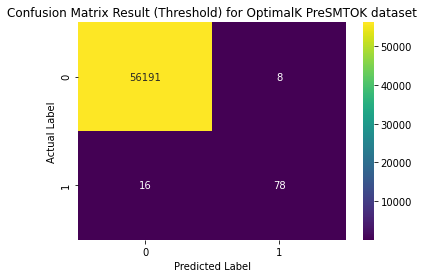

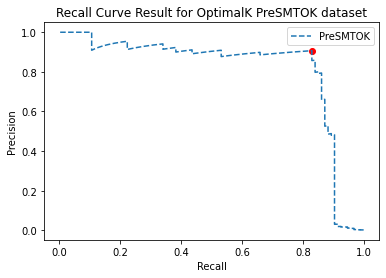

In [94]:
plot_model(RESULT_PreSMTOptK,METRICS[0],DISPLAY_MODE[0])
plot_evaluation(MODEL_PreSMTOptK, X_pre_test, Y_pre_test)

#### Evaluation

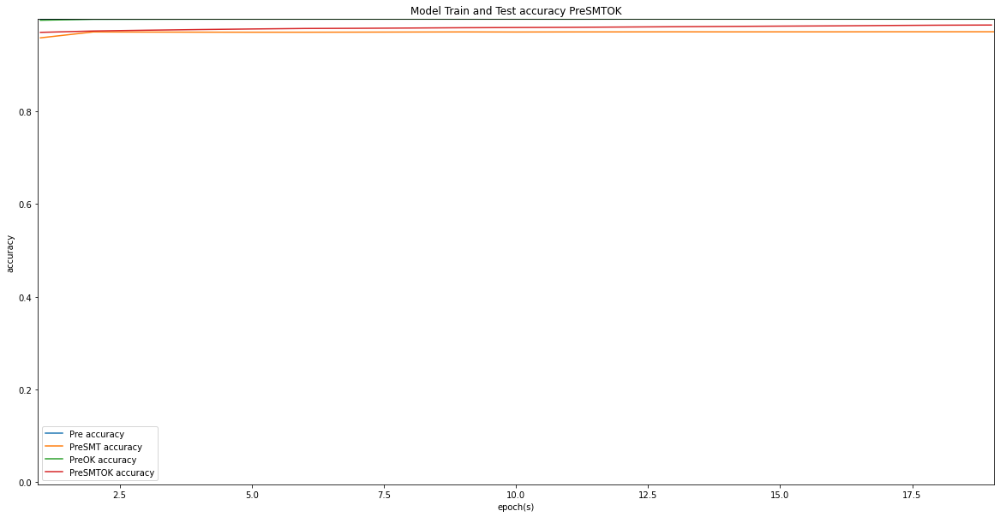

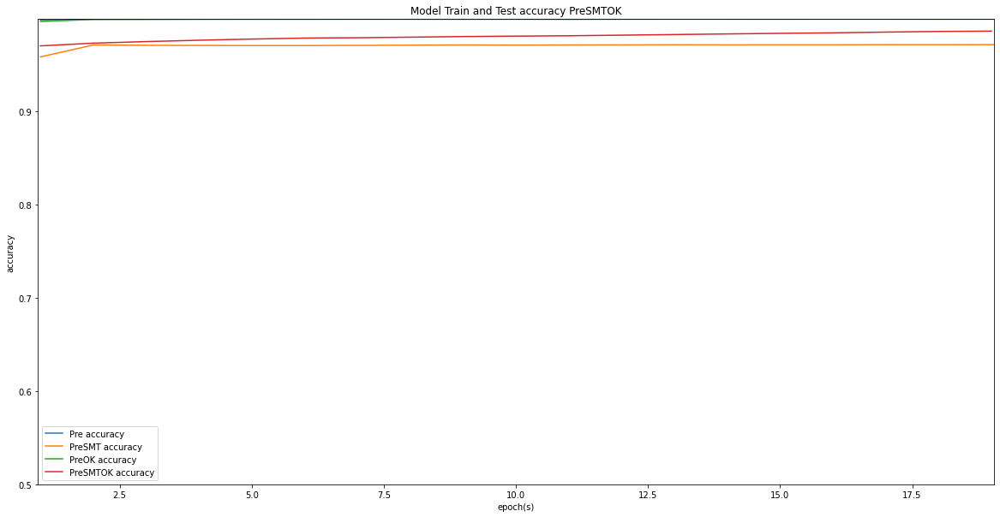

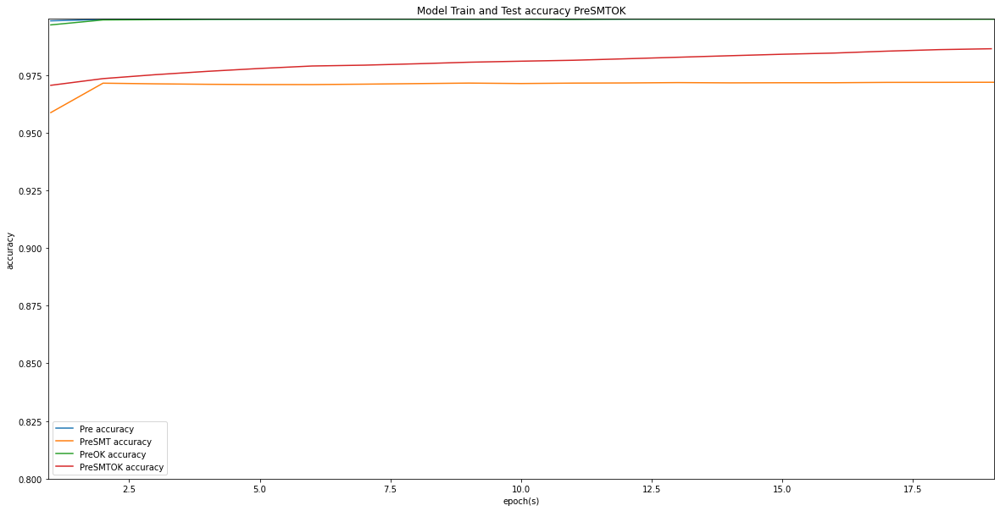

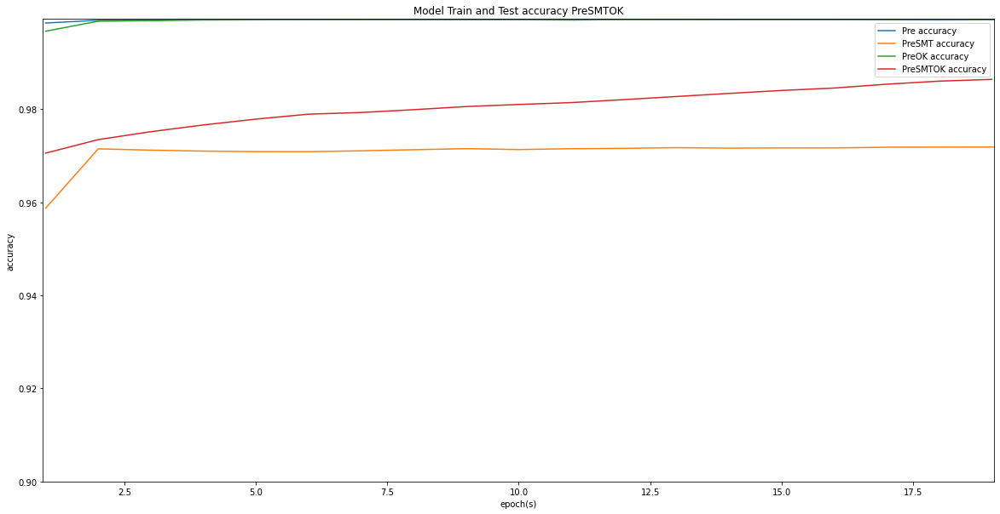

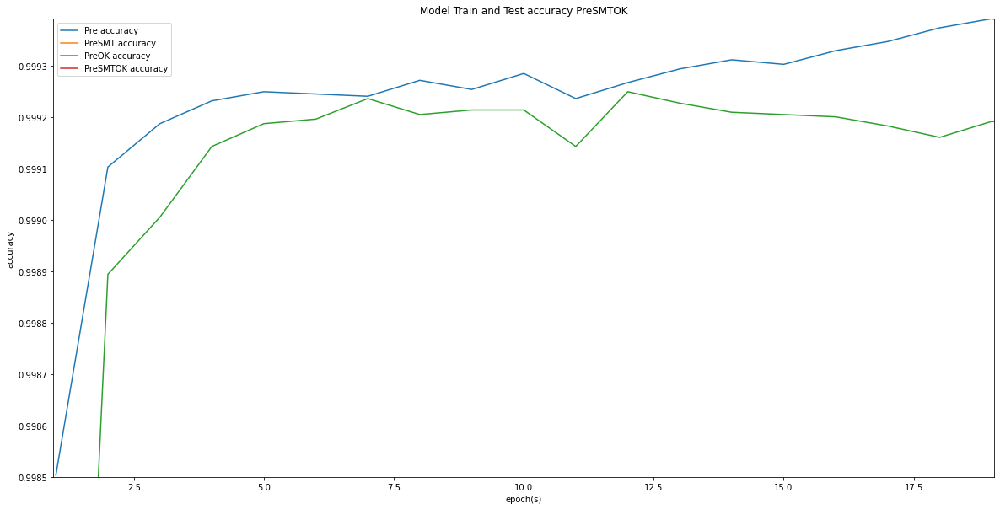

...

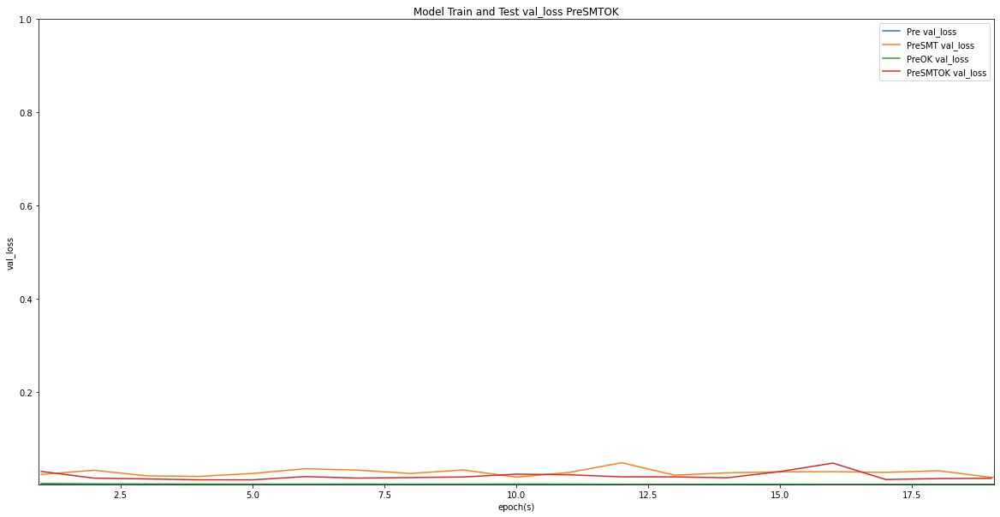

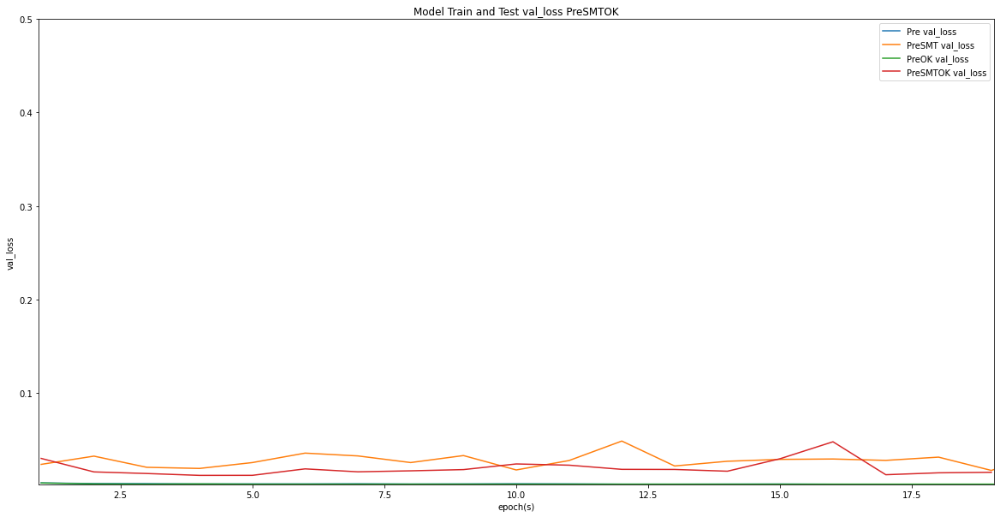

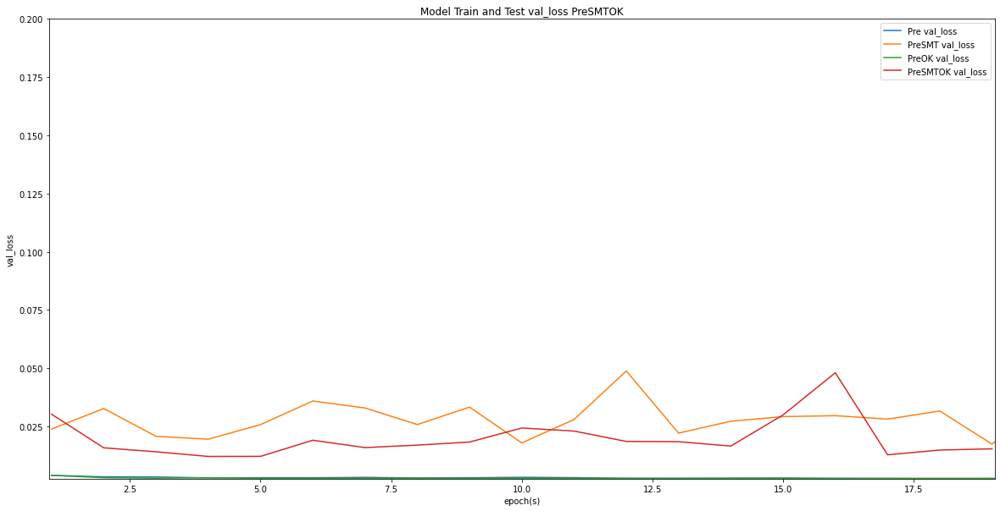

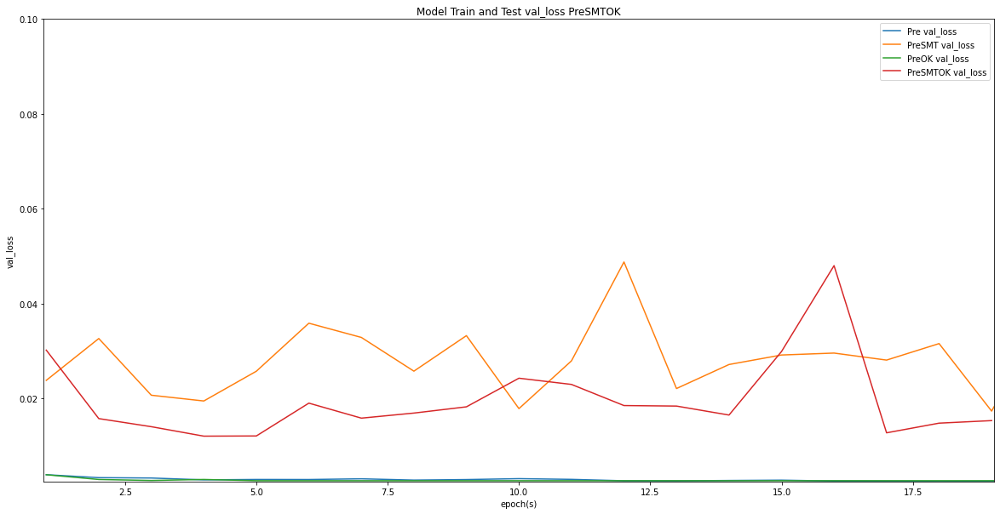

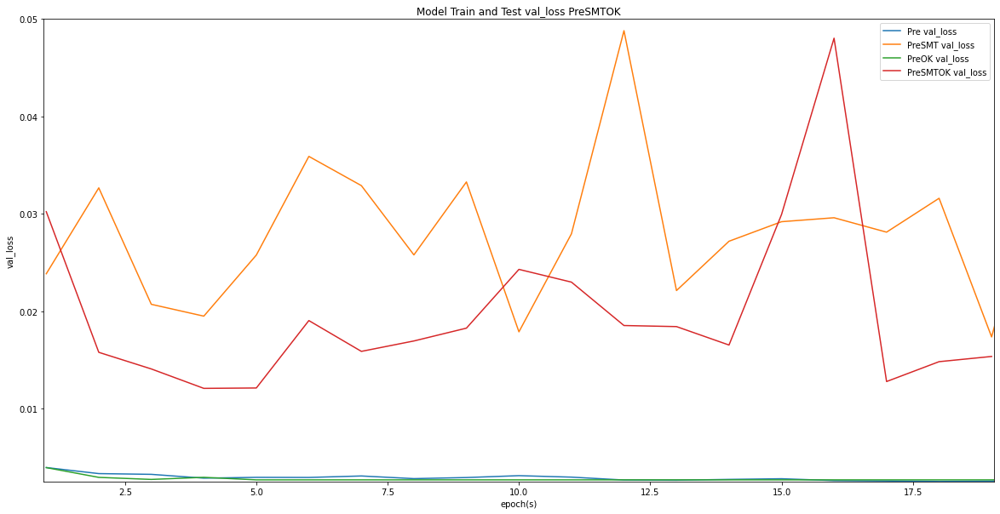

In [95]:
RESULTS_PREvsOPTK_ALL = [RESULTS[0],RESULTS[3],RESULTS[4],RESULTS[5]]
plot_model(RESULTS_PREvsOPTK_ALL,METRICS[0],DISPLAY_MODE[1])
plot_model(RESULTS_PREvsOPTK_ALL,METRICS[1],DISPLAY_MODE[1])
plot_model(RESULTS_PREvsOPTK_ALL,METRICS[2],DISPLAY_MODE[1])
plot_model(RESULTS_PREvsOPTK_ALL,METRICS[3],DISPLAY_MODE[1])

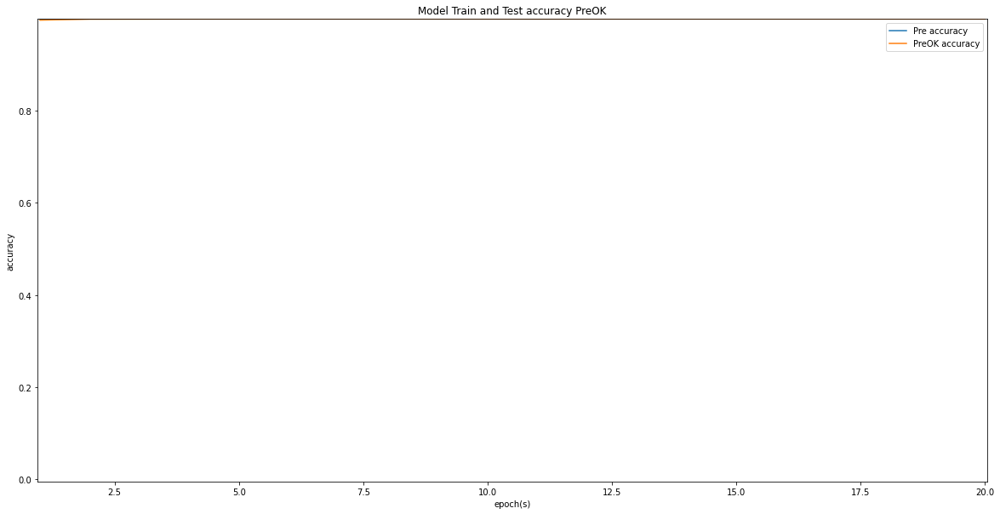

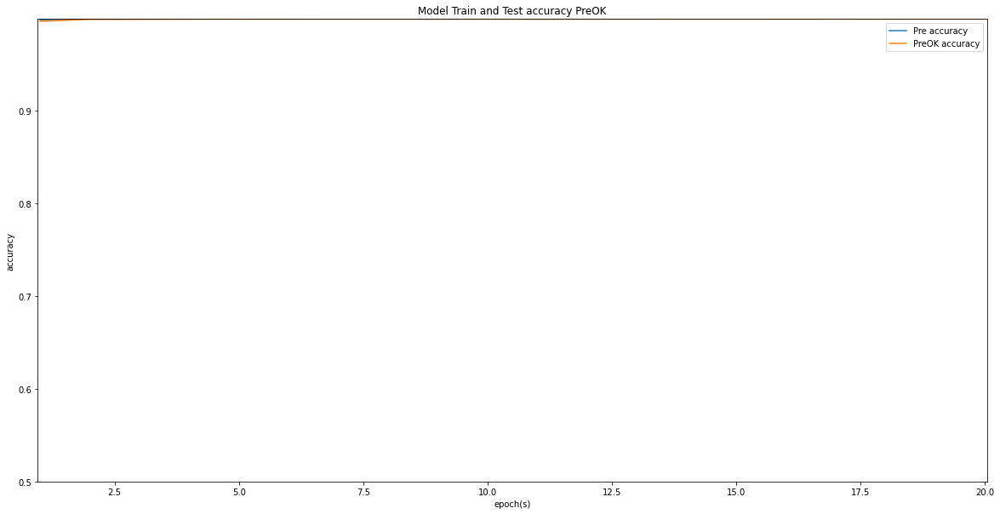

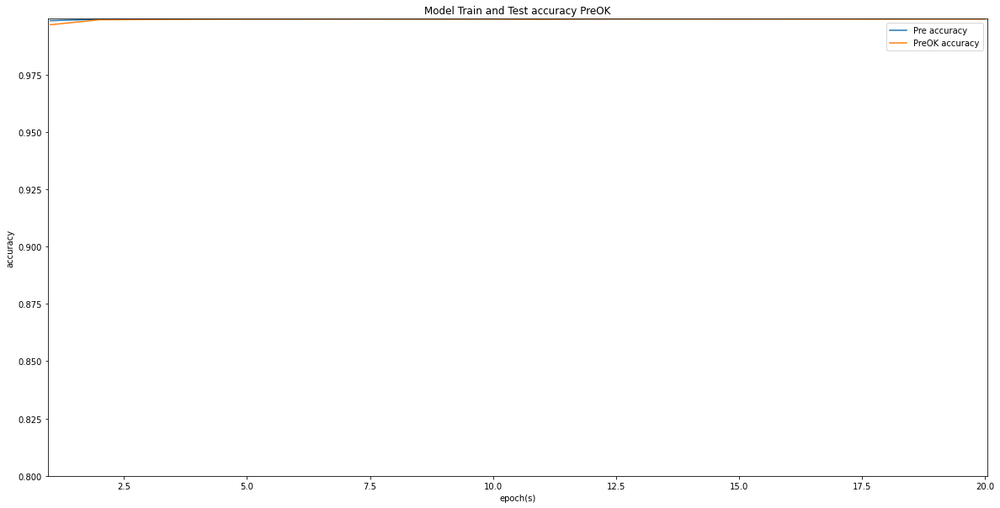

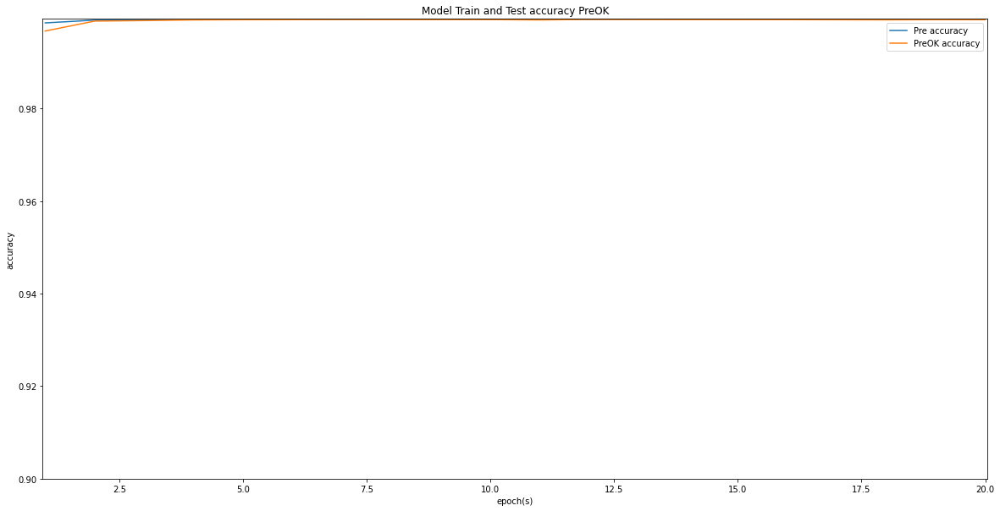

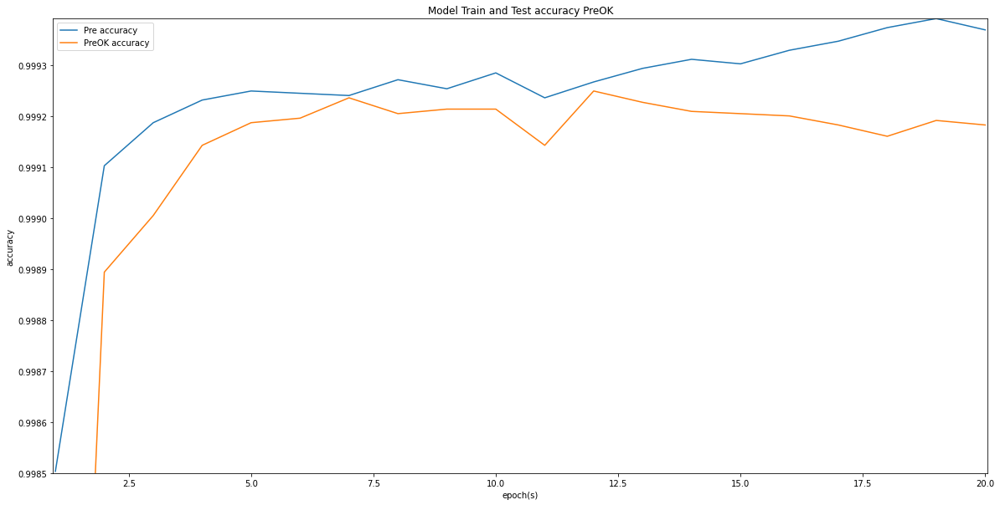

...

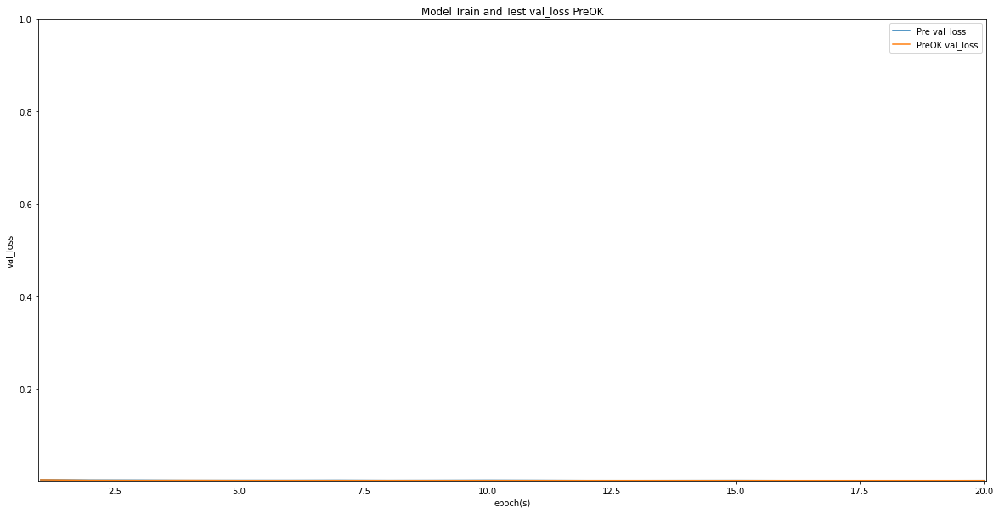

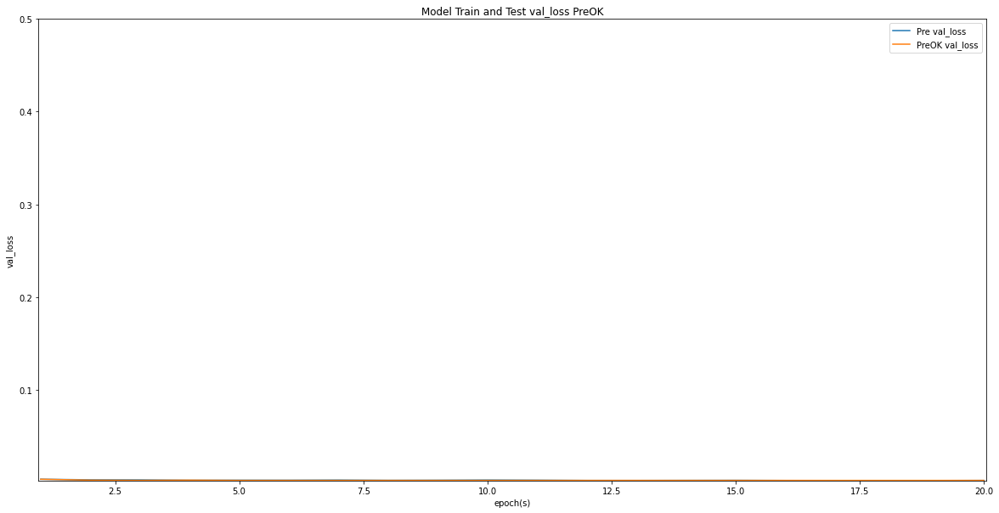

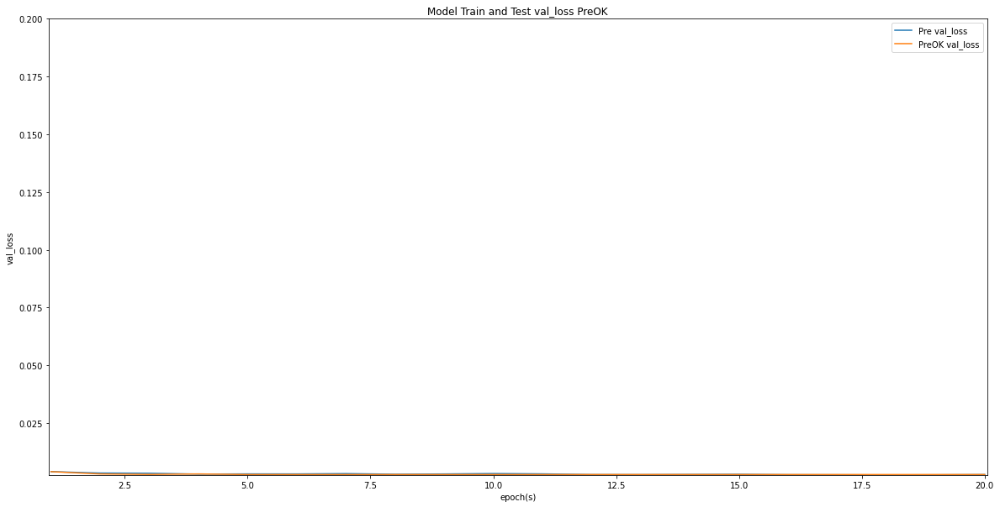

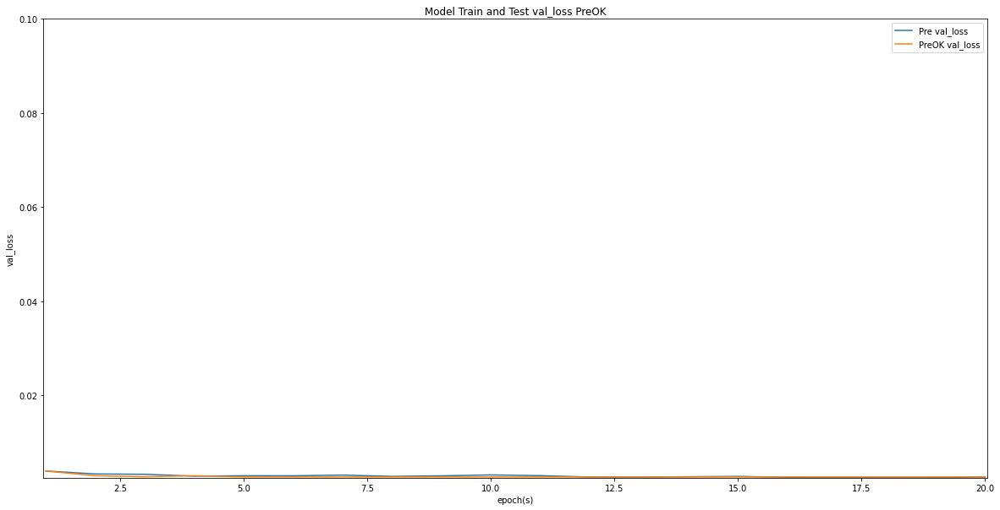

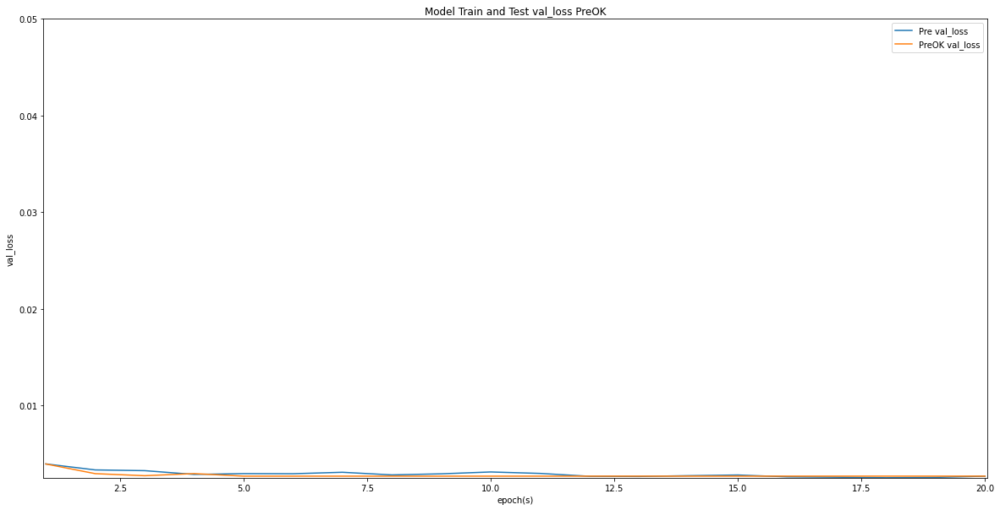

In [96]:
RESULTS_PREvsOPTK = [RESULTS[0],RESULTS[4]]
plot_model(RESULTS_PREvsOPTK,METRICS[0],DISPLAY_MODE[1])
plot_model(RESULTS_PREvsOPTK,METRICS[1],DISPLAY_MODE[1])
plot_model(RESULTS_PREvsOPTK,METRICS[2],DISPLAY_MODE[1])
plot_model(RESULTS_PREvsOPTK,METRICS[3],DISPLAY_MODE[1])

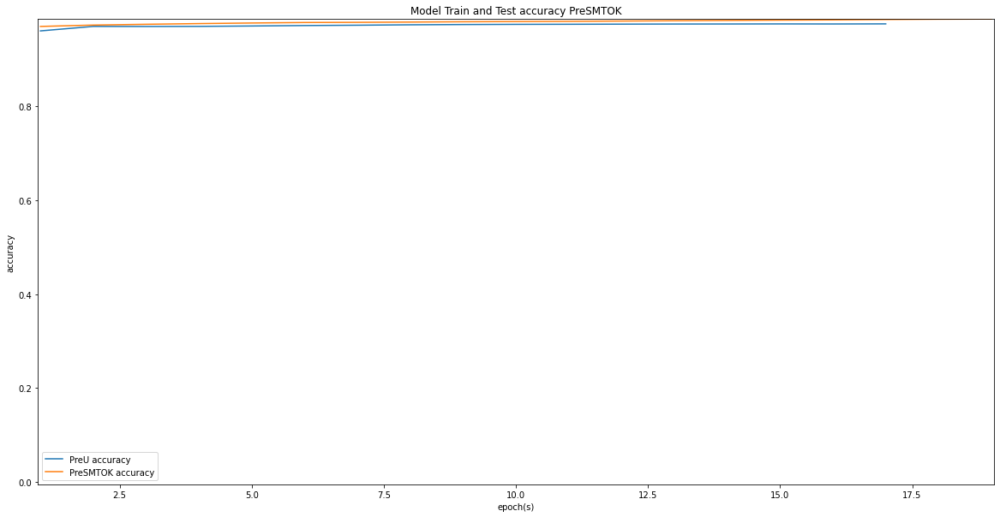

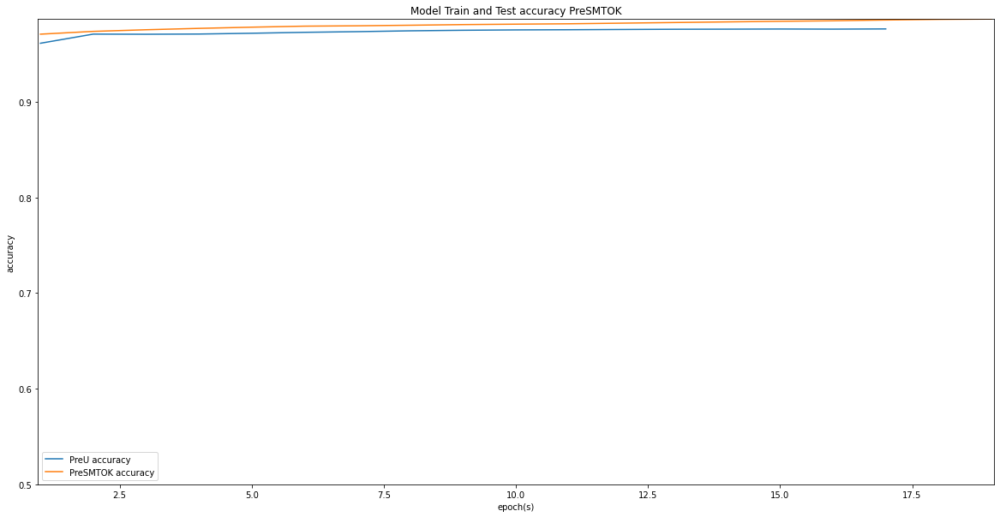

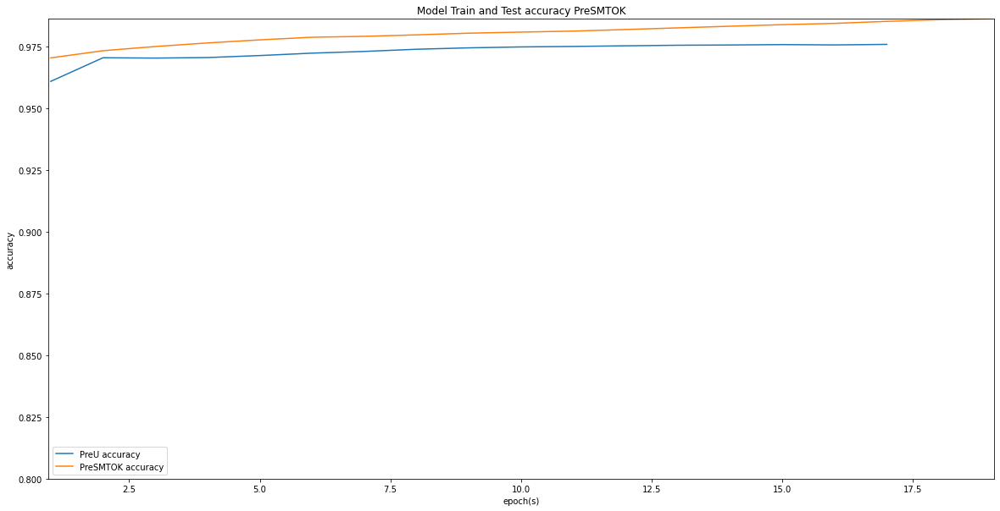

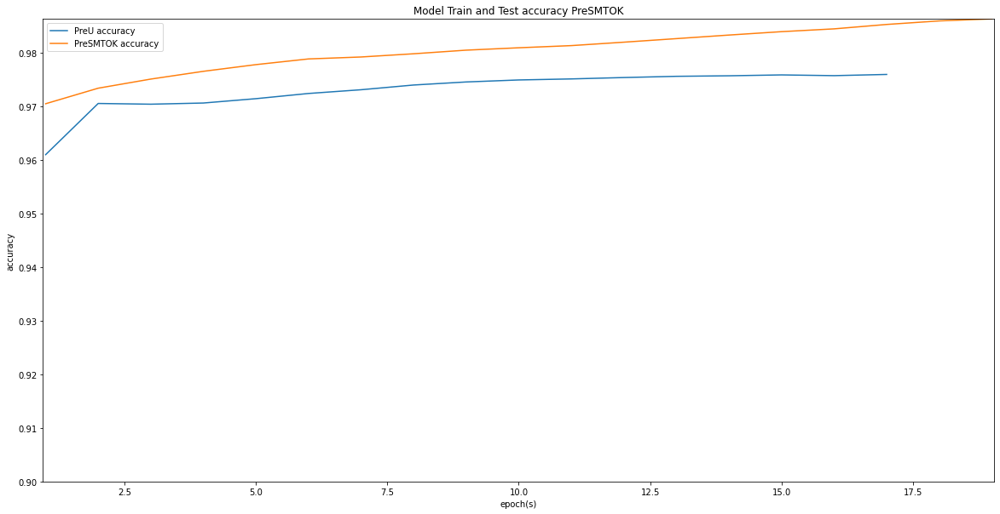

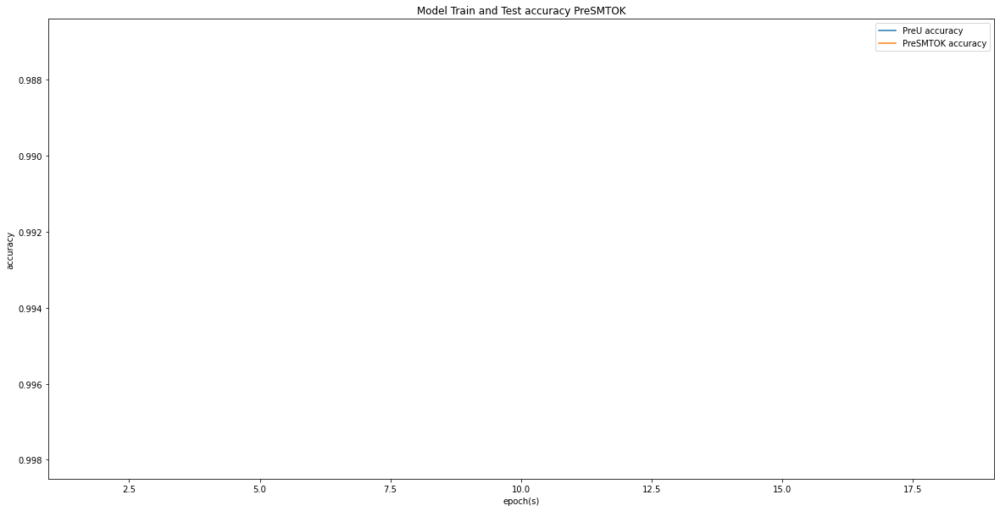

...

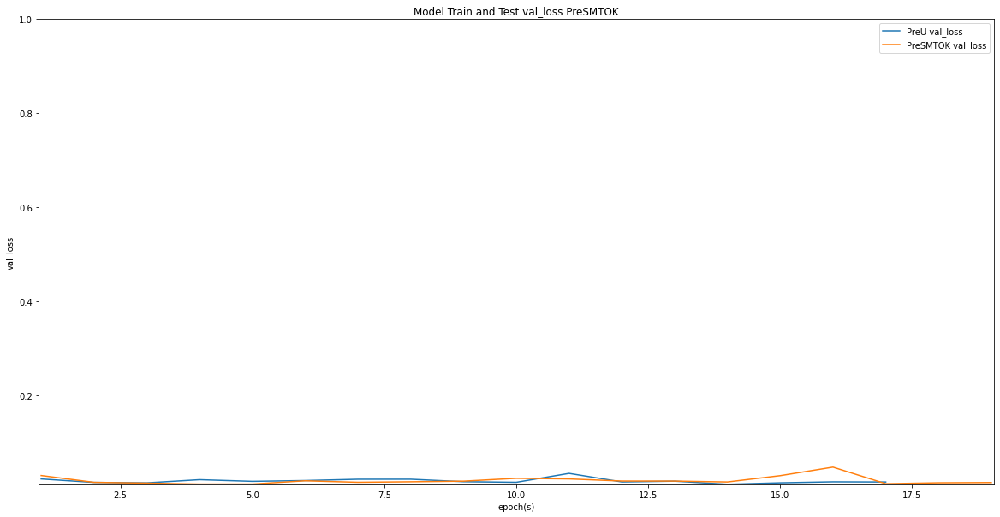

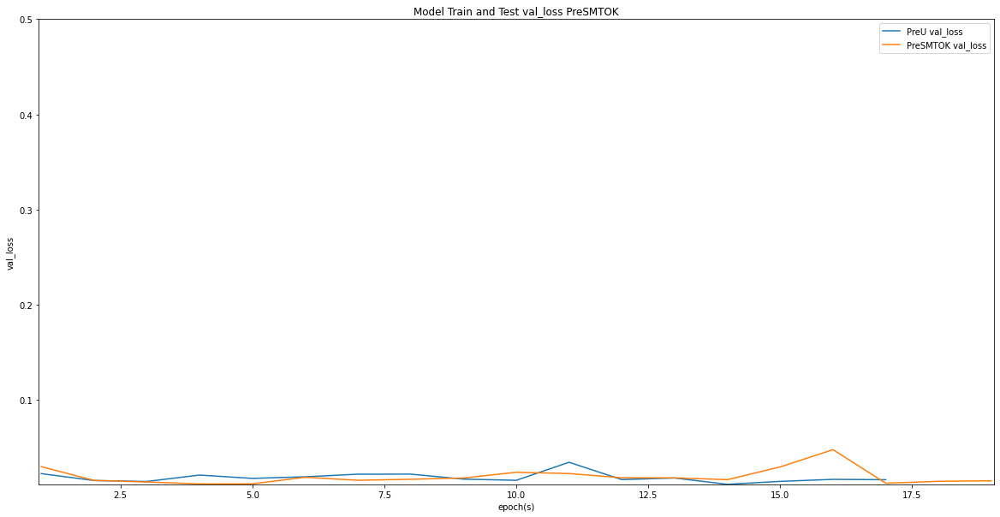

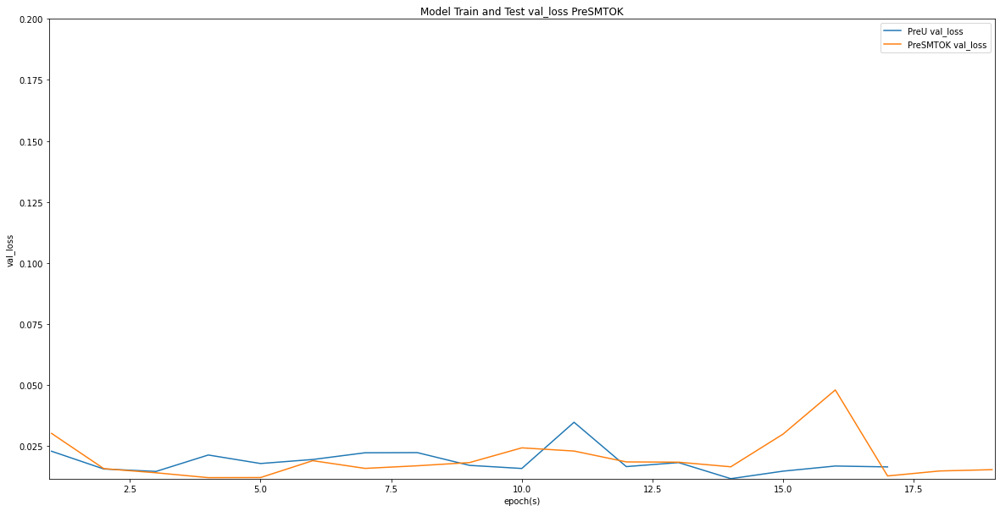

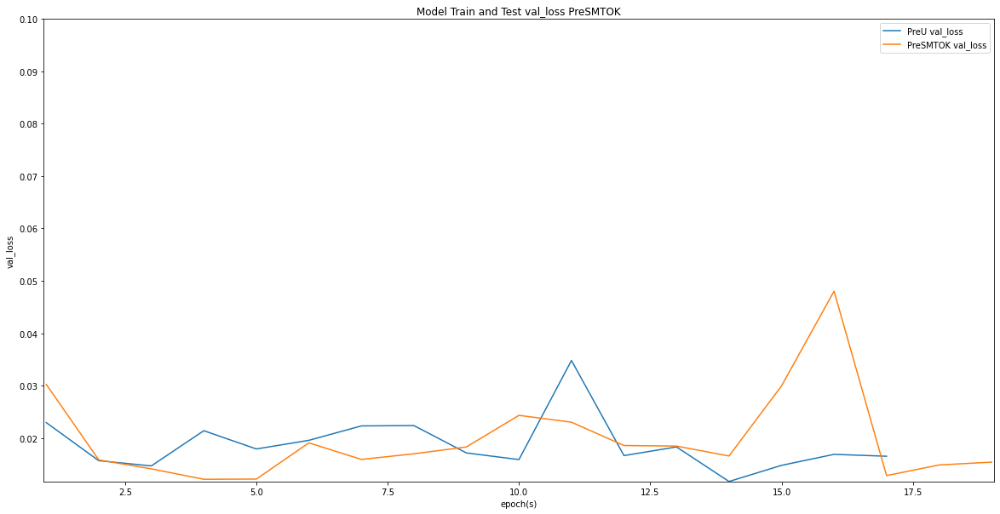

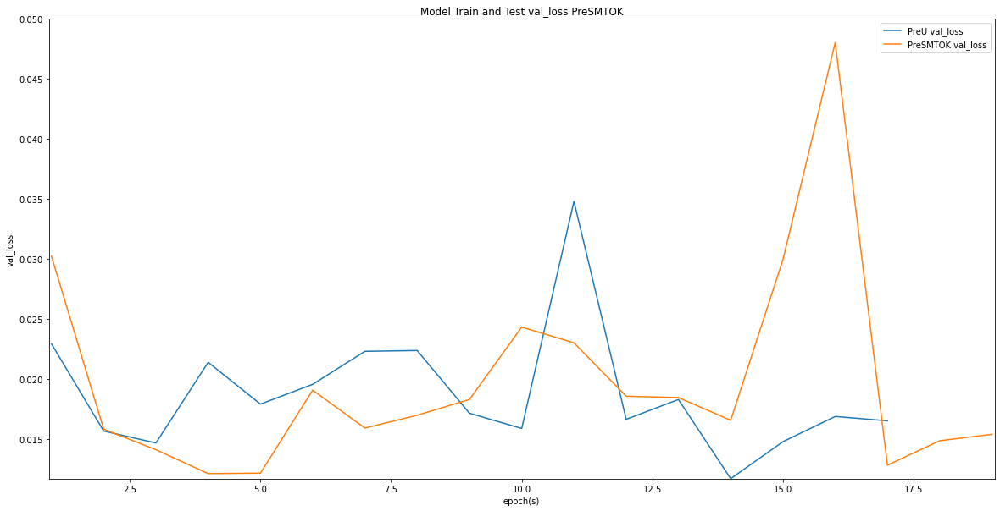

In [97]:
RESULTS_PRESMTvsOPTK = [RESULTS[1],RESULTS[5]]
plot_model(RESULTS_PRESMTvsOPTK,METRICS[0],DISPLAY_MODE[1])
plot_model(RESULTS_PRESMTvsOPTK,METRICS[1],DISPLAY_MODE[1])
plot_model(RESULTS_PRESMTvsOPTK,METRICS[2],DISPLAY_MODE[1])
plot_model(RESULTS_PRESMTvsOPTK,METRICS[3],DISPLAY_MODE[1])

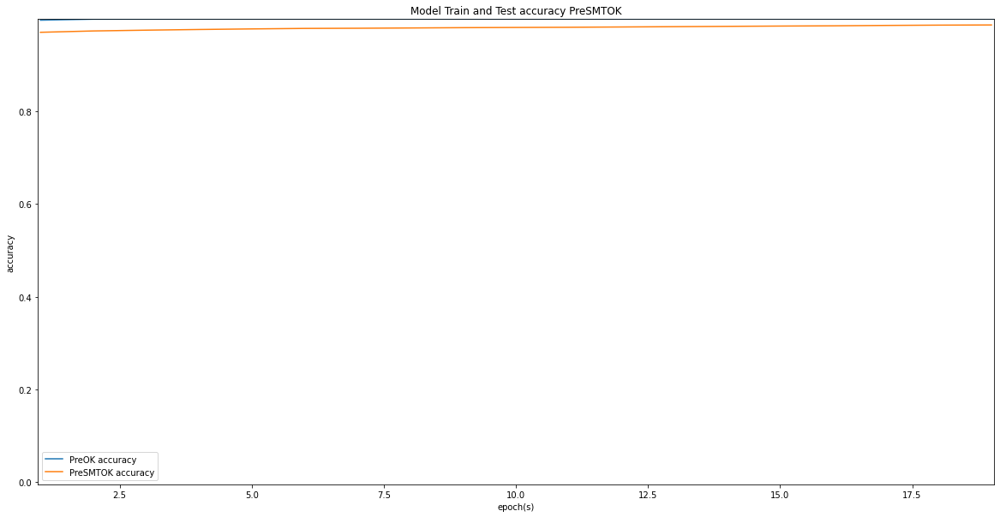

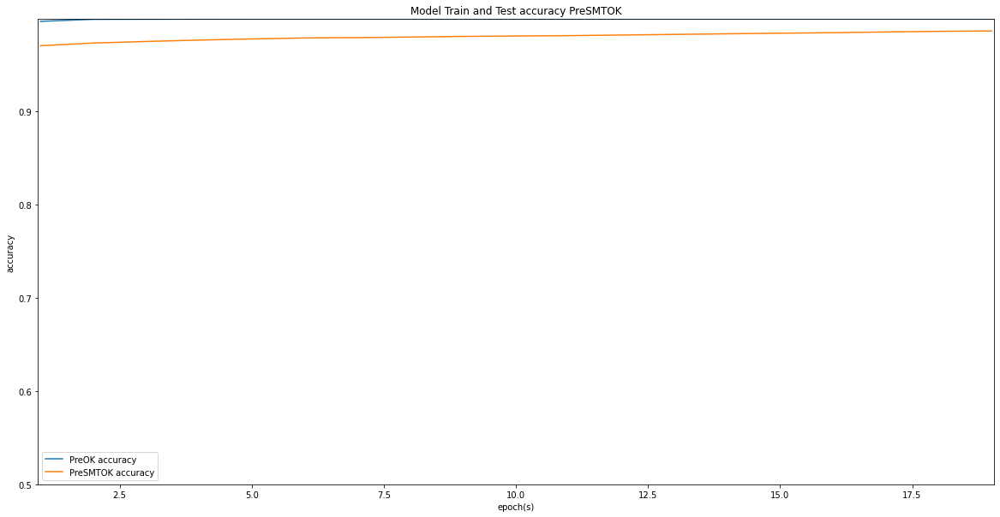

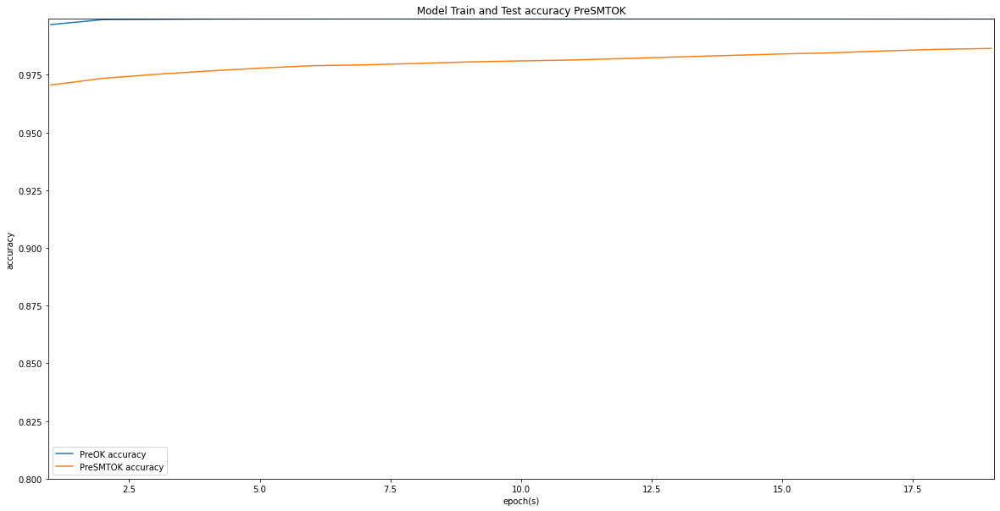

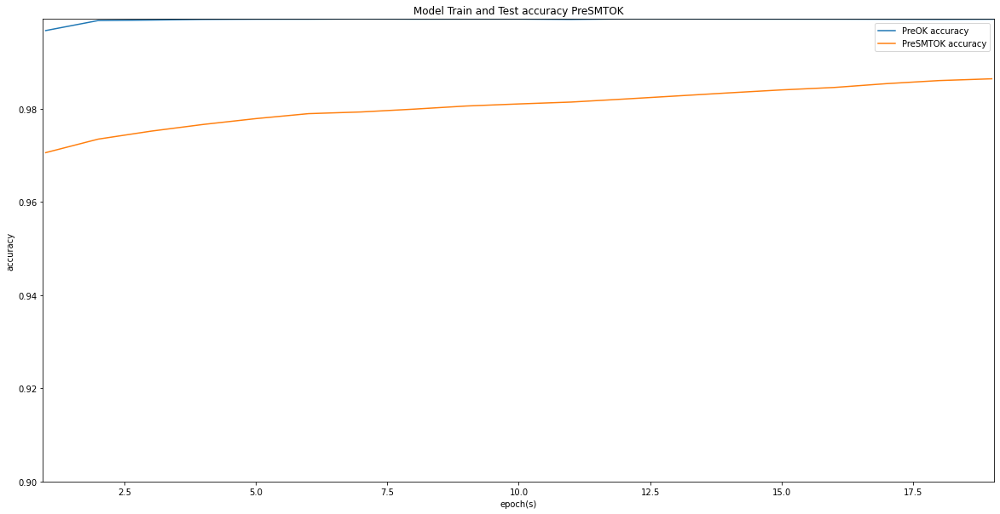

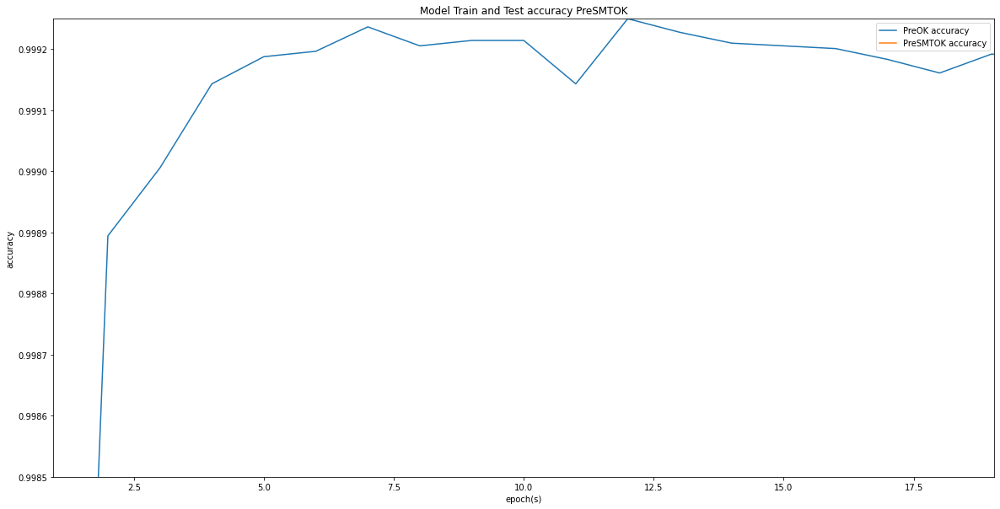

...

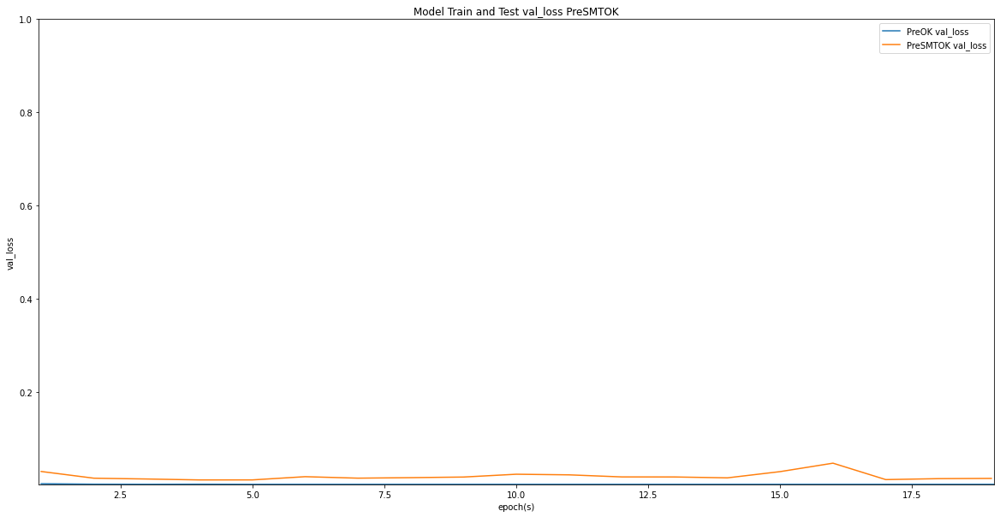

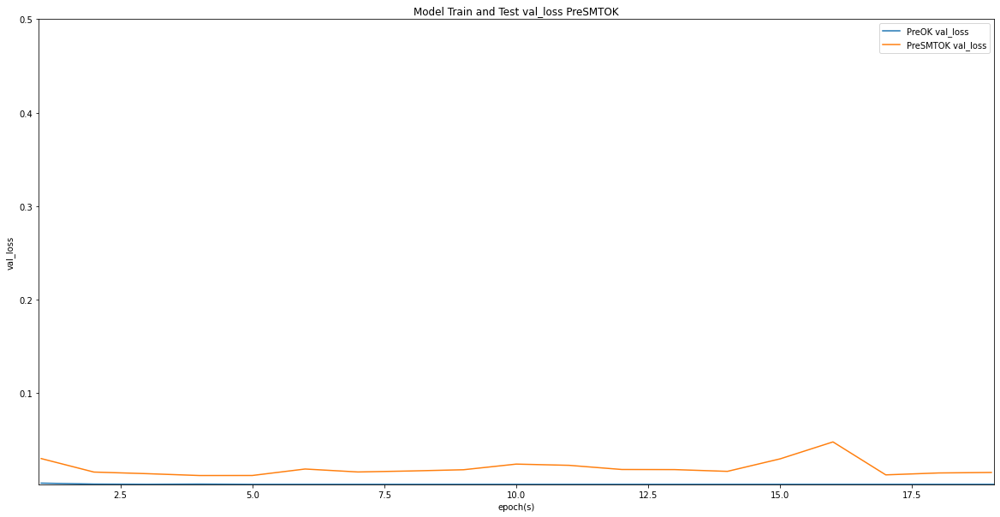

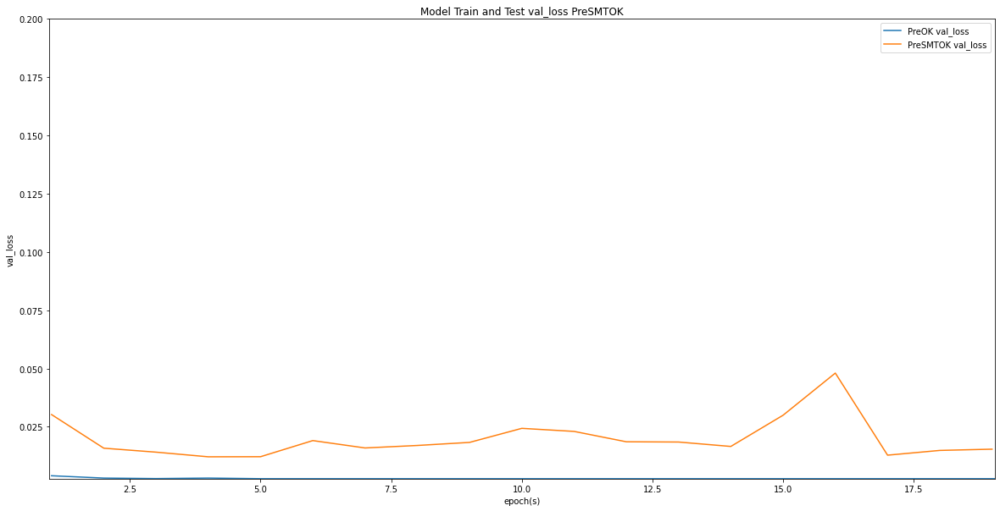

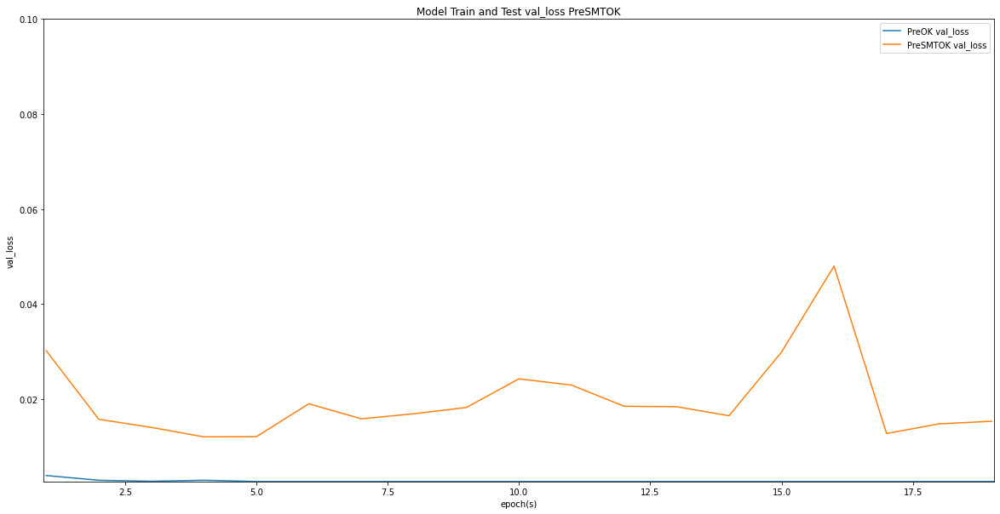

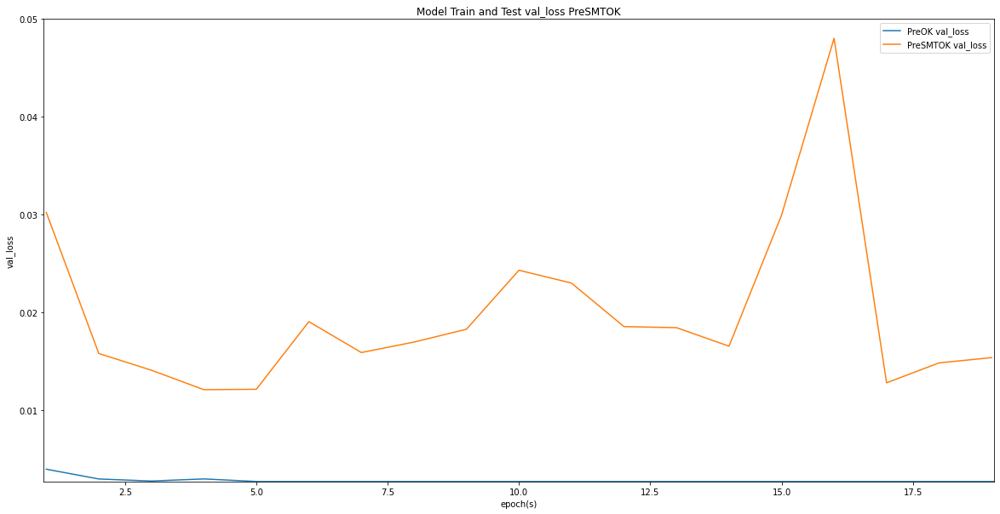

In [114]:
RESULTS_PREOPTKvsPRESMTOPTK = [RESULTS[4],RESULTS[5]]
plot_model(RESULTS_PREOPTKvsPRESMTOPTK,METRICS[0],DISPLAY_MODE[1])
plot_model(RESULTS_PREOPTKvsPRESMTOPTK,METRICS[1],DISPLAY_MODE[1])
plot_model(RESULTS_PREOPTKvsPRESMTOPTK,METRICS[2],DISPLAY_MODE[1])
plot_model(RESULTS_PREOPTKvsPRESMTOPTK,METRICS[3],DISPLAY_MODE[1])

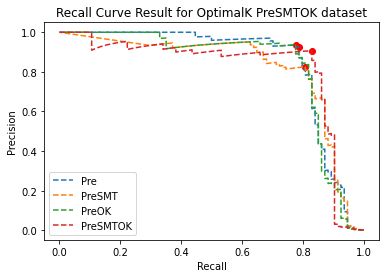

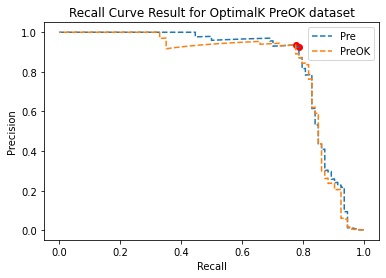

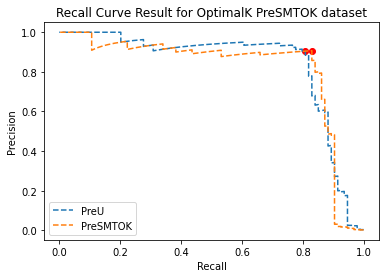

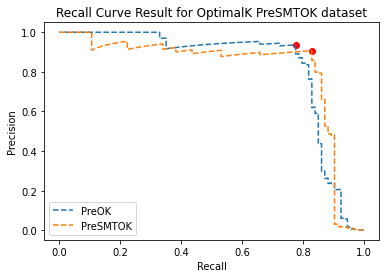

In [98]:
MODELS_PREvsOPTK_ALL = [MODELS[0],MODELS[3],MODELS[4],MODELS[5]]
MODELS_PREvsOPTK = [MODELS[0],MODELS[4]]
MODELS_PRESMTvsOPTK = [MODELS[1],MODELS[5]]
MODELS_PREOPTKvsPRESMTOPTK = [MODELS[4],MODELS[5]]
plot_AUC(MODELS_PREvsOPTK_ALL,X_pre_test,Y_pre_test)
plot_AUC(MODELS_PREvsOPTK,X_pre_test,Y_pre_test) 
plot_AUC(MODELS_PRESMTvsOPTK,X_pre_test,Y_pre_test)
plot_AUC(MODELS_PREOPTKvsPRESMTOPTK,X_pre_test,Y_pre_test)

###Selecting Precise Optimal Hyperparameter with Hyperband

#### Preprocess

In [99]:
tuner_pre         = tuner_build(model_buildHB,'preprocess')
tuner_train(tuner_pre,X_pre_train,Y_pre_train,X_pre_test,Y_pre_test)

INFO:tensorflow:Reloading Oracle from existing project drive/My Drive/CZ4032_Assignment/optimal/preprocess/oracle.json
INFO:tensorflow:Reloading Tuner from drive/My Drive/CZ4032_Assignment/optimal/preprocess/tuner0.json
INFO:tensorflow:Oracle triggered exit
Time Taken:  0.002 s


In [116]:
tuner_pre = tuner_build(model_buildHB,'preprocess')
bestHP_pre = tuner_pre.get_best_hyperparameters(num_trials = 1)[0]
preHP_HB = get_optimalHPP(bestHP_pre)

INFO:tensorflow:Reloading Oracle from existing project drive/My Drive/CZ4032_Assignment/optimal/preprocess/oracle.json
INFO:tensorflow:Reloading Tuner from drive/My Drive/CZ4032_Assignment/optimal/preprocess/tuner0.json
Optimal Neurons L1    =  256
Optimal Neurons L2    =  128
Optimal Neurons L3    =  64
No layer 4
No layer 5
No layer 6
Optimal Layers        =  3
Optimal Learning Rate =  0.001
Optimal DropOut Rate  =  0.0


In [117]:
#RESULTS2 = [] # Further testing purpose
#MODELS2 = []
model_run_optHB(X_pre_train,Y_pre_train,X_pre_test,Y_pre_test, MODELS, RESULTS,MODEL_PreOptHB, RESULT_PreOptHB,CHECKPOINTS_preOPTHB, IDS[6],preHP_HB)

------------------------------
<Optimal Hyperparameter Used>
Number of Neurons per Layer =  [256, 128, 64]
Number of Layer             =  3
Decay Value                 =  0
Batch Size                  =  512
Dropout                     =  0.0
------------------------------
Building Model...
Added 0
Added 1
Added 2
Total Time Taken: 77.77s
Average Time Taken per epoch: 3889ms
Total epoch: 20
Completed Trained Model
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 256)               5120      
_________________________________________________________________
dropout_1 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_5 (Dense)              (None, 128)               32896     
_________________________________________________________________
dropout_2 (Dropout)          (No

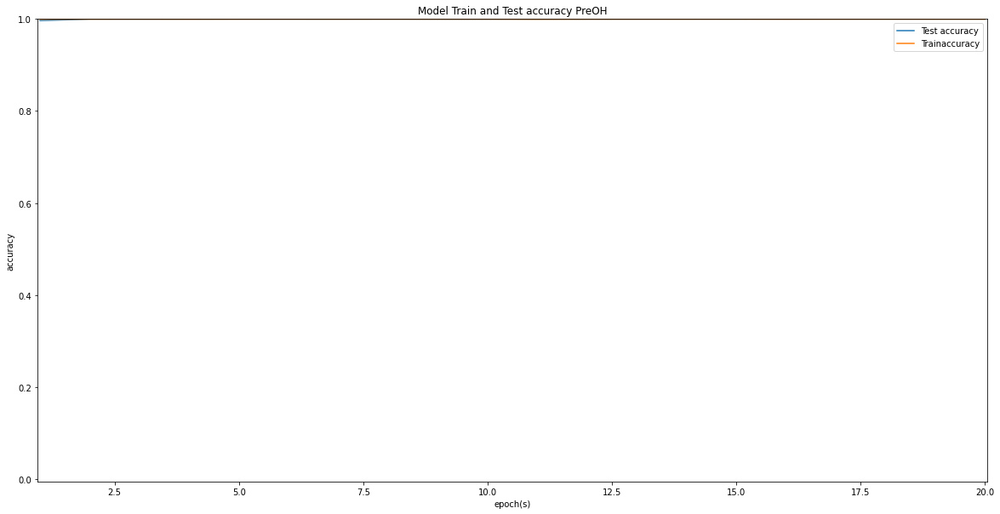

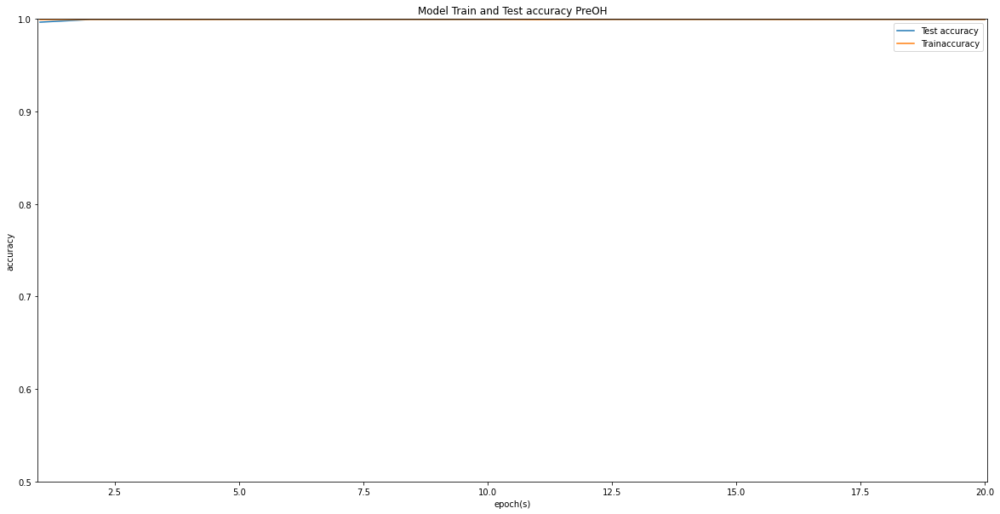

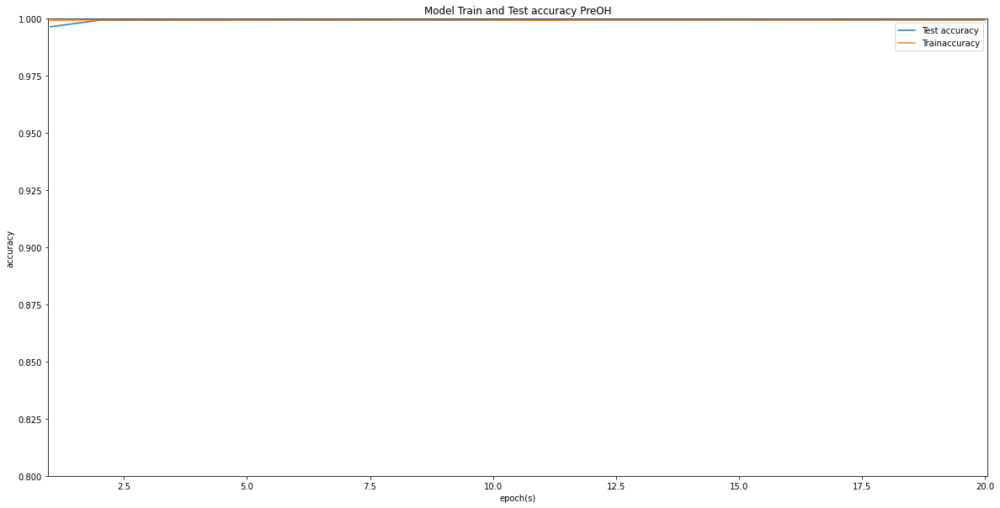

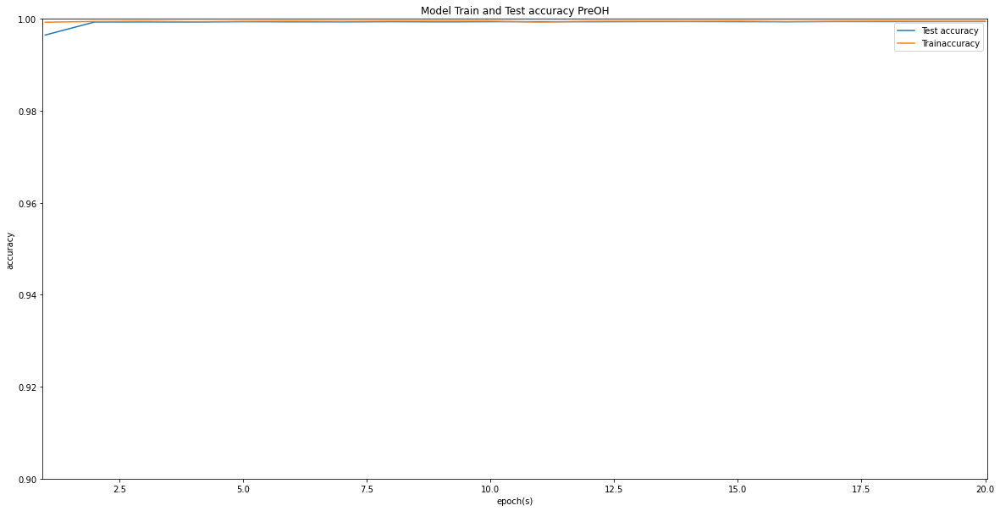

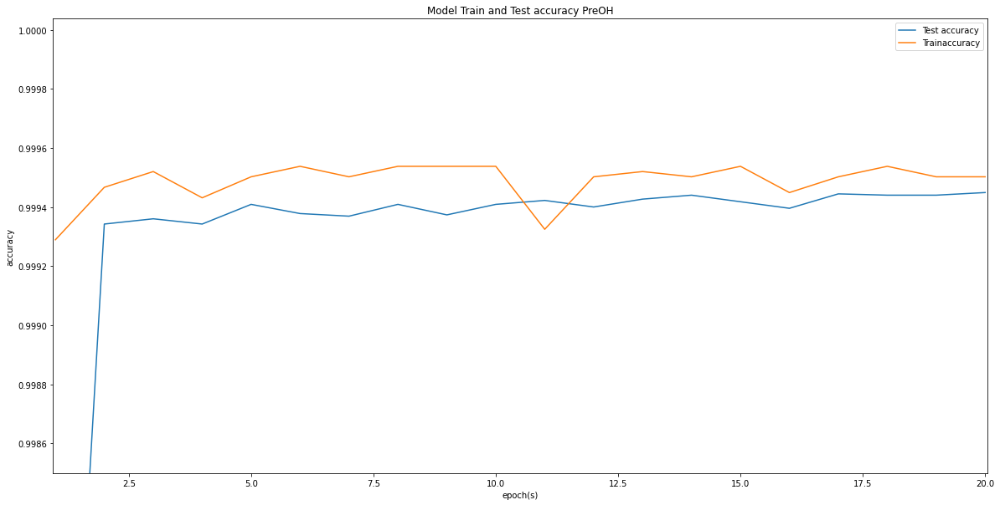

Classification Report for OptimalHB PreOH Dataset
              precision    recall  f1-score   support

         0.0     0.9996    0.9999    0.9998     56199
         1.0     0.9024    0.7872    0.8409        94

    accuracy                         0.9995     56293
   macro avg     0.9510    0.8935    0.9203     56293
weighted avg     0.9995    0.9995    0.9995     56293


Best Threshold           =  0.7109
F-Score                  =  0.8457
Best Recall Score        =  0.7872
Best Precision Score     =  0.9136
Area under the PRC Curve =  0.8601
Accuracy Score           =  0.9995


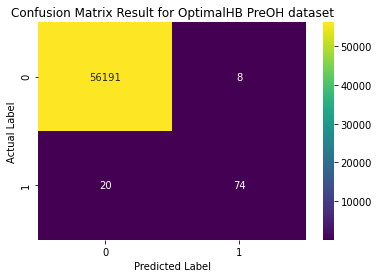

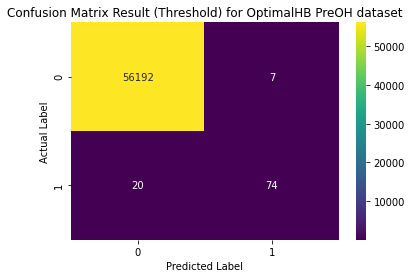

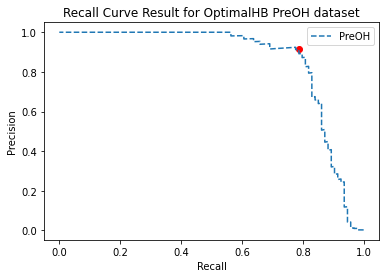

In [102]:
plot_model(RESULT_PreOptHB,METRICS[0],DISPLAY_MODE[0])
plot_evaluation(MODEL_PreOptHB, X_pre_test, Y_pre_test)

#### Preprocess SMOTE

In [103]:
tuner_preSMT         = tuner_build(model_buildHB,'preprocessSMT')
tuner_train(tuner_preSMT,X_pre_trainSMT,Y_pre_trainSMT,X_pre_test,Y_pre_test)

INFO:tensorflow:Reloading Oracle from existing project drive/My Drive/CZ4032_Assignment/optimal/preprocessSMT/oracle.json
INFO:tensorflow:Reloading Tuner from drive/My Drive/CZ4032_Assignment/optimal/preprocessSMT/tuner0.json
INFO:tensorflow:Oracle triggered exit
Time Taken:  0.001 s


In [118]:
tuner_preSMT = tuner_build(model_buildHB,'preprocessSMT')
bestHP_preSMT = tuner_preSMT.get_best_hyperparameters(num_trials = 1)[0]
preSMTHP_HB = get_optimalHP(bestHP_preSMT)

INFO:tensorflow:Reloading Oracle from existing project drive/My Drive/CZ4032_Assignment/optimal/preprocessSMT/oracle.json
INFO:tensorflow:Reloading Tuner from drive/My Drive/CZ4032_Assignment/optimal/preprocessSMT/tuner0.json
Optimal Neurons L1    =  5
Optimal Layers        =  1
Optimal Learning Rate =  0.0001
Optimal DropOut Rate  =  0.2


In [119]:
model_run_optHB(X_pre_trainSMT,Y_pre_trainSMT,X_pre_test,Y_pre_test, MODELS, RESULTS,MODEL_PreSMTOptHB, RESULT_PreSMTOptHB,CHECKPOINTS_preSMTOPTHB, IDS[7],preSMTHP_HB)

------------------------------
<Optimal Hyperparameter Used>
Number of Neurons per Layer =  [5]
Number of Layer             =  1
Decay Value                 =  0
Batch Size                  =  32
Dropout                     =  0.2
------------------------------
Building Model...
Added 0
Total Time Taken: 158.52s
Average Time Taken per epoch: 9325ms
Total epoch: 17
Completed Trained Model
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 5)                 100       
_________________________________________________________________
dropout_1 (Dropout)          (None, 5)                 0         
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 6         
Total params: 106
Trainable params: 106
Non-trainable params: 0
_____________________________________________________________

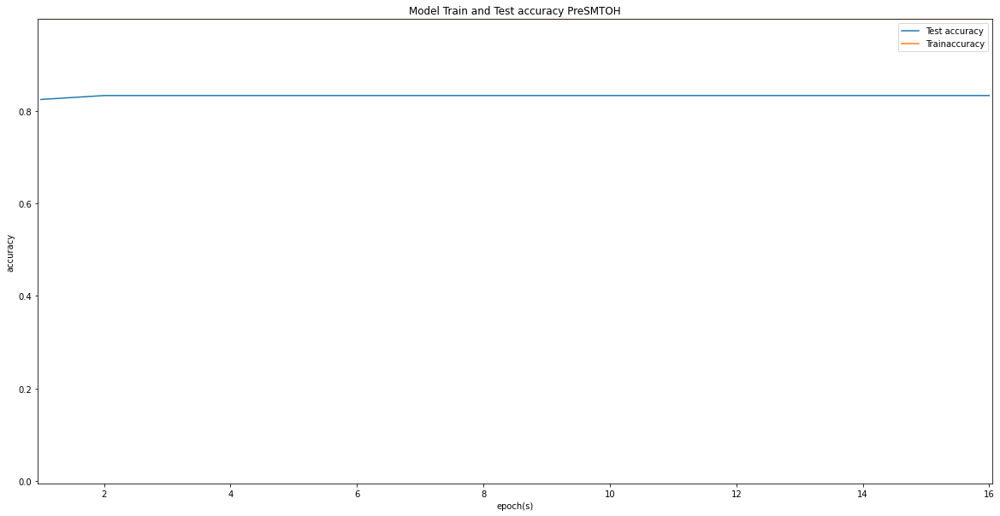

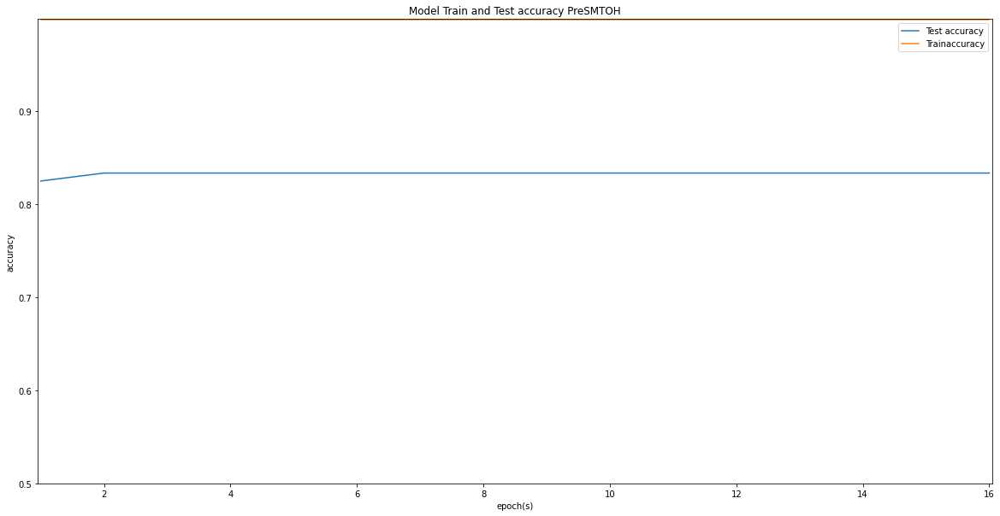

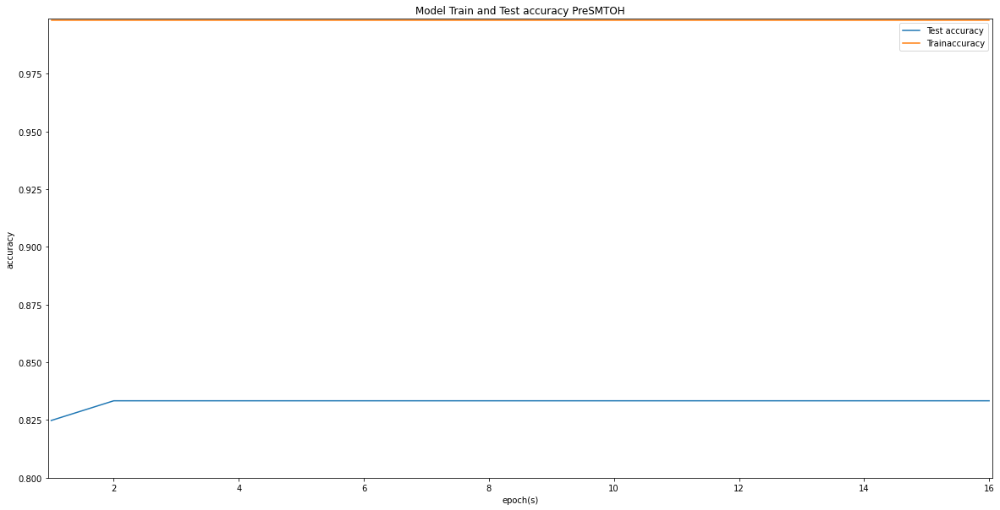

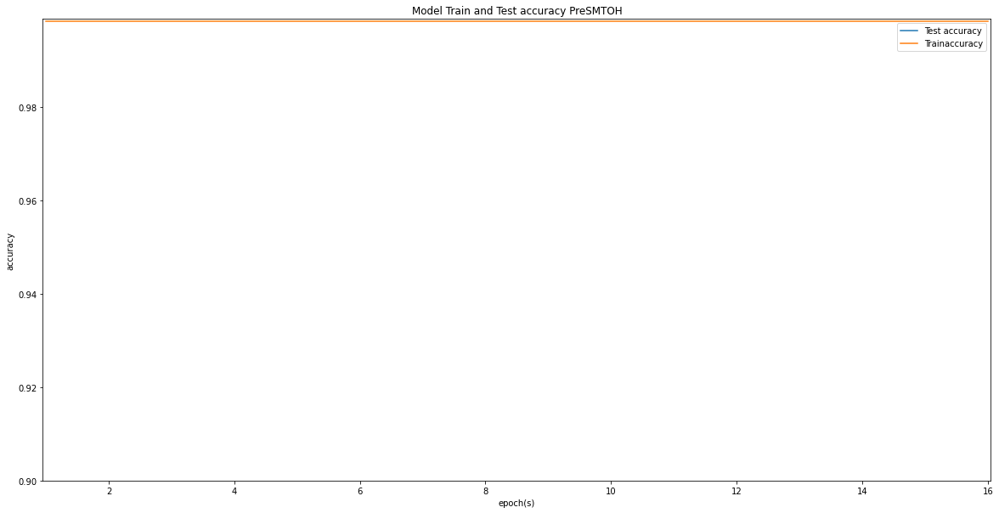

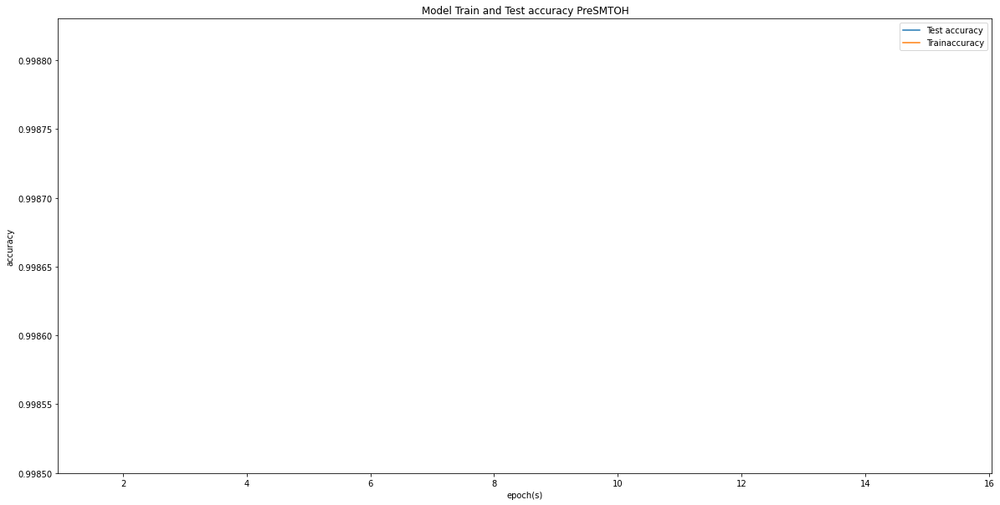

Classification Report for OptimalHB PreSMTOH Dataset


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

         0.0     0.9983    1.0000    0.9992     56199
         1.0     0.0000    0.0000    0.0000        94

    accuracy                         0.9983     56293
   macro avg     0.4992    0.5000    0.4996     56293
weighted avg     0.9967    0.9983    0.9975     56293


Best Threshold           =  0.4653
F-Score                  =  0.4985
Best Recall Score        =  0.8723
Best Precision Score     =  0.3489
Area under the PRC Curve =  0.6033
Accuracy Score           =  0.9983


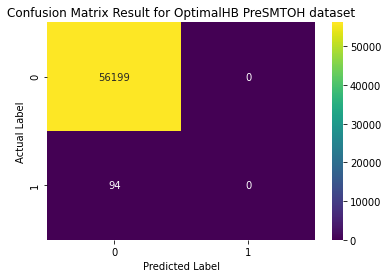

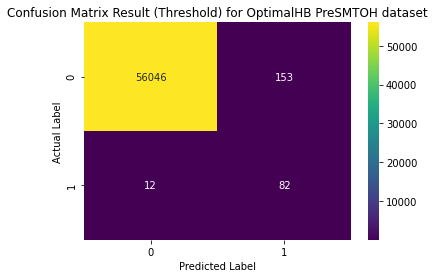

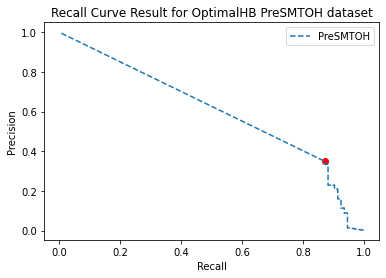

In [106]:
plot_model(RESULT_PreSMTOptHB,METRICS[0],DISPLAY_MODE[0])
plot_evaluation(MODEL_PreSMTOptHB, X_pre_test, Y_pre_test)

Classification Report for OptimalHB PreOH Dataset
              precision    recall  f1-score   support

         0.0     0.9997    0.9998    0.9998     56199
         1.0     0.8941    0.8085    0.8492        94

    accuracy                         0.9995     56293
   macro avg     0.9469    0.9042    0.9245     56293
weighted avg     0.9995    0.9995    0.9995     56293


Best Threshold           =  0.5381
F-Score                  =  0.8492
Best Recall Score        =  0.8085
Best Precision Score     =  0.8941
Area under the PRC Curve =  0.8601
Accuracy Score           =  0.9995
Classification Report for OptimalHB PreSMTOH Dataset
              precision    recall  f1-score   support

         0.0     0.9998    0.9948    0.9973     56199
         1.0     0.2240    0.8936    0.3582        94

    accuracy                         0.9947     56293
   macro avg     0.6119    0.9442    0.6778     56293
weighted avg     0.9985    0.9947    0.9962     56293


Best Threshold           =  0.9

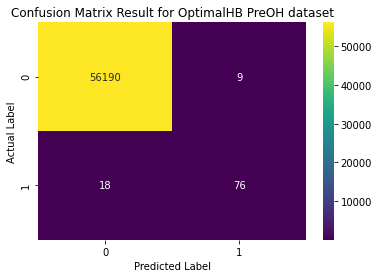

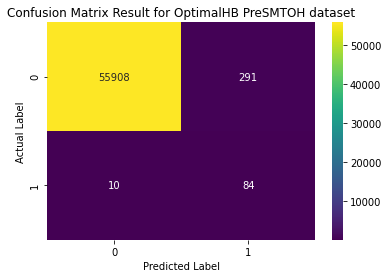

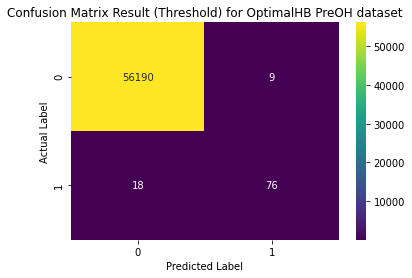

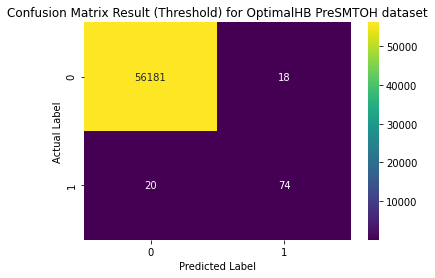

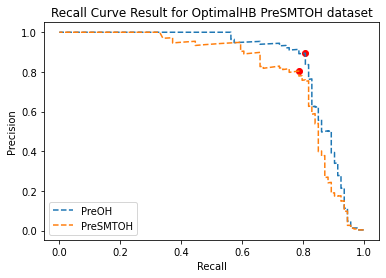

In [120]:
#plot_evaluation(MODELS2, X_pre_test, Y_pre_test)

#### Evaluation

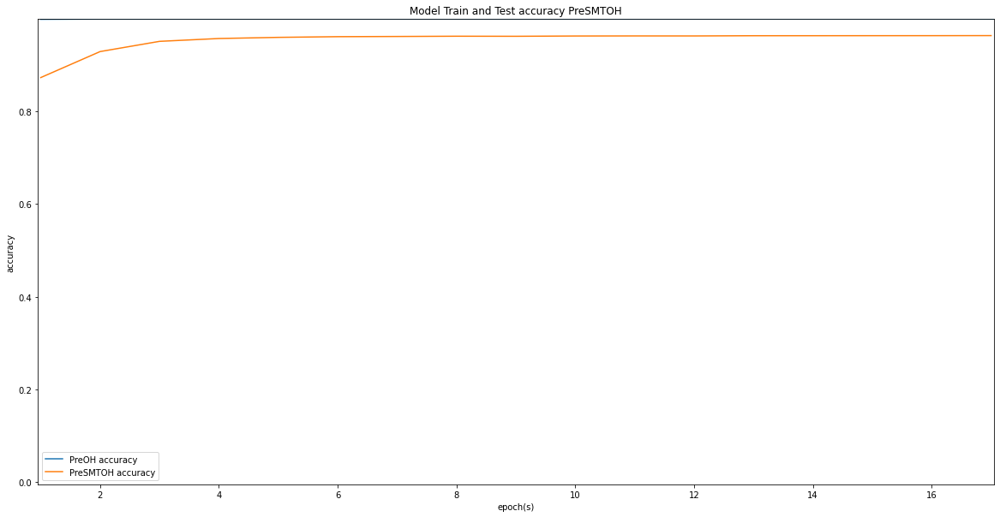

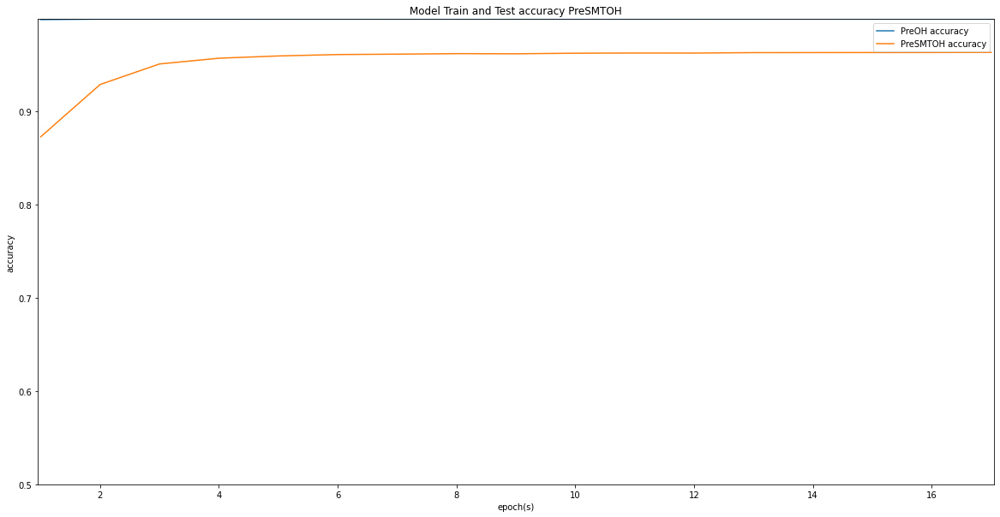

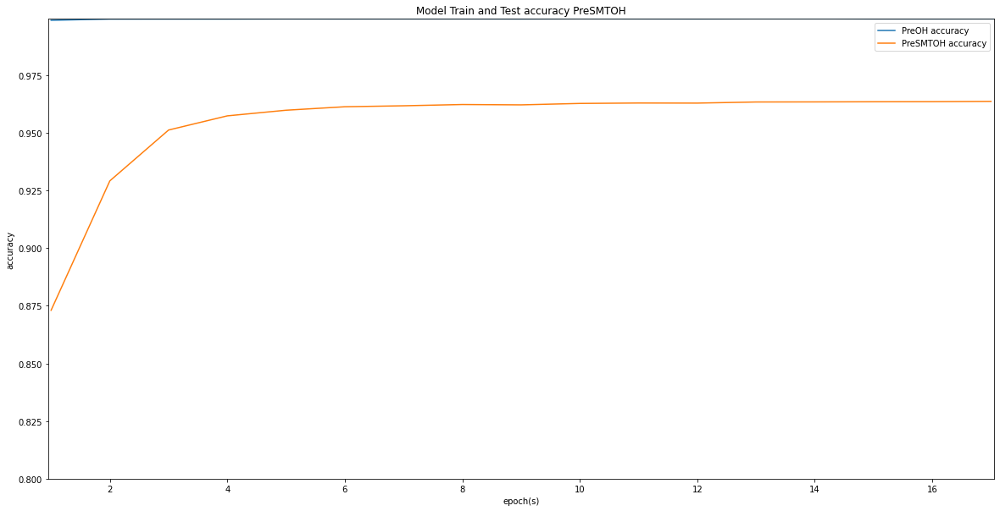

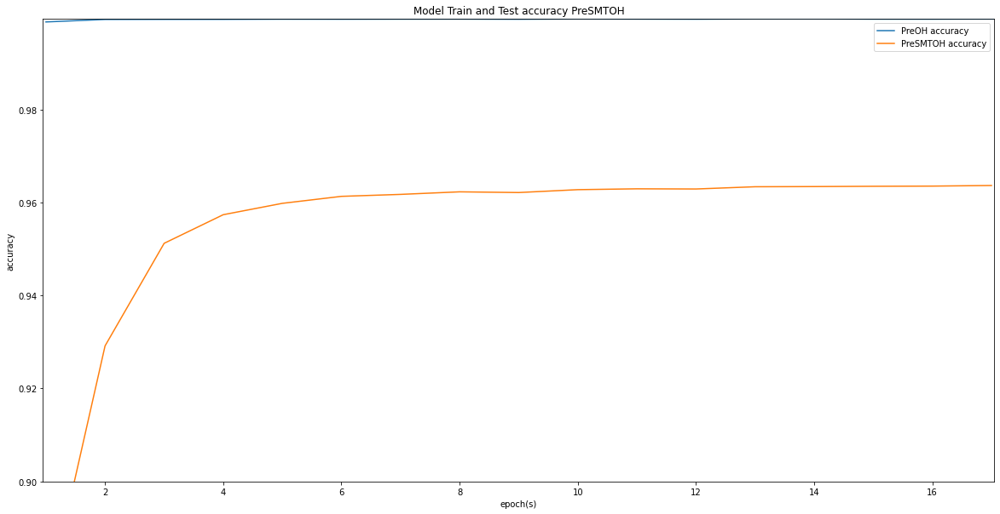

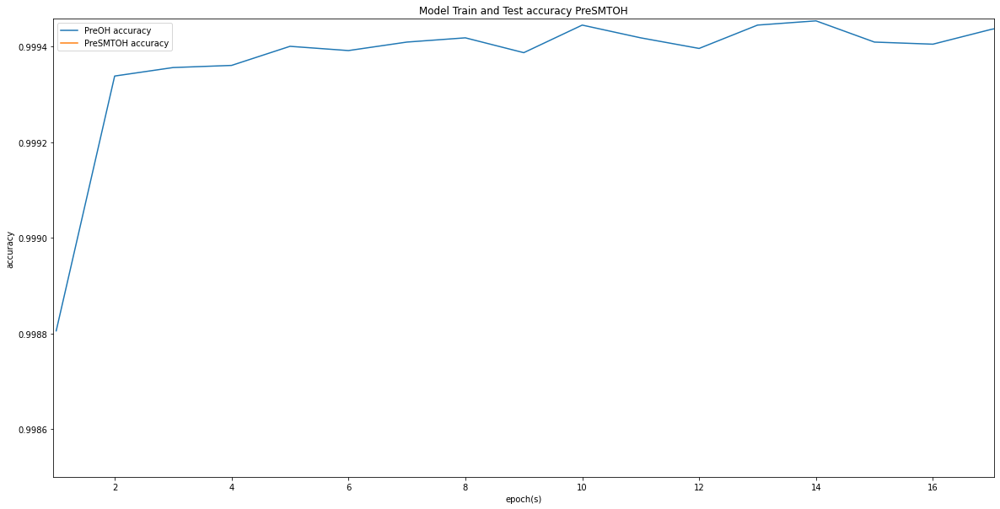

...

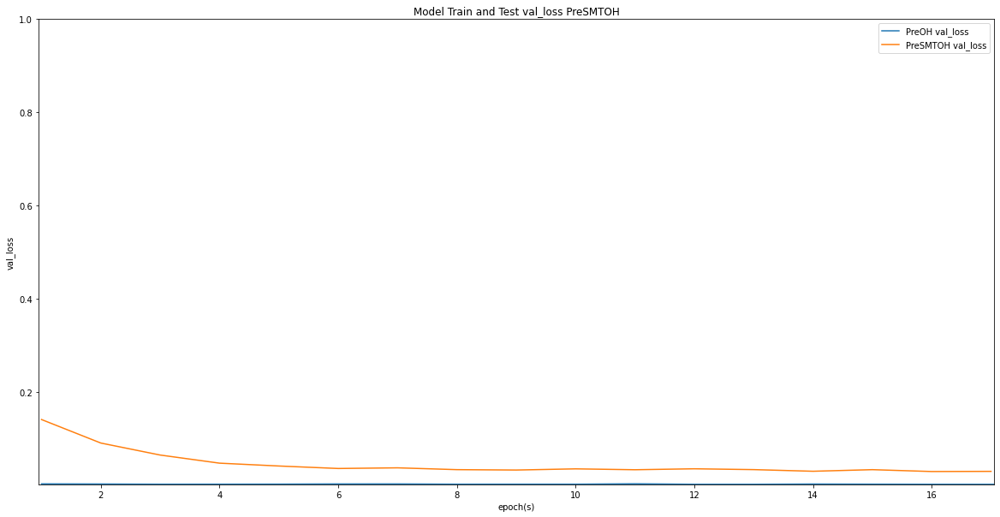

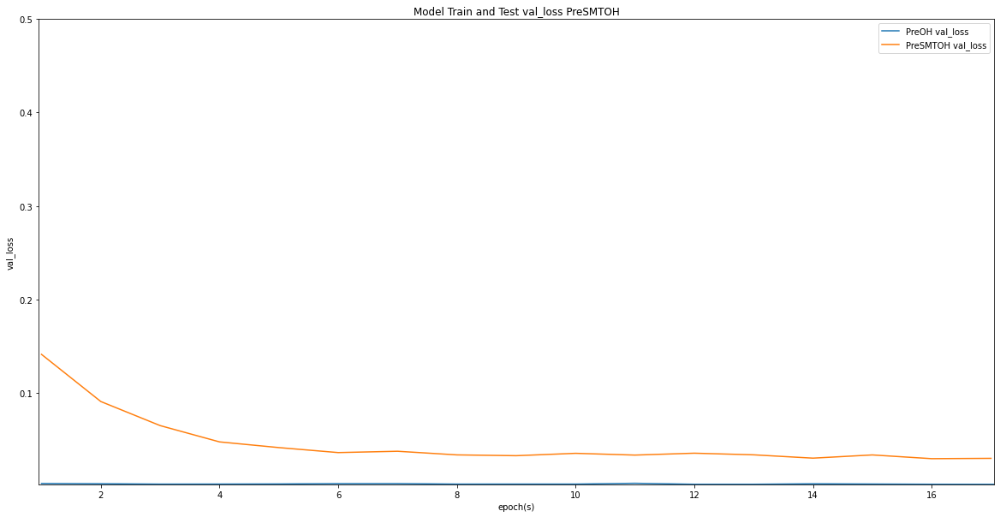

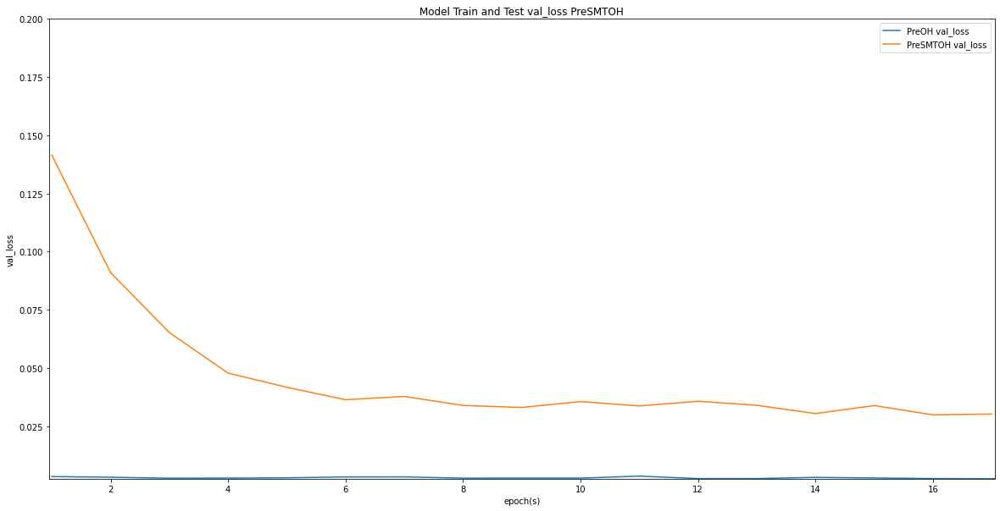

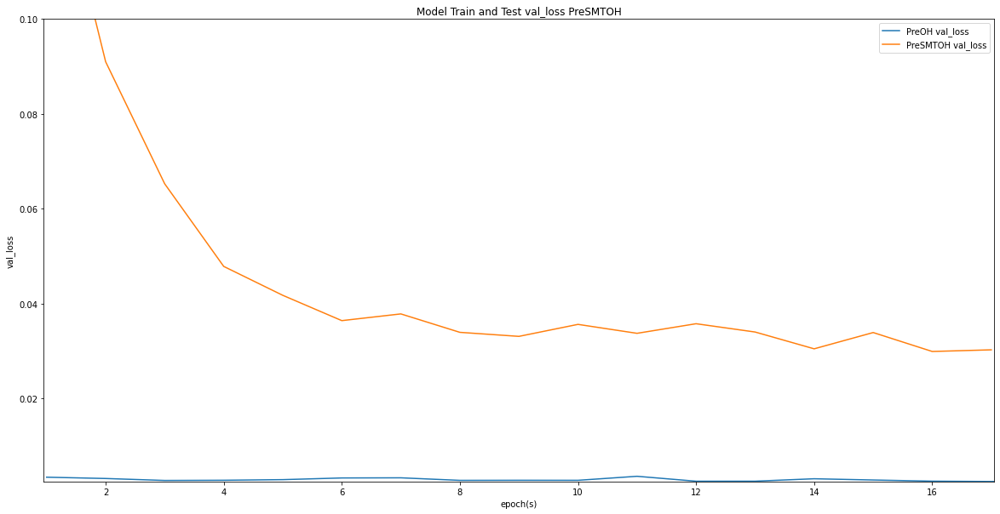

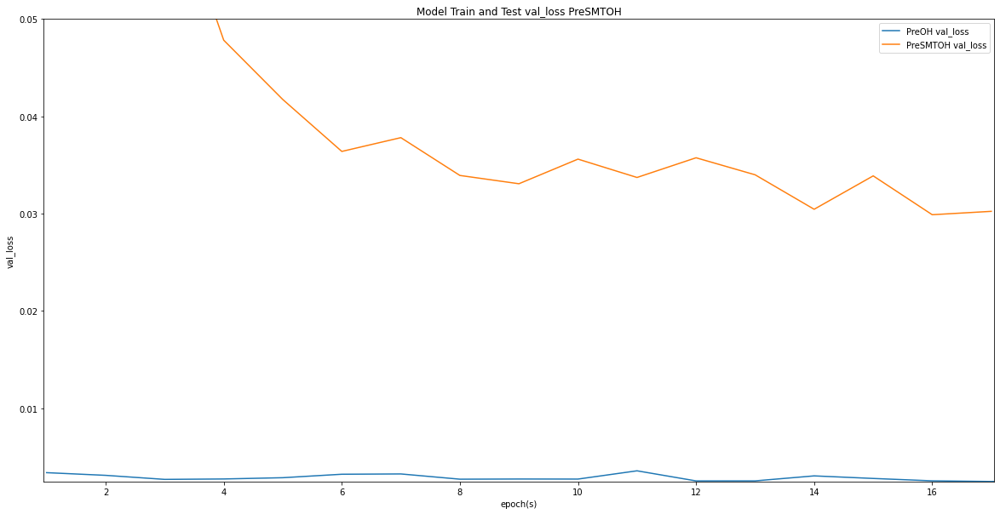

In [124]:
#RESULTS_PREOPTHBvsPRESMTOPTHB2 = [RESULTS2[0],RESULTS2[1]]
#plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB2,METRICS[0],DISPLAY_MODE[1])
#plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB2,METRICS[1],DISPLAY_MODE[1])
#plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB2,METRICS[2],DISPLAY_MODE[1])
#plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB2,METRICS[3],DISPLAY_MODE[1])

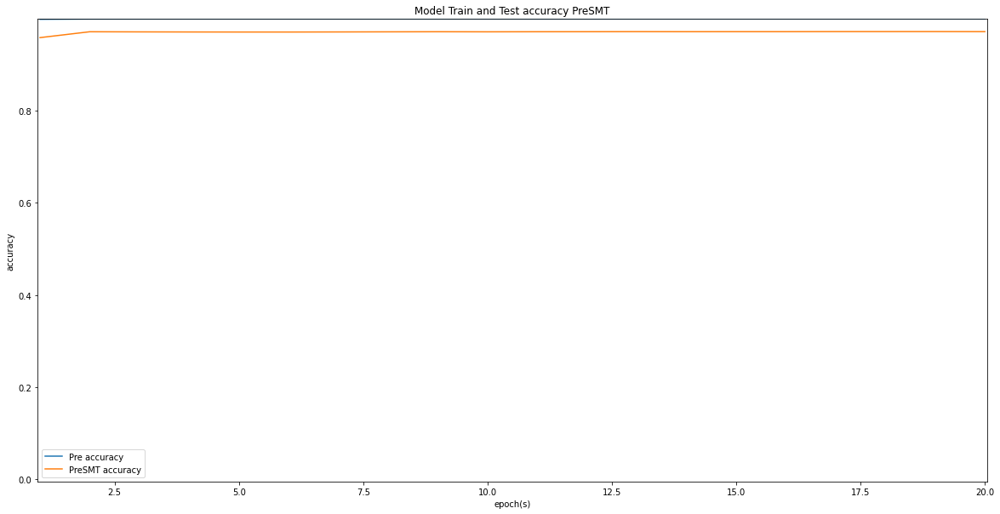

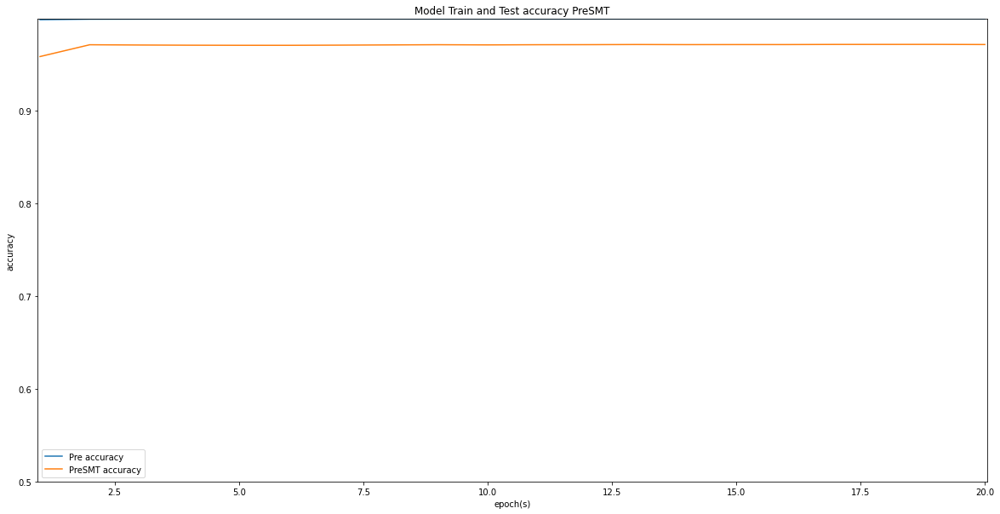

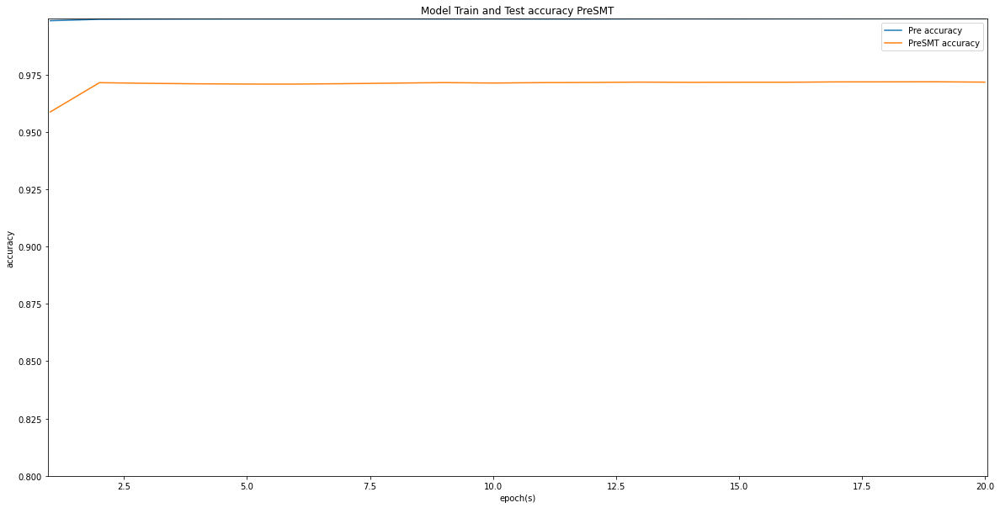

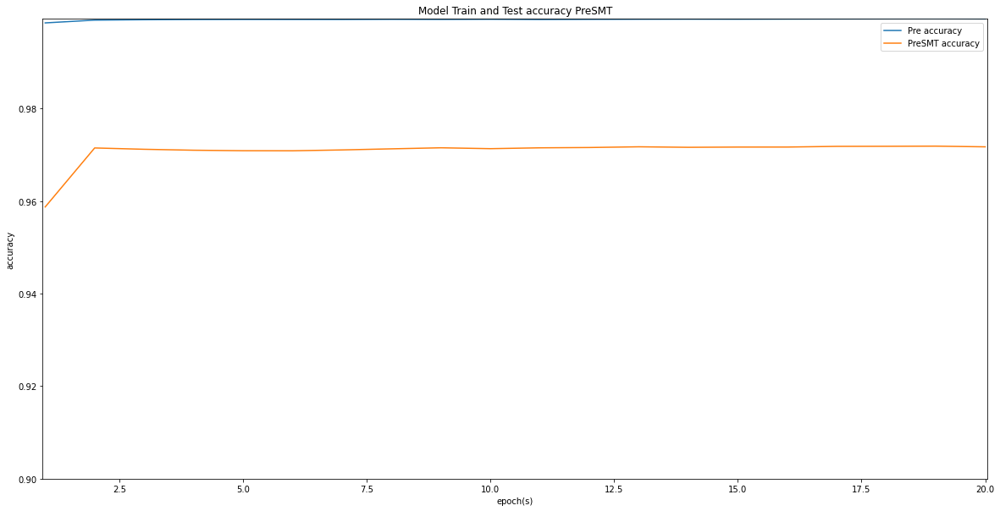

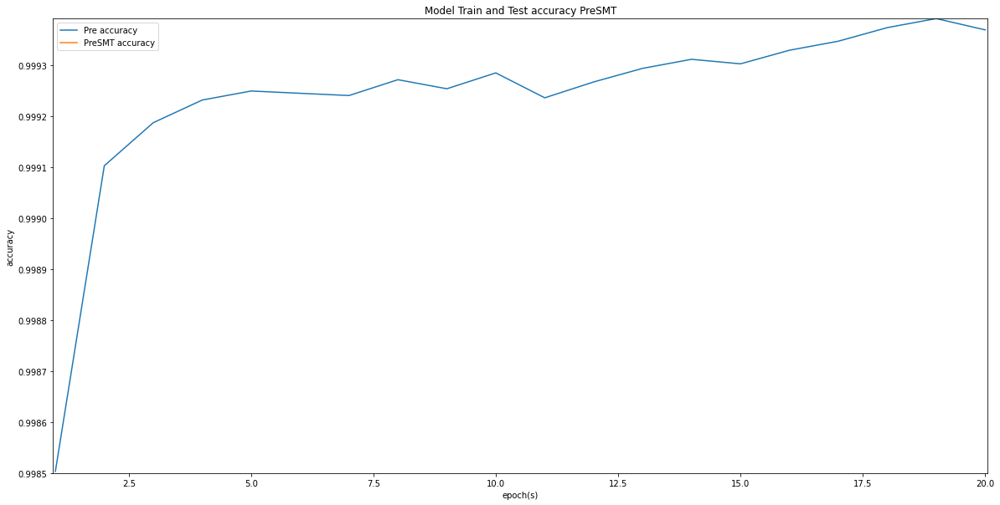

...

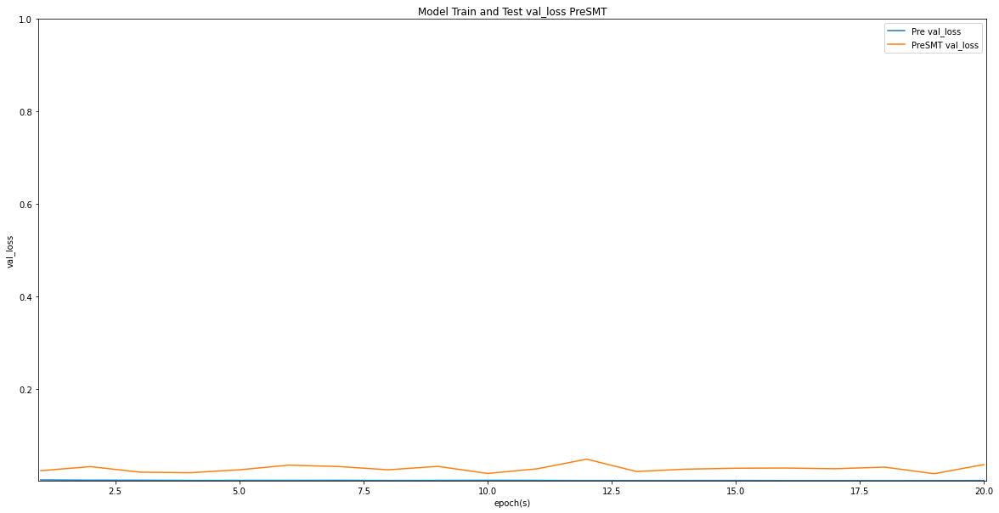

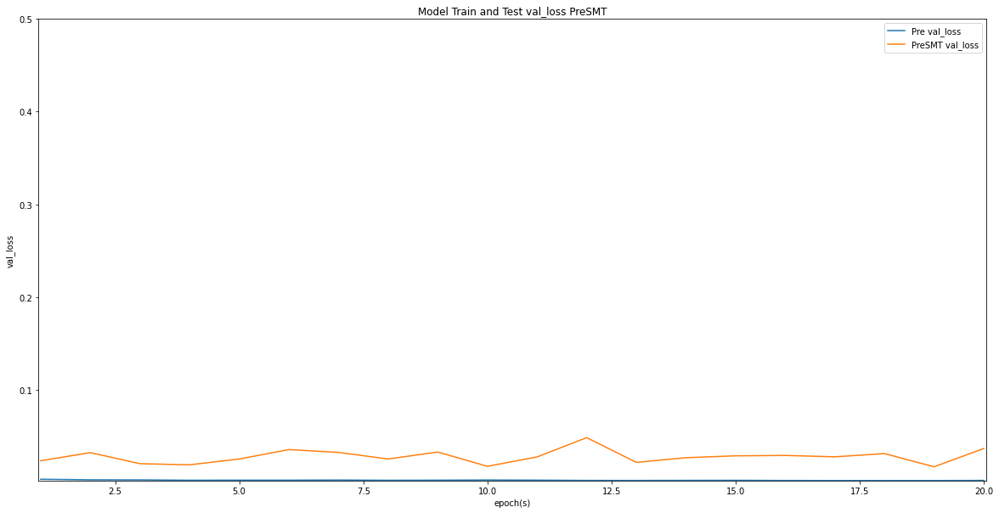

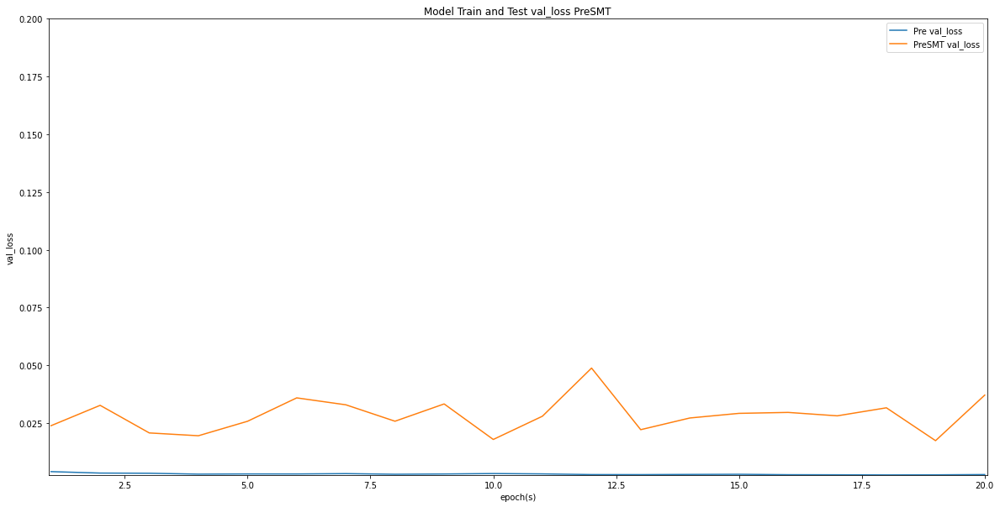

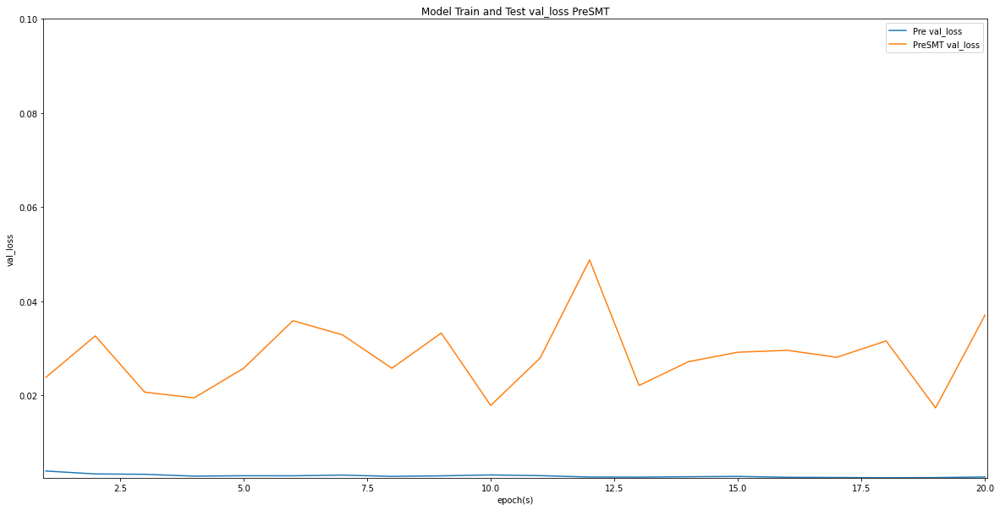

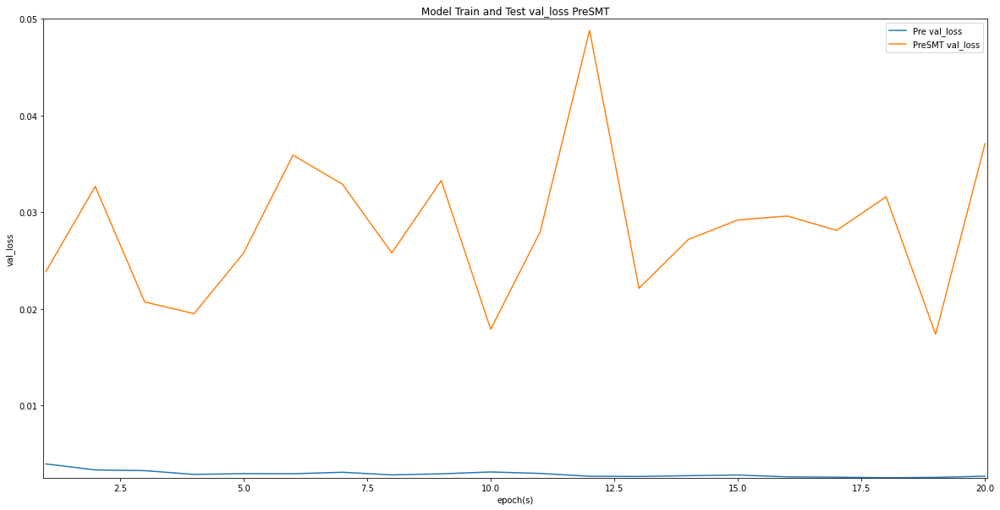

In [126]:
RESULTS_PREOPTHBvsPRESMTOPTHB4 = [RESULTS[0],RESULTS[3]]
plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB4,METRICS[0],DISPLAY_MODE[1])
plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB4,METRICS[1],DISPLAY_MODE[1])
plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB4,METRICS[2],DISPLAY_MODE[1])
plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB4,METRICS[3],DISPLAY_MODE[1])

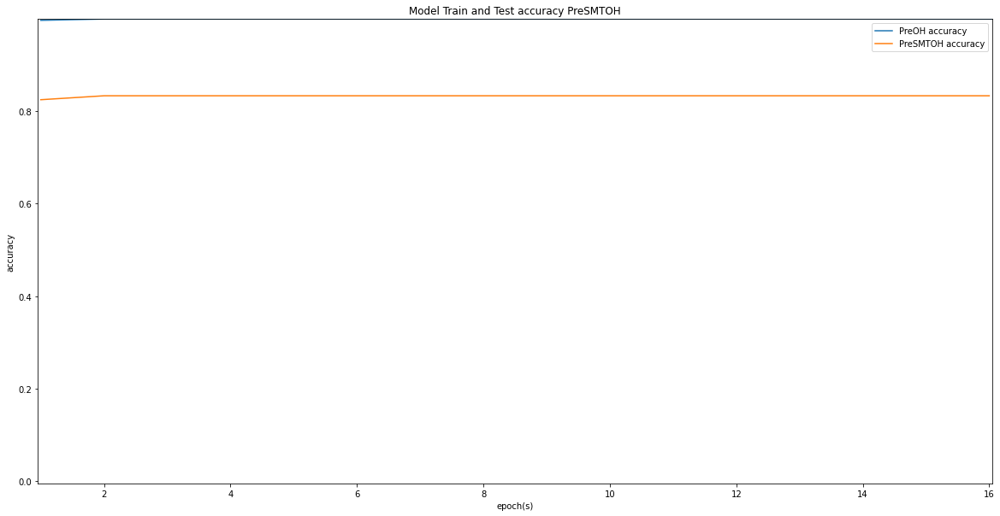

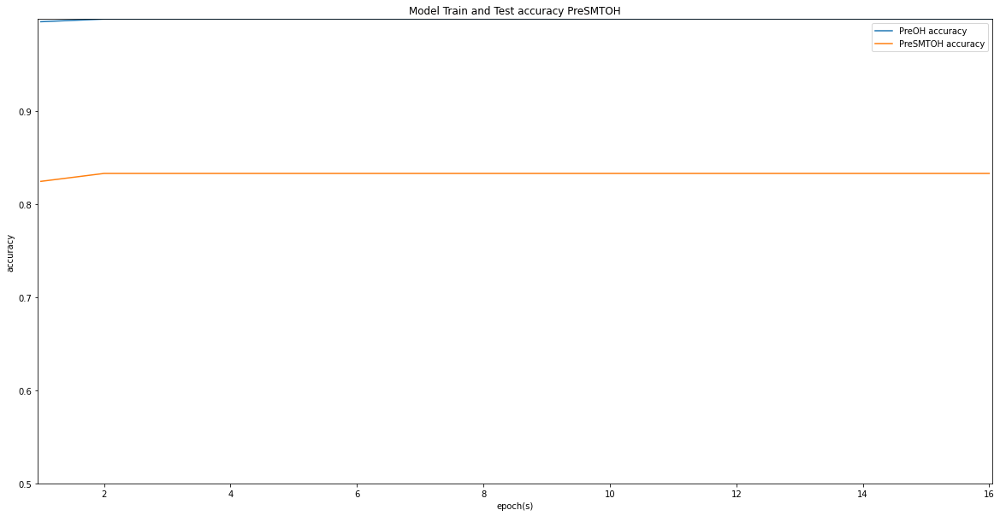

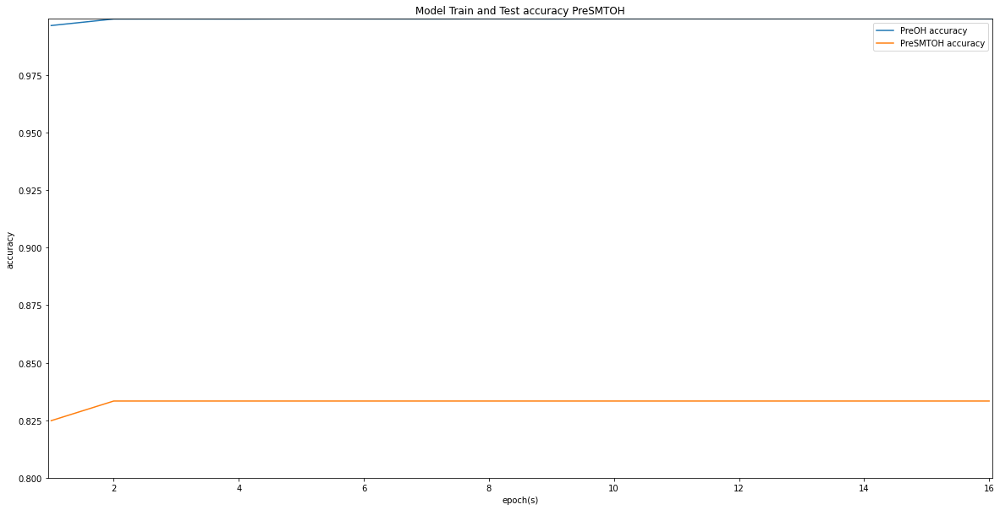

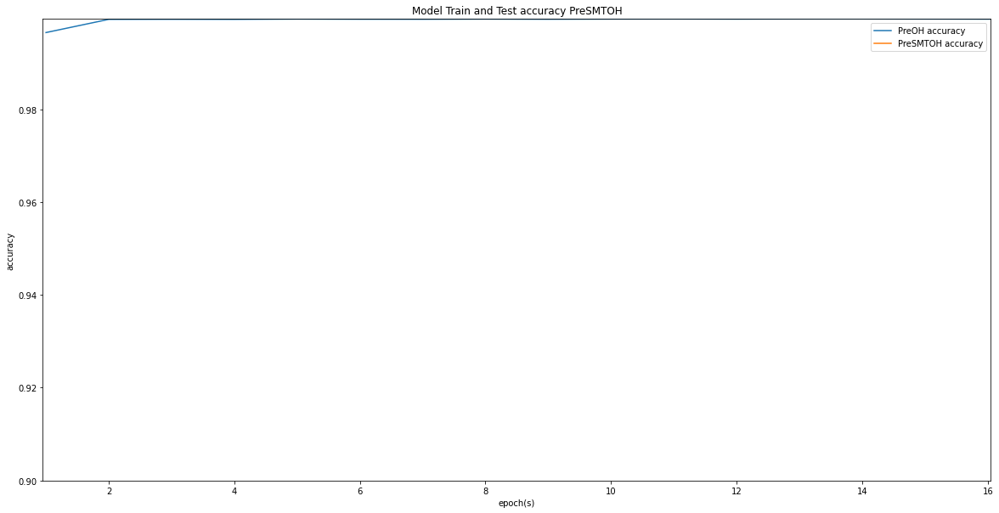

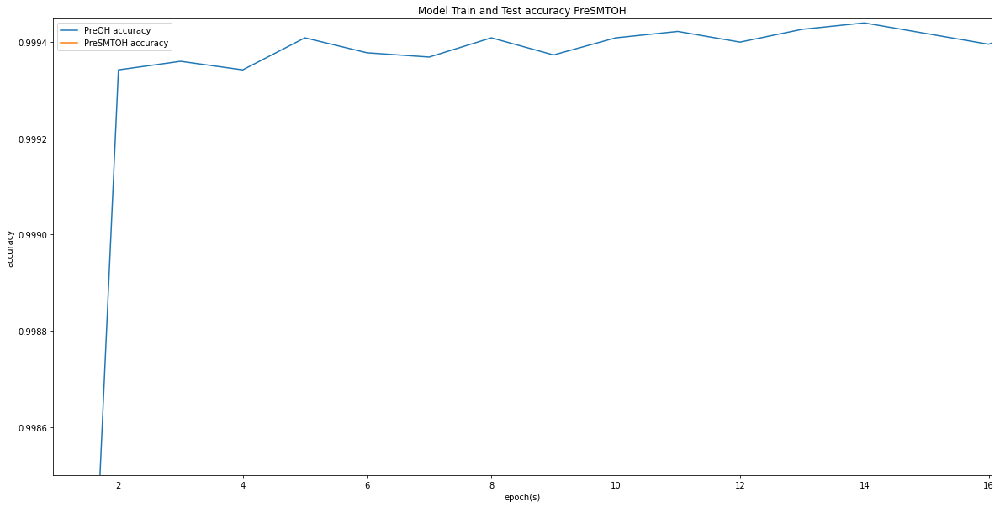

...

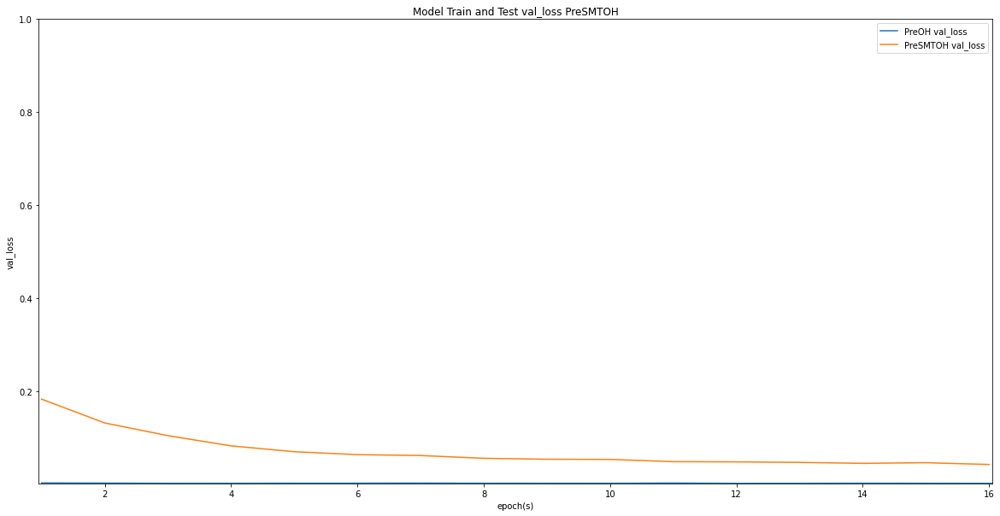

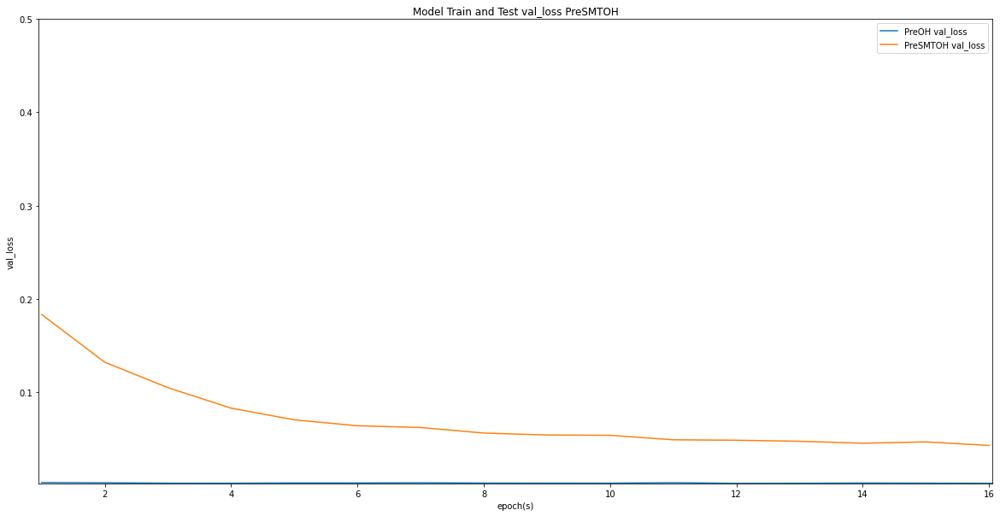

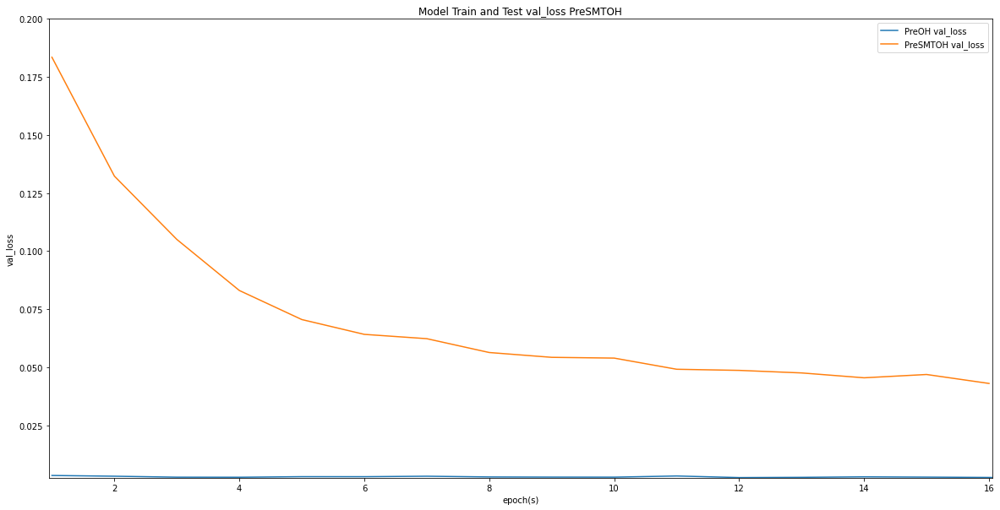

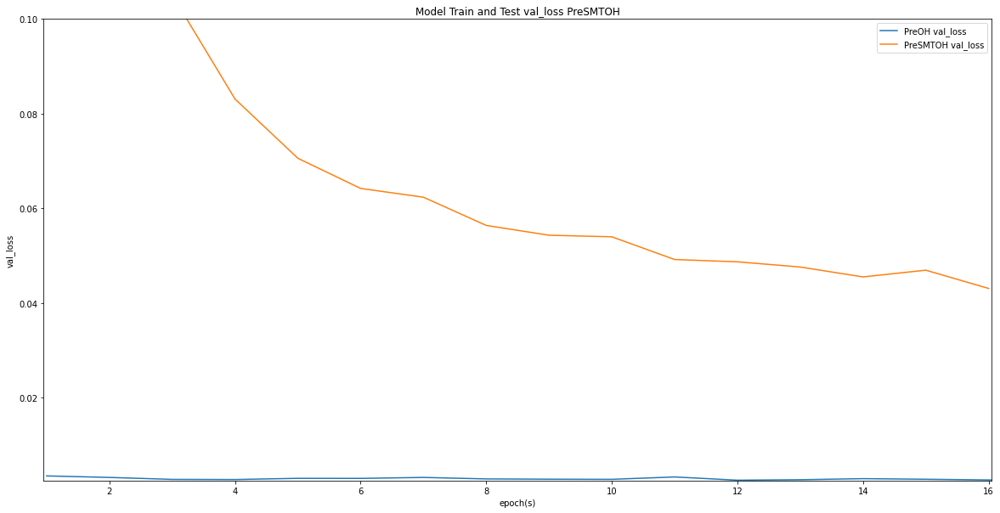

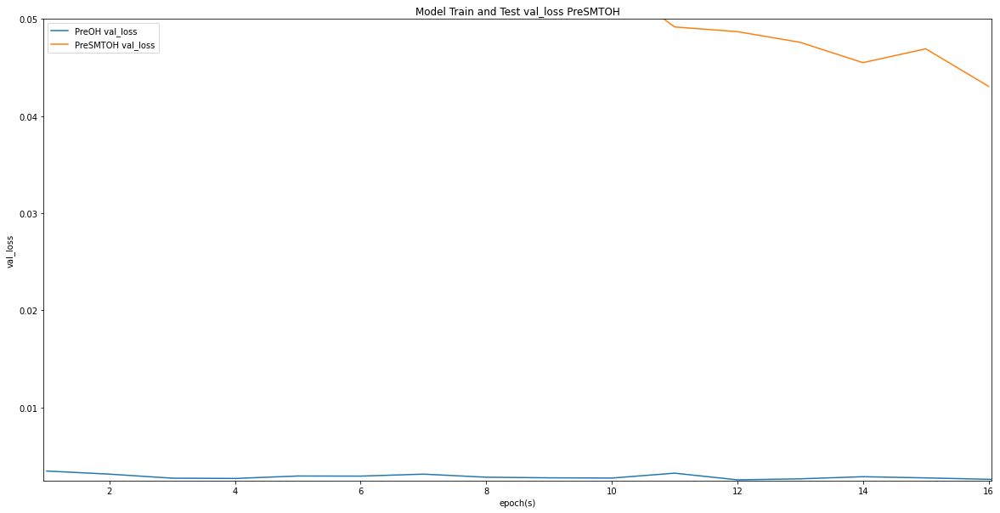

In [115]:
RESULTS_PREOPTHBvsPRESMTOPTHB = [RESULTS[6],RESULTS[7]]
plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB,METRICS[0],DISPLAY_MODE[1])
plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB,METRICS[1],DISPLAY_MODE[1])
plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB,METRICS[2],DISPLAY_MODE[1])
plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB,METRICS[3],DISPLAY_MODE[1])

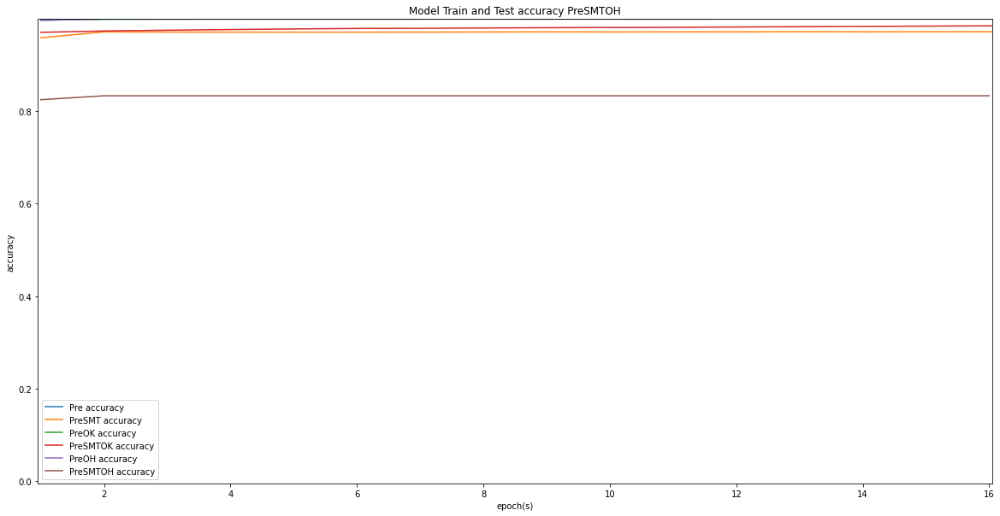

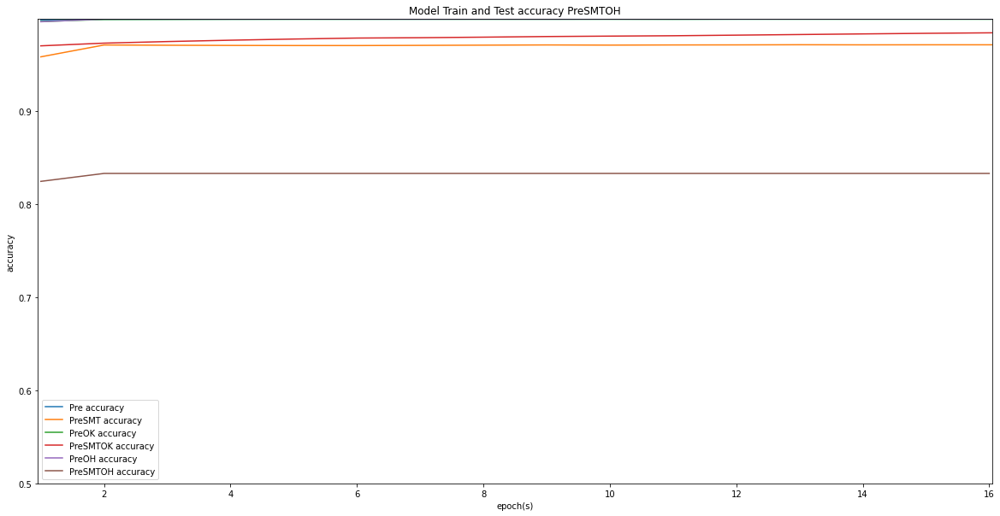

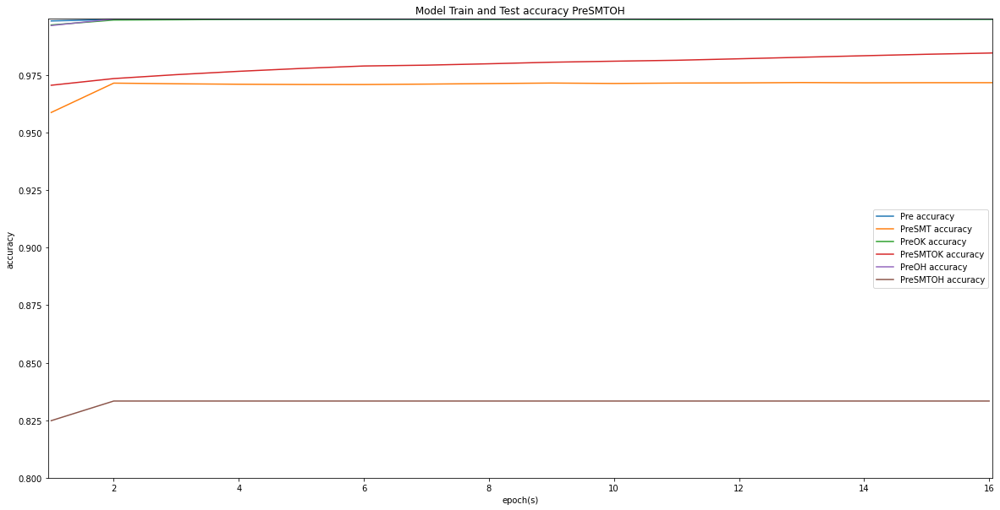

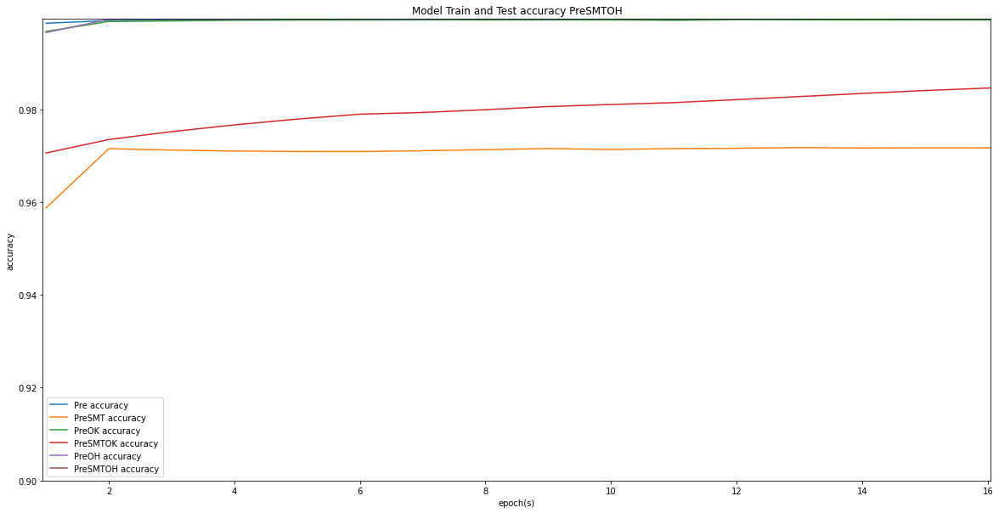

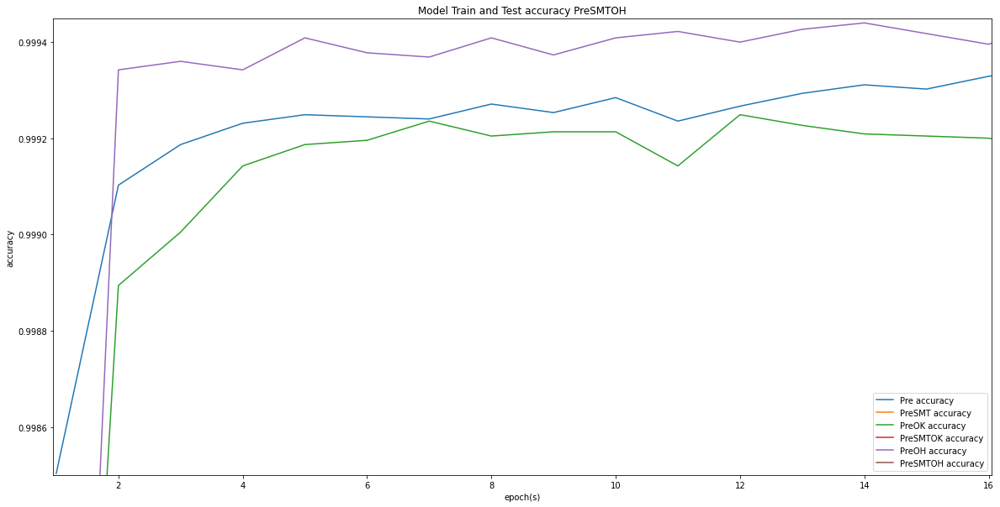

...

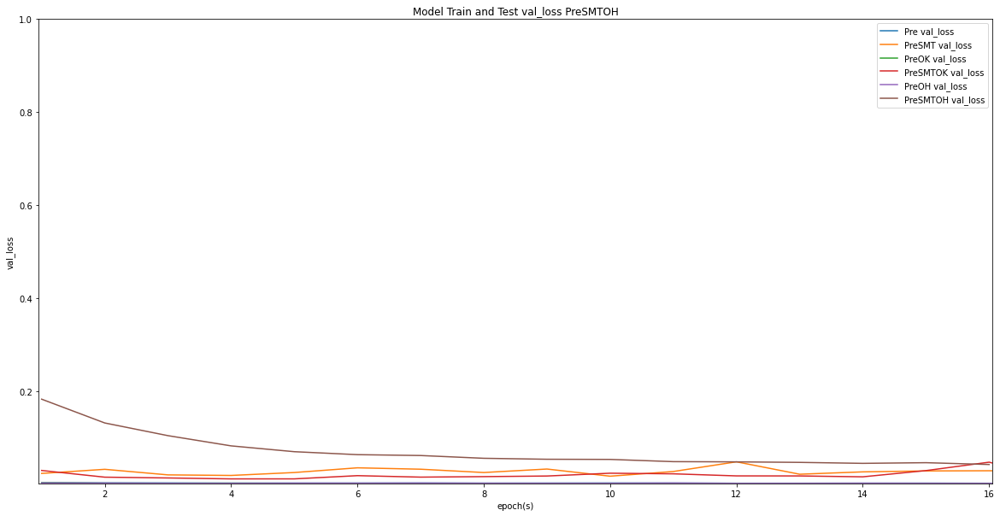

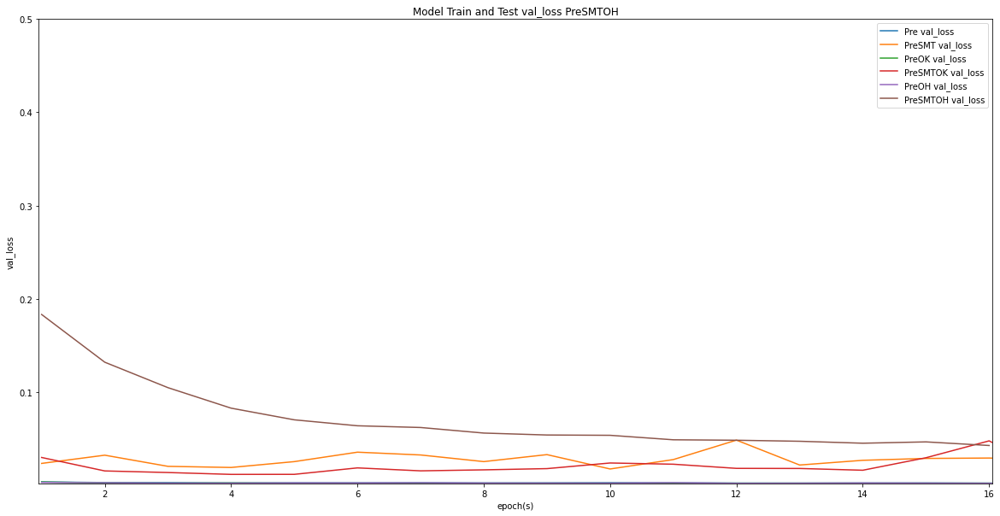

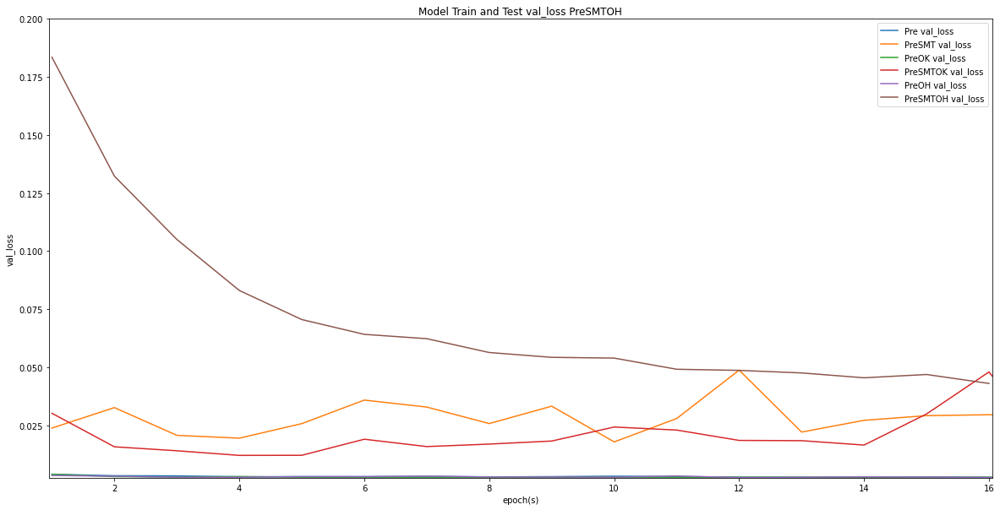

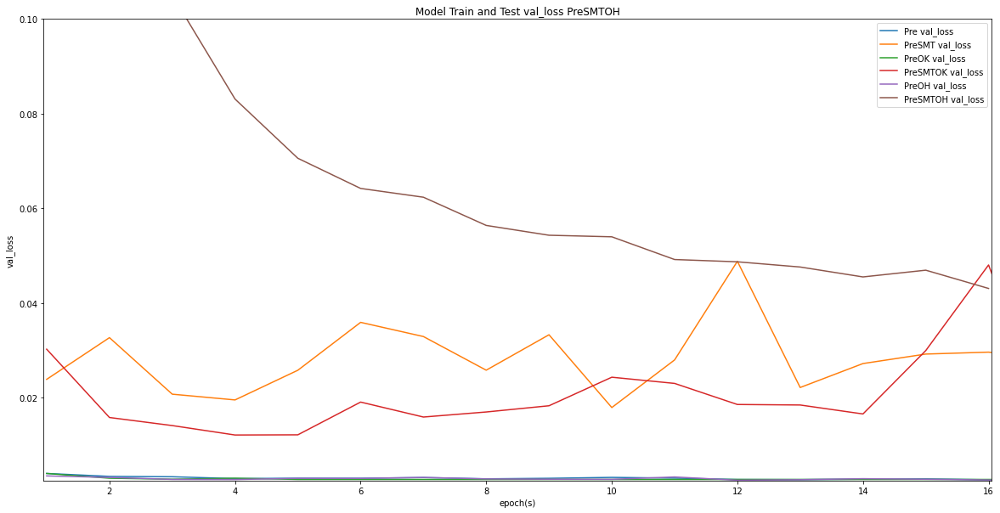

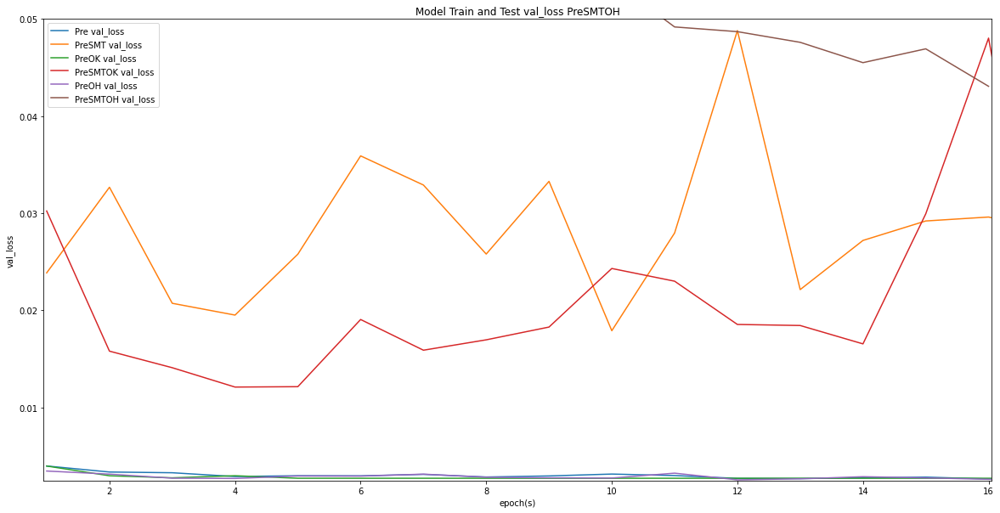

In [108]:
RESULTS_PREvsOPTHB_ALL = [RESULTS[0],RESULTS[3],RESULTS[4],RESULTS[5],RESULTS[6],RESULTS[7]]
plot_model(RESULTS_PREvsOPTHB_ALL,METRICS[0],DISPLAY_MODE[1])
plot_model(RESULTS_PREvsOPTHB_ALL,METRICS[1],DISPLAY_MODE[1])
plot_model(RESULTS_PREvsOPTHB_ALL,METRICS[2],DISPLAY_MODE[1])
plot_model(RESULTS_PREvsOPTHB_ALL,METRICS[3],DISPLAY_MODE[1])

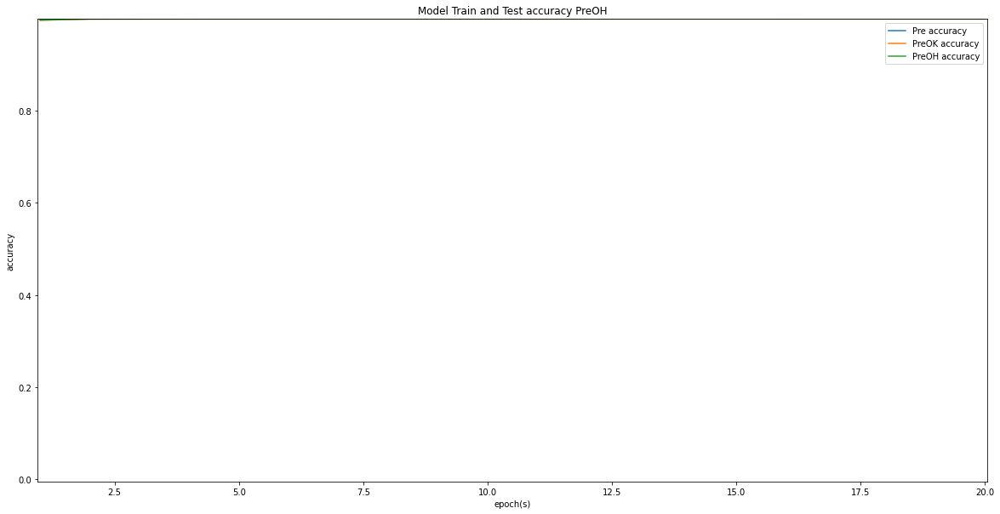

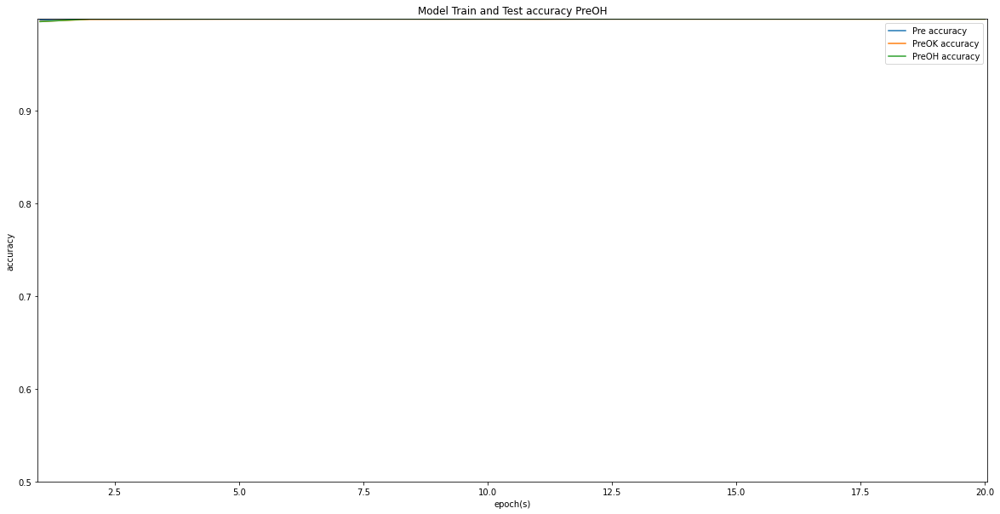

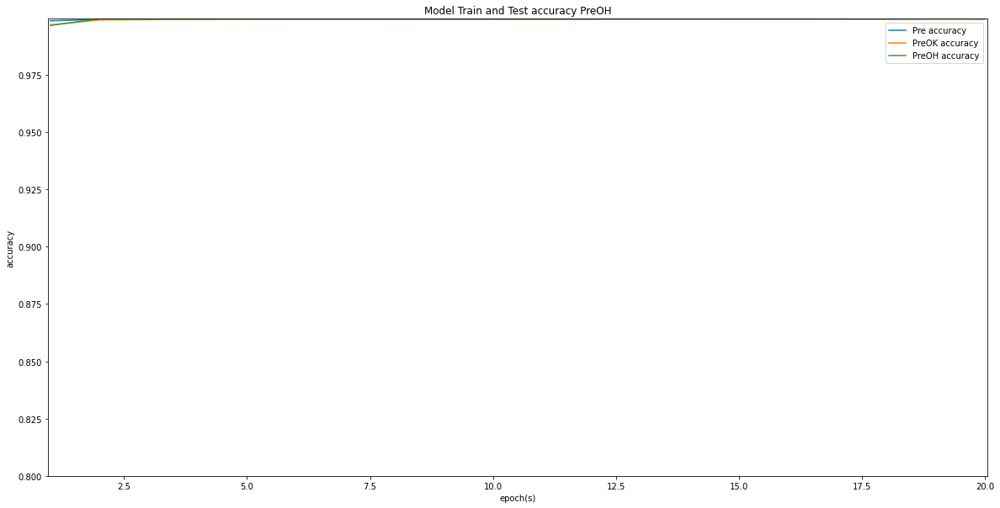

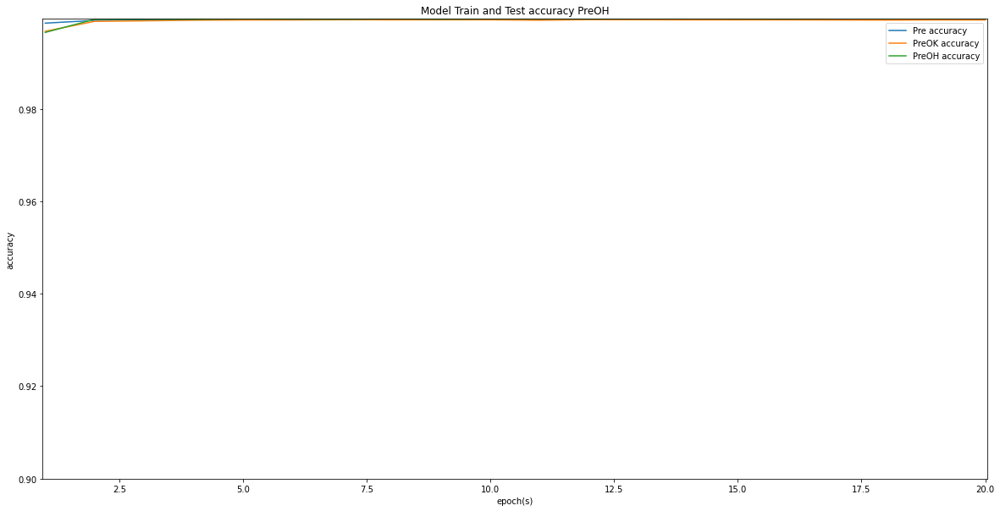

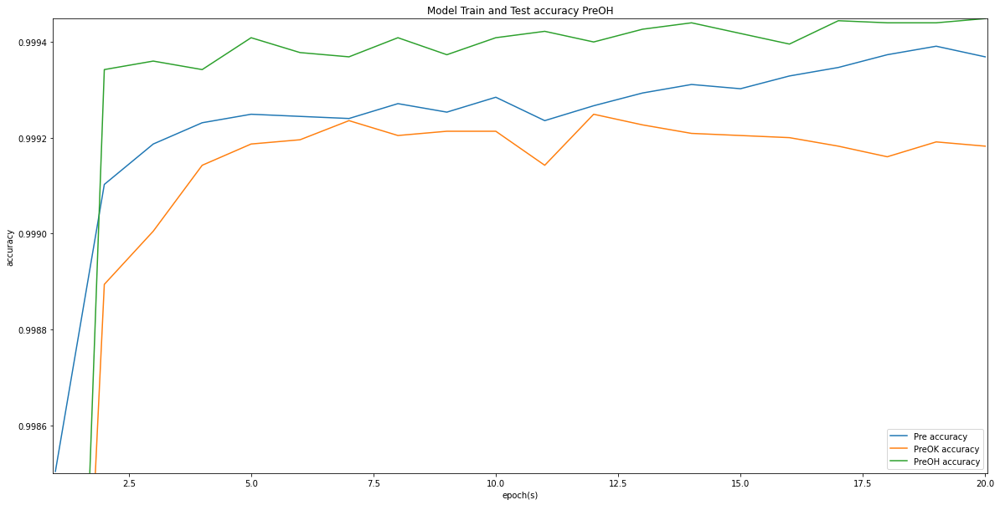

...

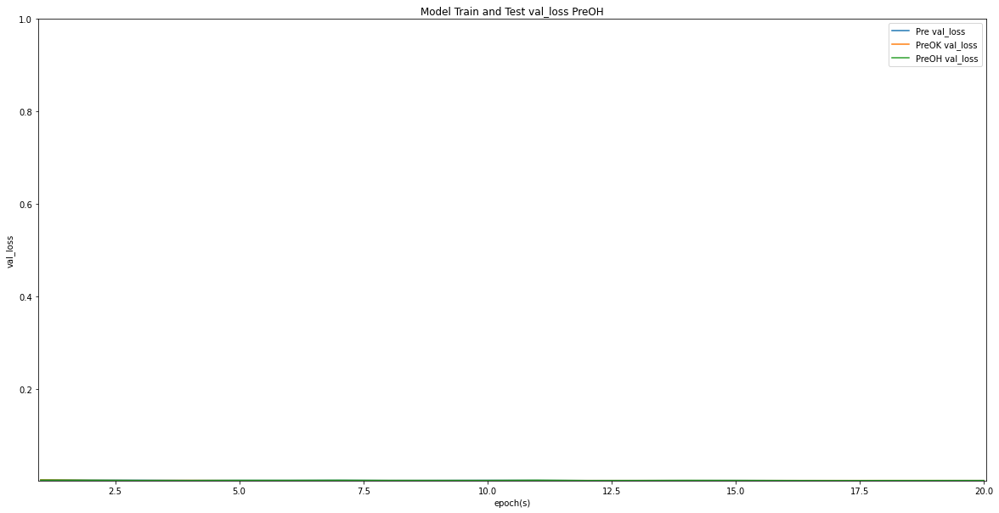

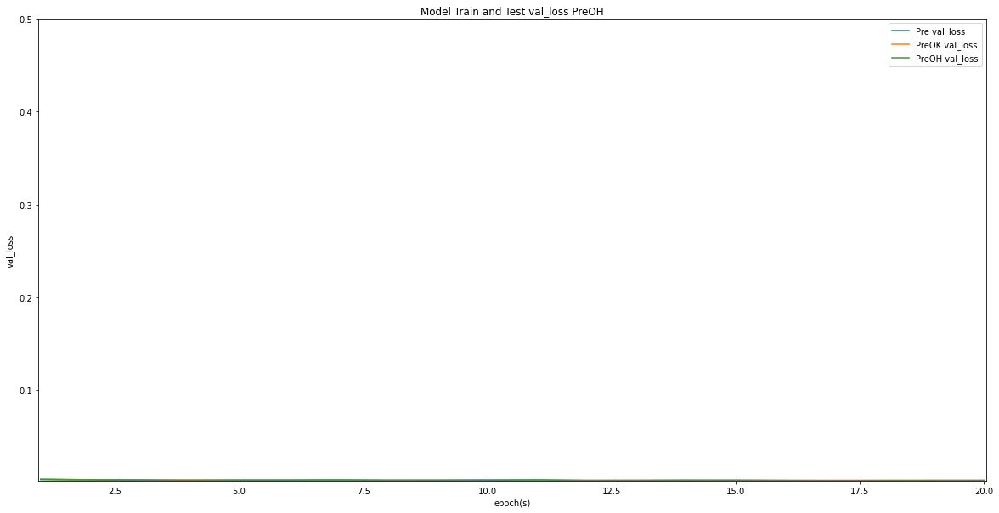

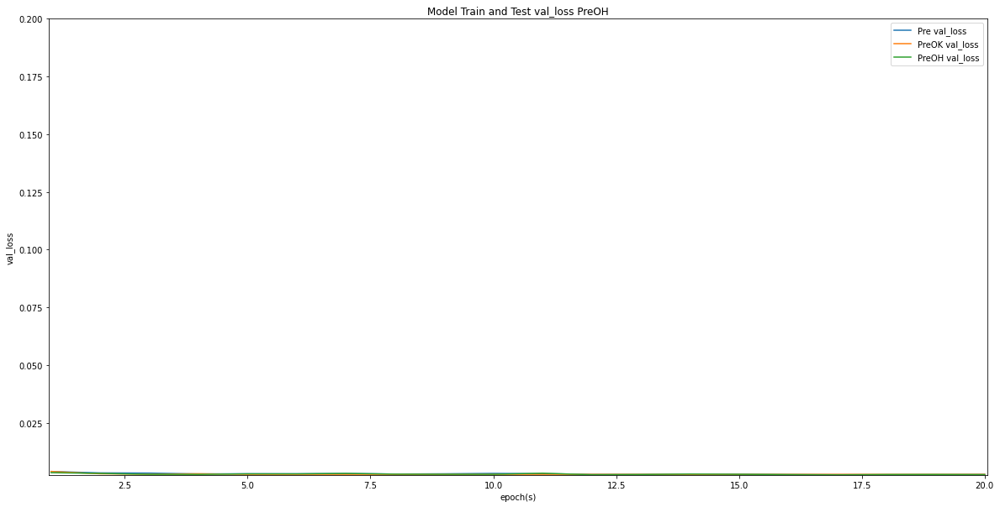

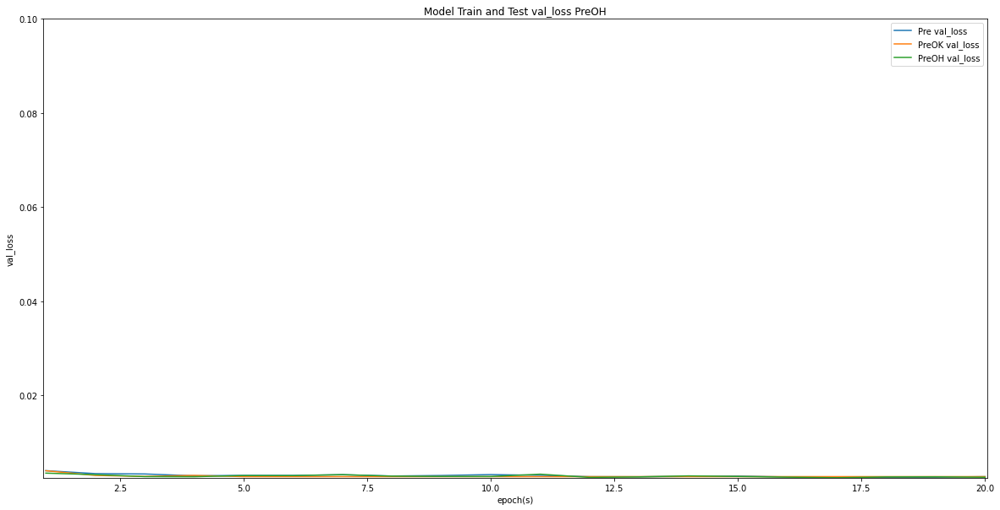

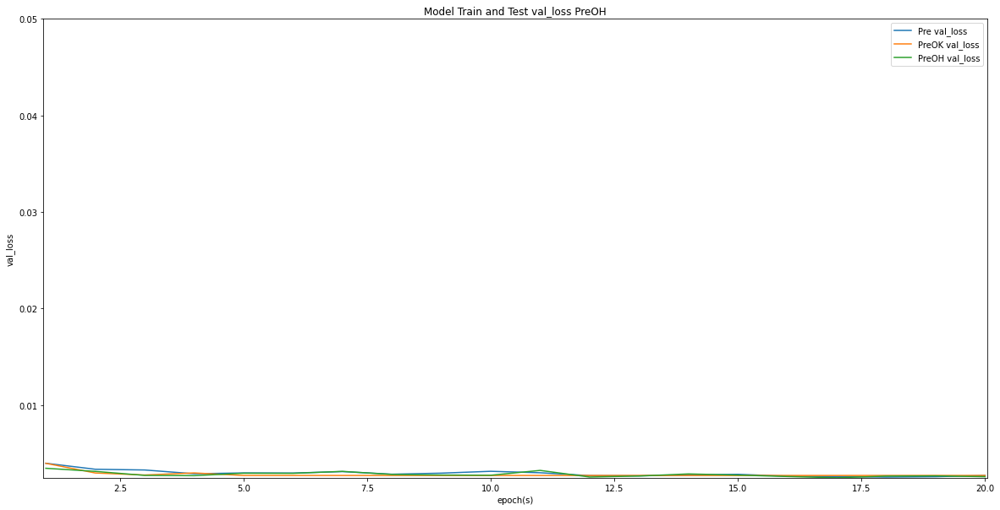

In [109]:
RESULTS_PREvsOPTHB = [RESULTS[0],RESULTS[4],RESULTS[6]]
plot_model(RESULTS_PREvsOPTHB,METRICS[0],DISPLAY_MODE[1])
plot_model(RESULTS_PREvsOPTHB,METRICS[1],DISPLAY_MODE[1])
plot_model(RESULTS_PREvsOPTHB,METRICS[2],DISPLAY_MODE[1])
plot_model(RESULTS_PREvsOPTHB,METRICS[3],DISPLAY_MODE[1])

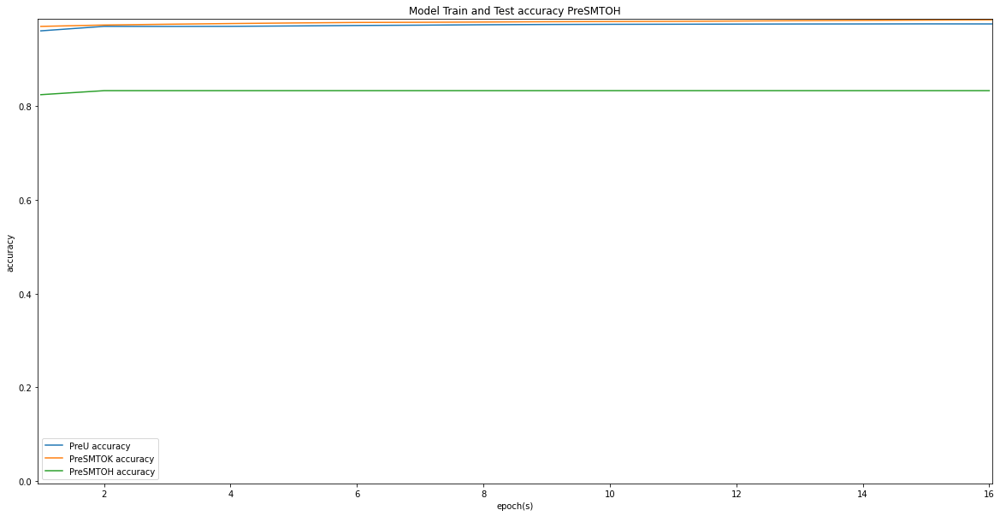

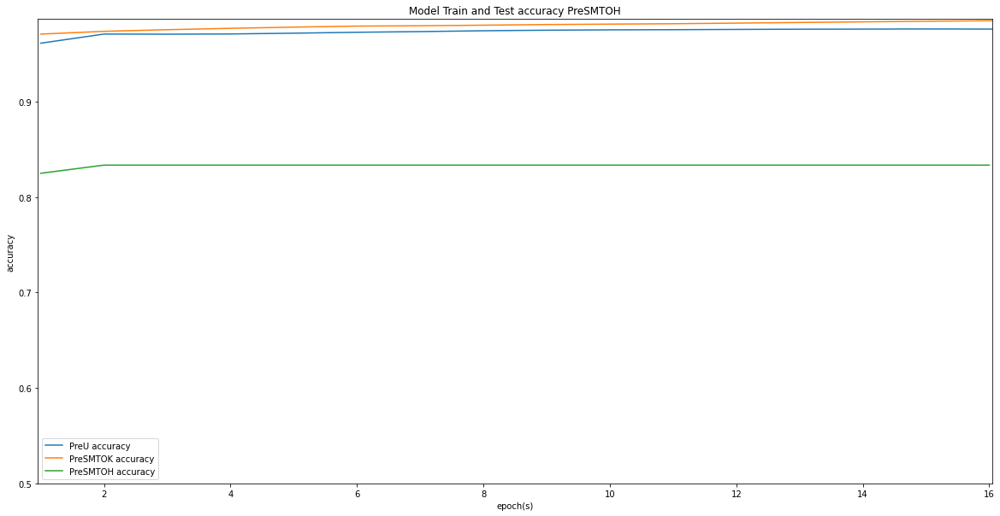

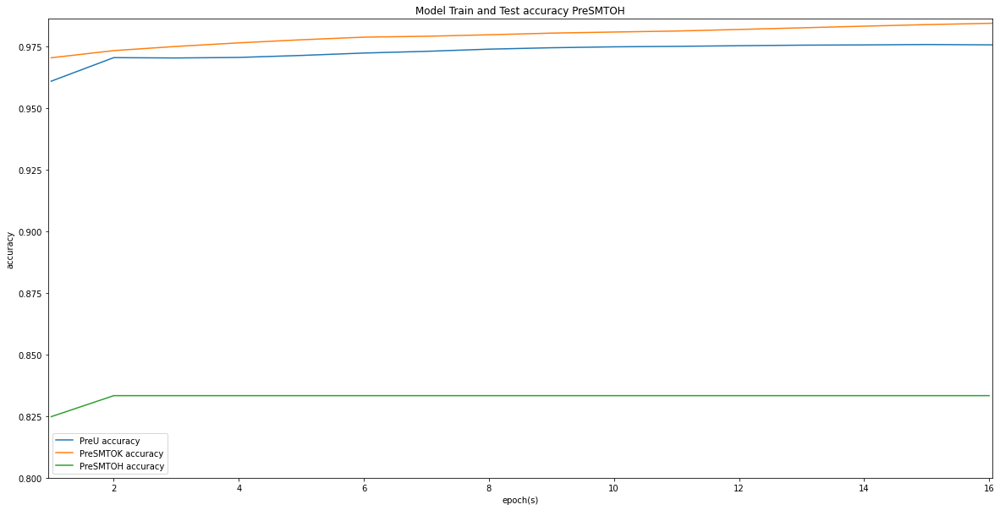

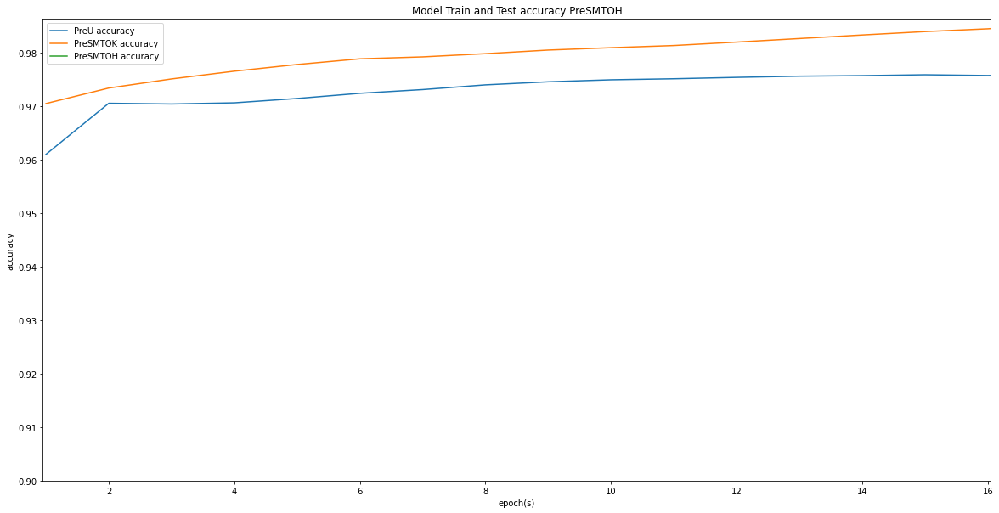

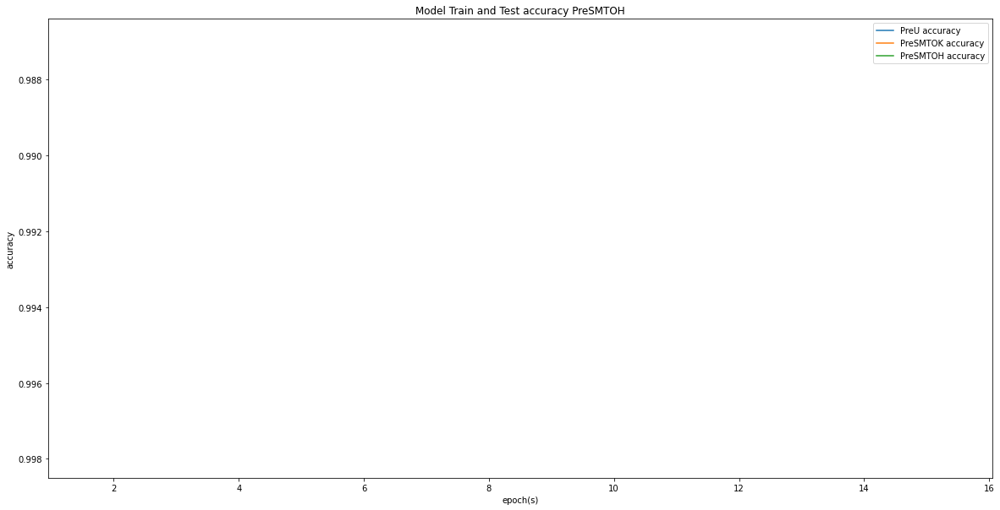

...

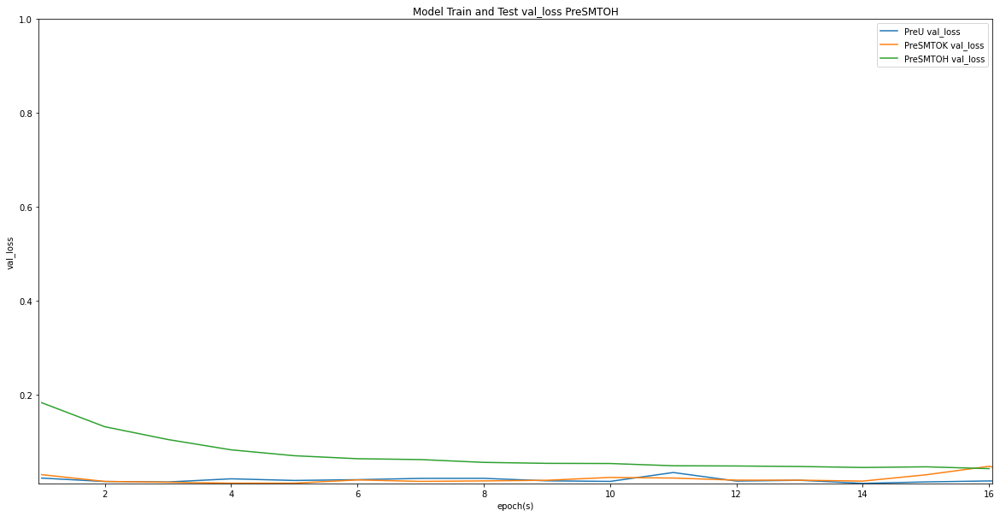

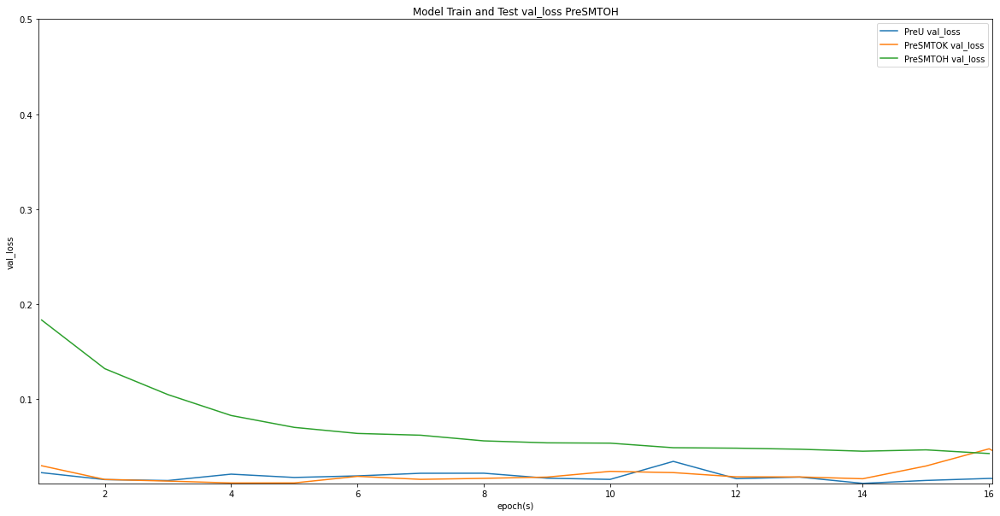

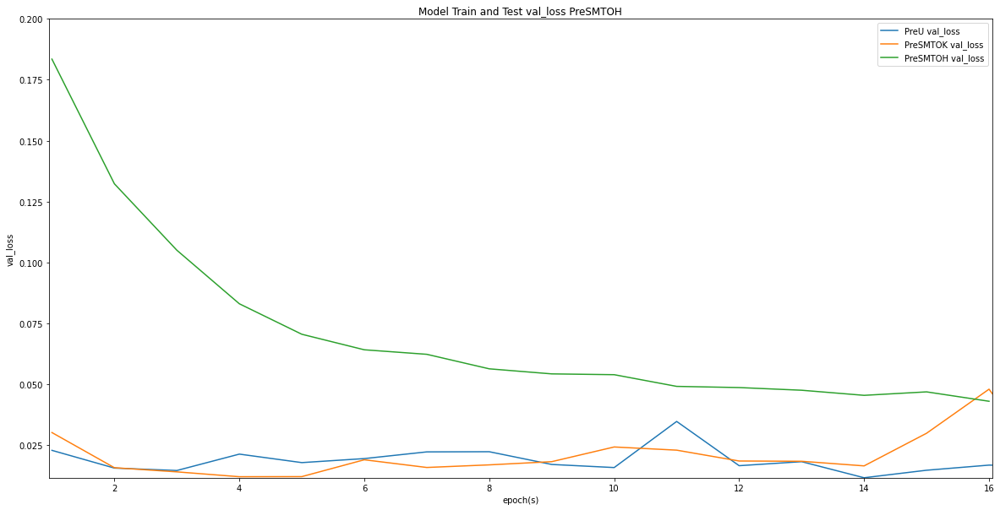

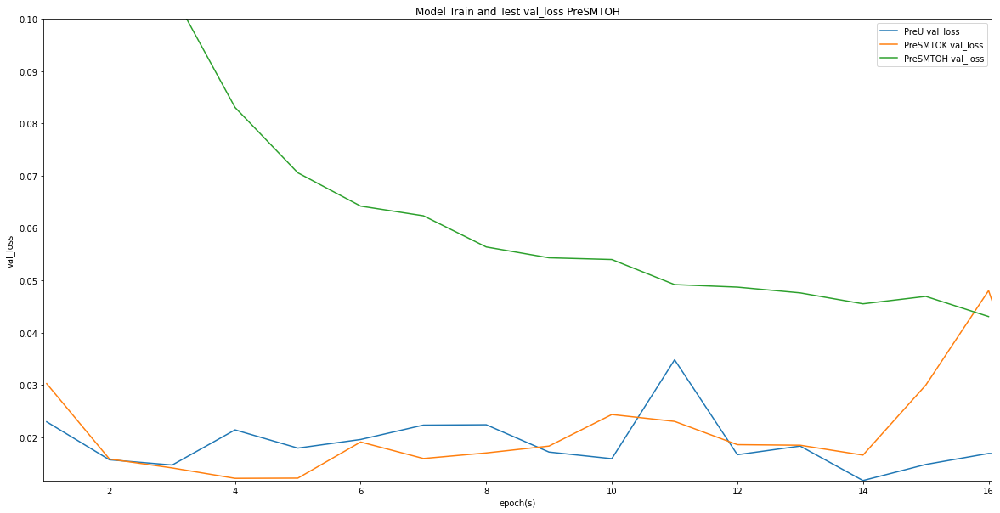

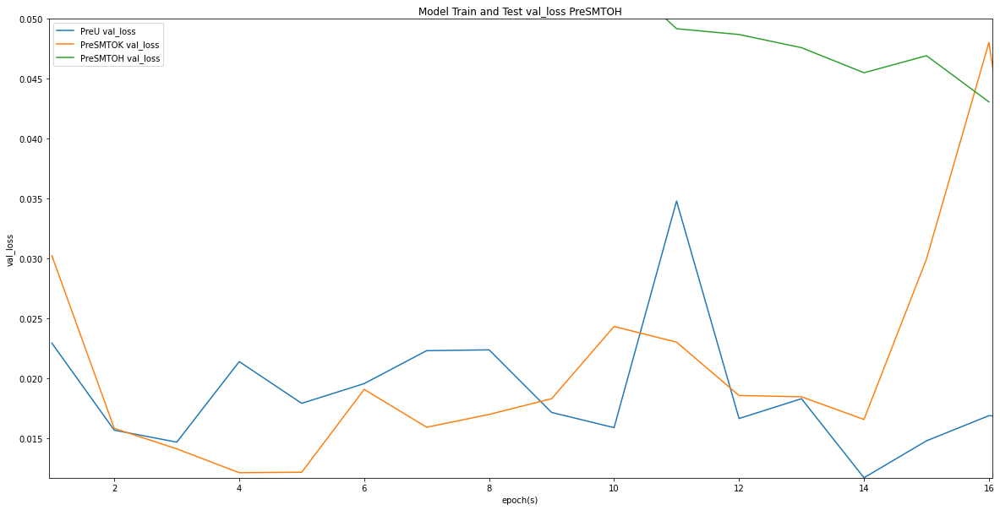

In [110]:
RESULTS_PRESMTvsOPTHB = [RESULTS[1],RESULTS[5],RESULTS[7]]
plot_model(RESULTS_PRESMTvsOPTHB,METRICS[0],DISPLAY_MODE[1])
plot_model(RESULTS_PRESMTvsOPTHB,METRICS[1],DISPLAY_MODE[1])
plot_model(RESULTS_PRESMTvsOPTHB,METRICS[2],DISPLAY_MODE[1])
plot_model(RESULTS_PRESMTvsOPTHB,METRICS[3],DISPLAY_MODE[1])

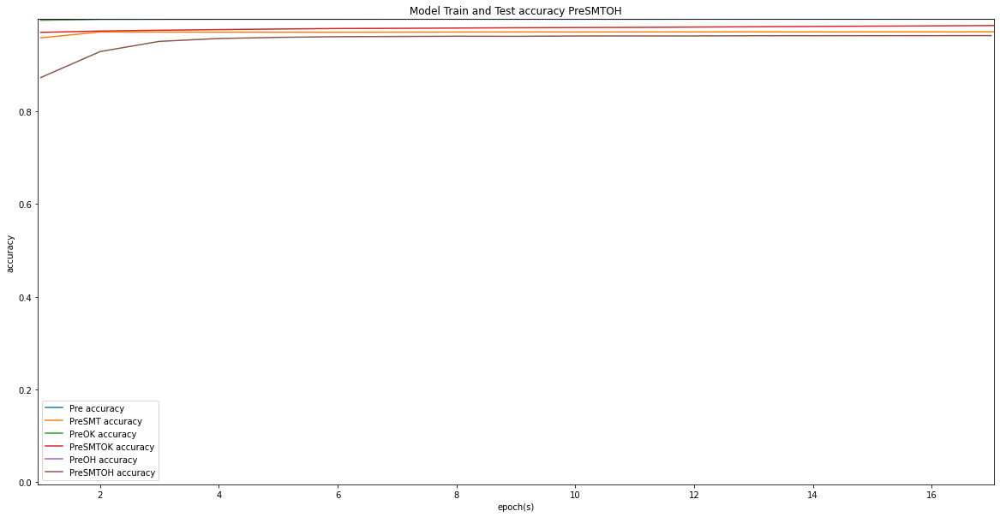

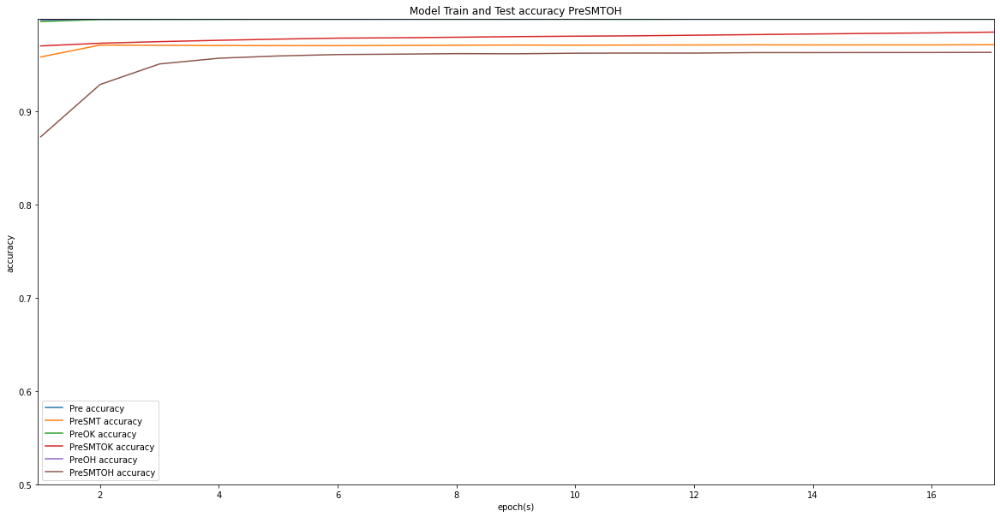

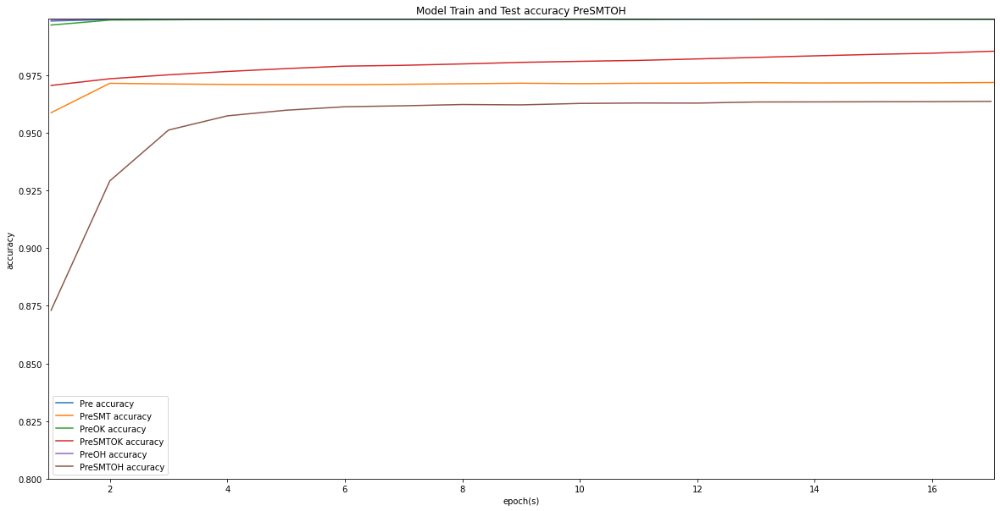

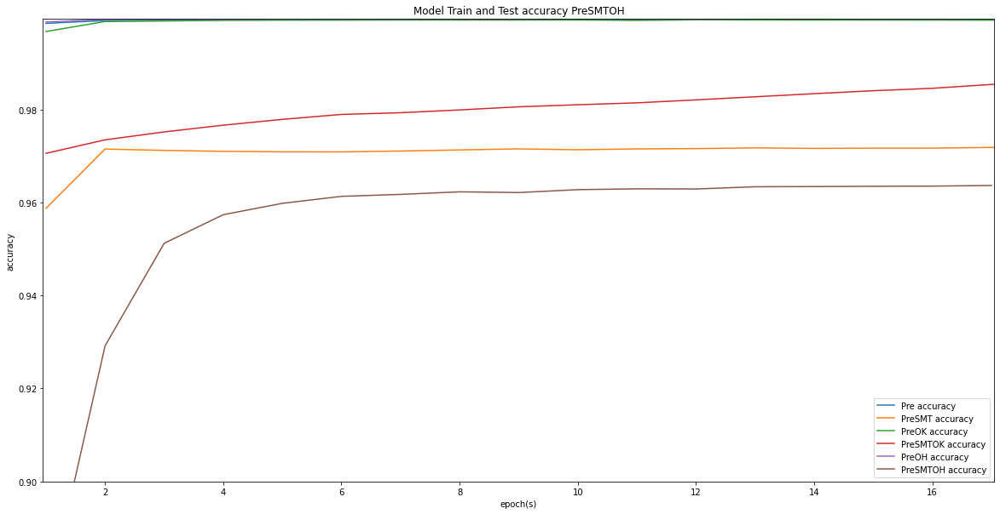

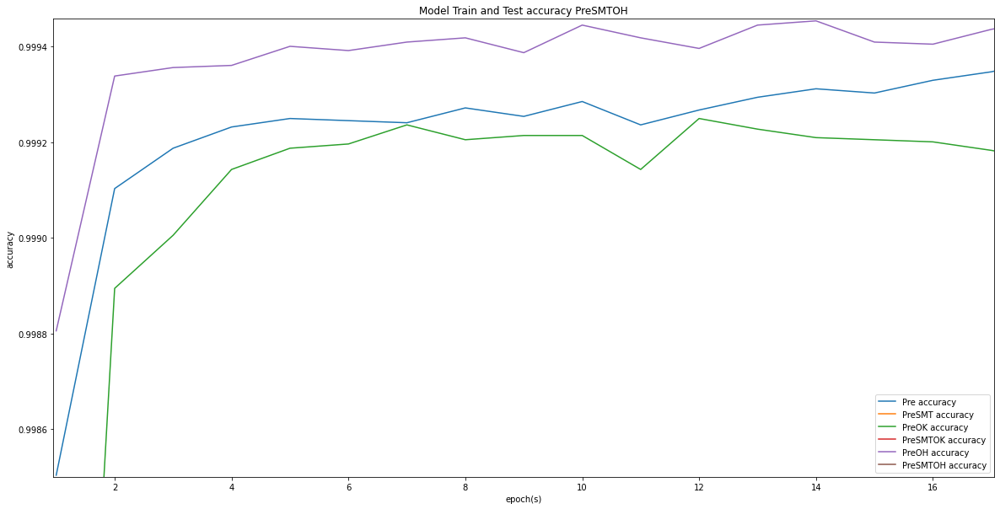

...

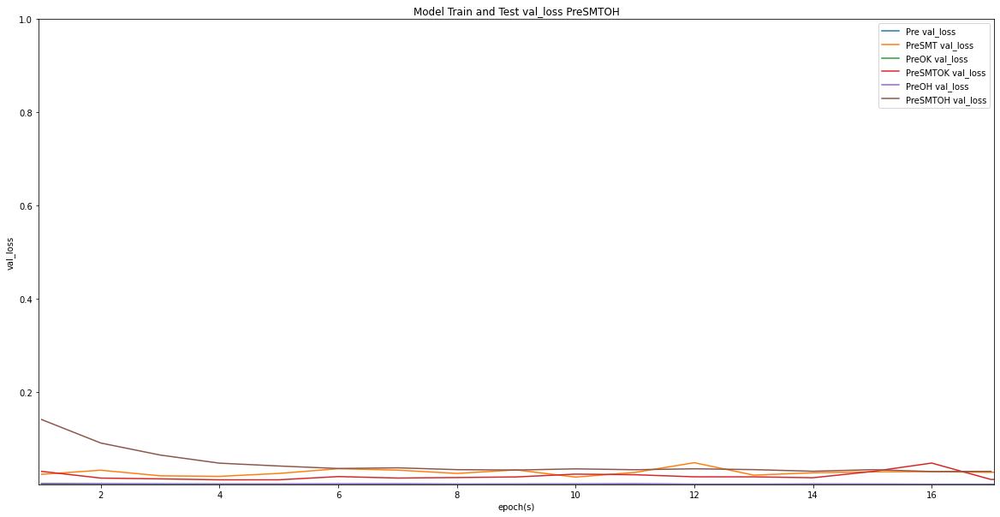

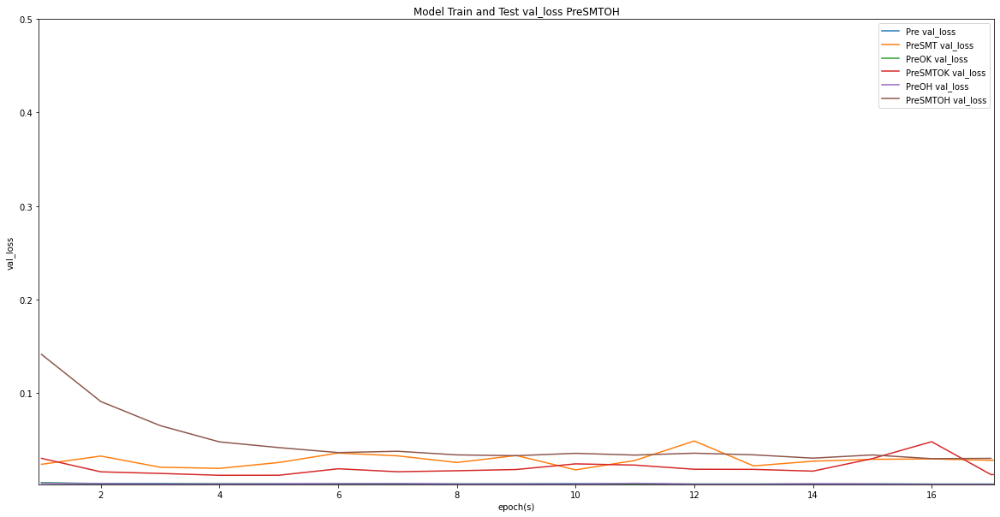

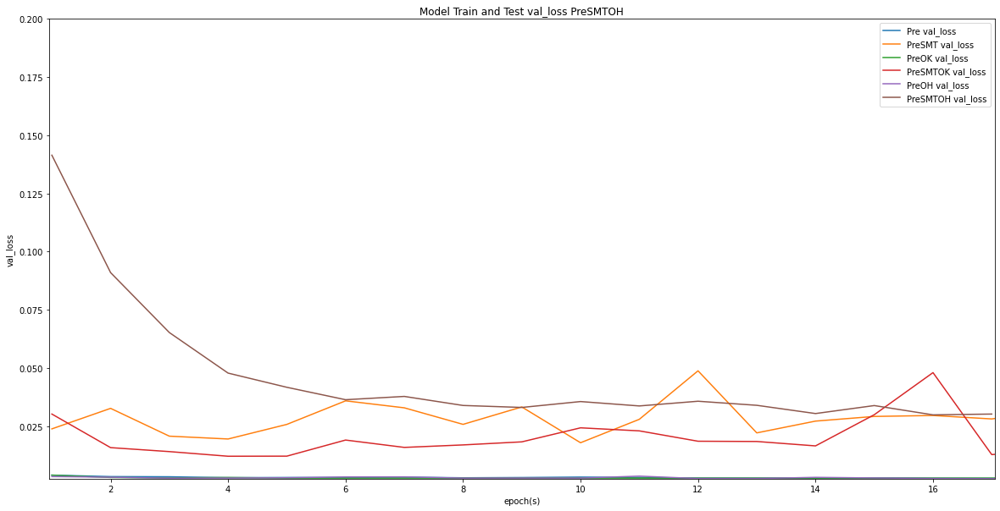

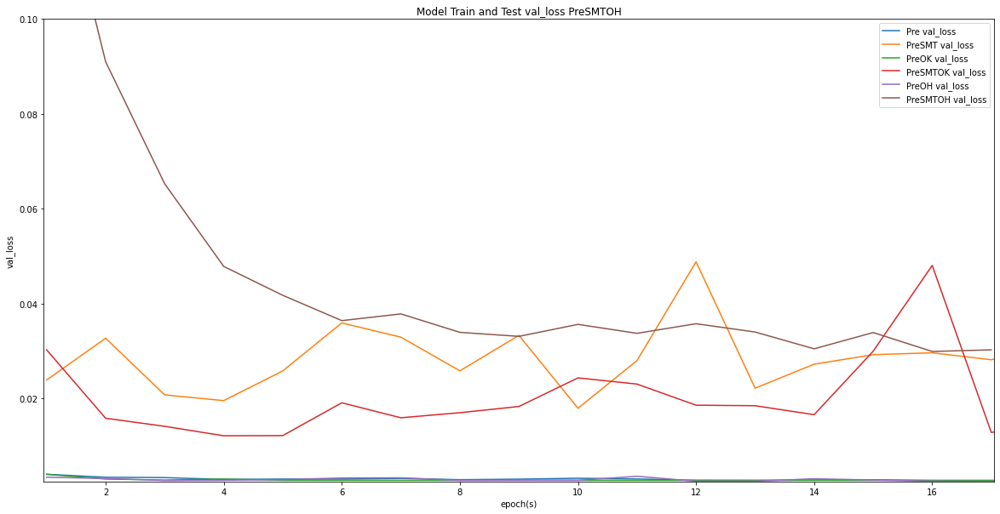

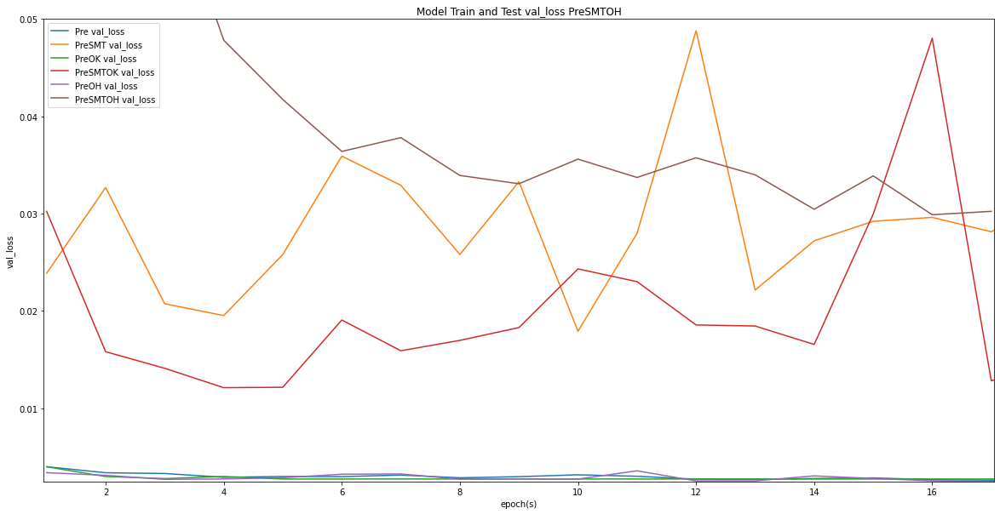

In [125]:
#RESULTS_PREOPTHBvsPRESMTOPTHB3 = [RESULTS[0],RESULTS[3],RESULTS[4],RESULTS[5],RESULTS2[0],RESULTS2[1]]
#plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB3,METRICS[0],DISPLAY_MODE[1])
#plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB3,METRICS[1],DISPLAY_MODE[1])
#plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB3,METRICS[2],DISPLAY_MODE[1])
#plot_model(RESULTS_PREOPTHBvsPRESMTOPTHB3,METRICS[3],DISPLAY_MODE[1])

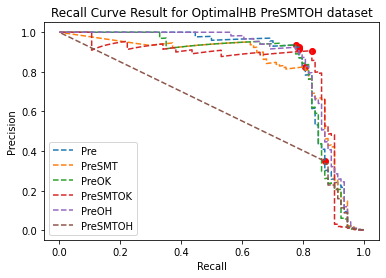

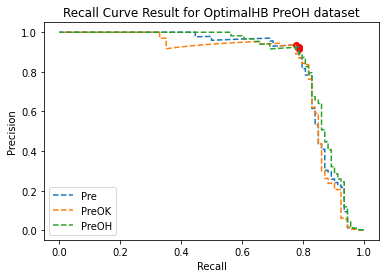

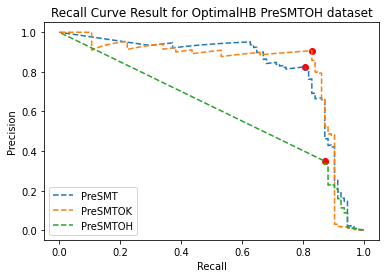

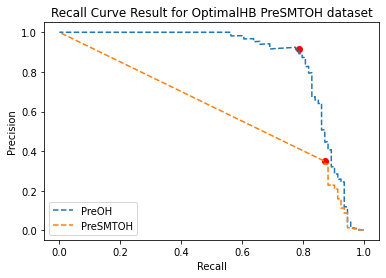

In [111]:
MODELS_PREvsOPTHB_ALL = [MODELS[0],MODELS[3],MODELS[4],MODELS[5],MODELS[6],MODELS[7]]
MODELS_PREvsOPTHB = [MODELS[0],MODELS[4],MODELS[6]]
MODELS_PRESMTvsOPTHB = [MODELS[3],MODELS[5],MODELS[7]]
MODELS_PREOPTHBvsPRESMTOPTHB = [MODELS[6],MODELS[7]]
plot_AUC(MODELS_PREvsOPTHB_ALL,X_pre_test,Y_pre_test)
plot_AUC(MODELS_PREvsOPTHB,X_pre_test,Y_pre_test) 
plot_AUC(MODELS_PRESMTvsOPTHB,X_pre_test,Y_pre_test)
plot_AUC(MODELS_PREOPTHBvsPRESMTOPTHB,X_pre_test,Y_pre_test)

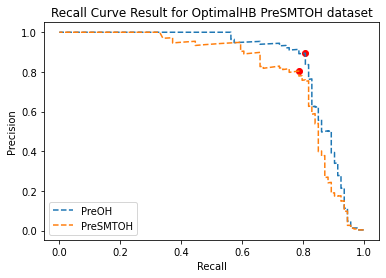

In [121]:
#NEWMODELS2 = [MODELS2[0],MODELS2[1]]
#plot_AUC(NEWMODELS2,X_pre_test,Y_pre_test)


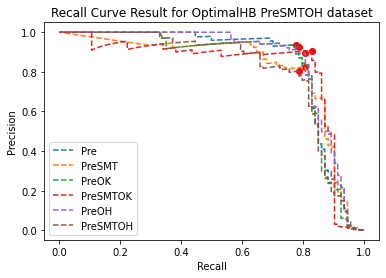

In [122]:
#NEWMODELS3 = [MODELS[0],MODELS[3],MODELS[4],MODELS[5],MODELS2[0],MODELS2[1]]
#plot_AUC(NEWMODELS3,X_pre_test,Y_pre_test)

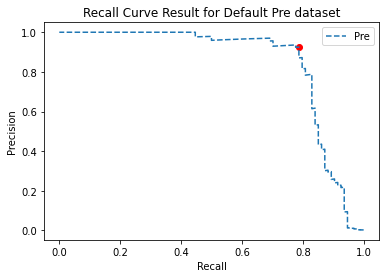

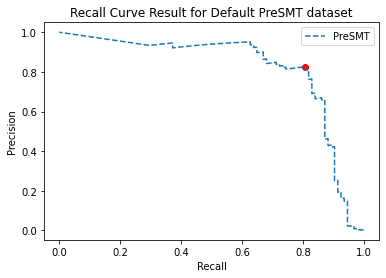

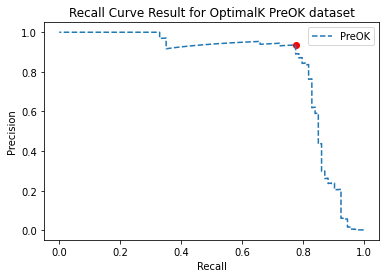

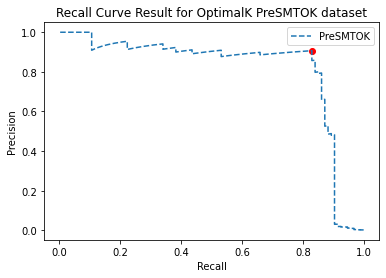

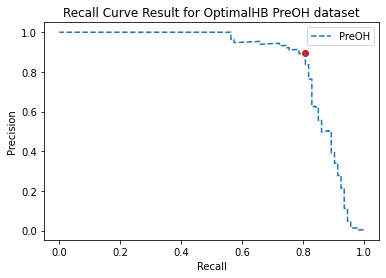

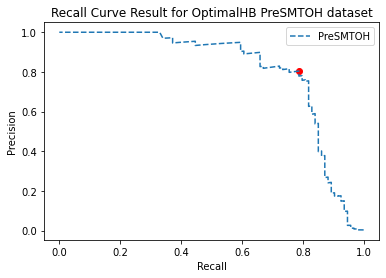

In [127]:
M1 = [MODELS[0]]
plot_AUC(M1,X_pre_test,Y_pre_test)
M2 = [MODELS[3]]
plot_AUC(M2,X_pre_test,Y_pre_test)
M3 = [MODELS[4]]
plot_AUC(M3,X_pre_test,Y_pre_test)
M4 = [MODELS[5]]
plot_AUC(M4,X_pre_test,Y_pre_test)
M5 = [MODELS2[0]]
plot_AUC(M5,X_pre_test,Y_pre_test)
M6 = [MODELS2[1]]
plot_AUC(M6,X_pre_test,Y_pre_test)

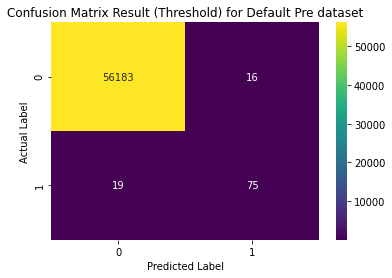

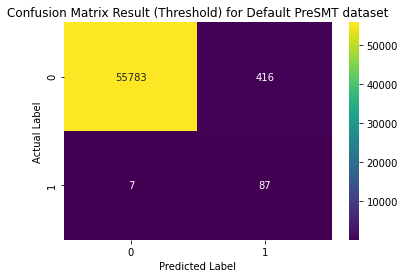

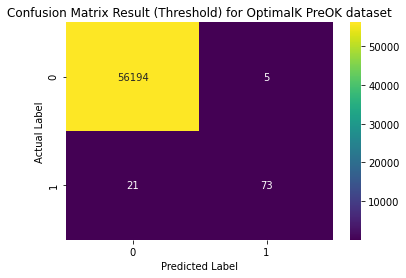

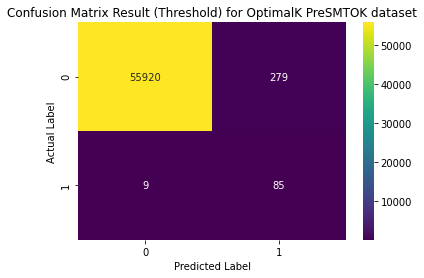

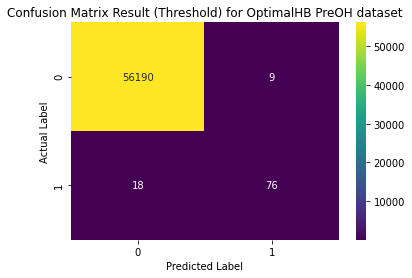

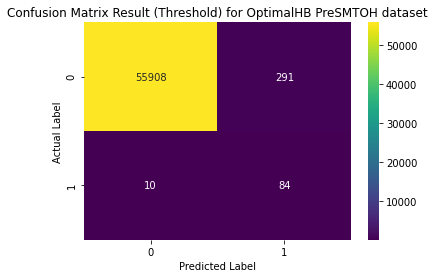

In [131]:
M1 = [MODELS[0]]
plot_AUC(M1,X_pre_test,Y_pre_test)
M2 = [MODELS[3]]
plot_AUC(M2,X_pre_test,Y_pre_test)
M3 = [MODELS[4]]
plot_AUC(M3,X_pre_test,Y_pre_test)
M4 = [MODELS[5]]
plot_AUC(M4,X_pre_test,Y_pre_test)
M5 = [MODELS2[0]]
plot_AUC(M5,X_pre_test,Y_pre_test)
M6 = [MODELS2[1]]
plot_AUC(M6,X_pre_test,Y_pre_test)

# EXTRAS

In [112]:
%tensorboard --logdir logs # Get the model visual form

Output hidden; open in https://colab.research.google.com to view.